- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=0

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=0


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 64  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric_augmented"
)
print(datestring)

cifar10_1.0_1024_64____2020_08_06_15_39_53_929135__learned-metric_augmented


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [10]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [11]:
batch_size = 256

In [12]:
img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
    rotation_range=10,       # random rotation degrees
    width_shift_range=0.1,   # random shift 10%
    height_shift_range=0.1,
    horizontal_flip=True,
    brightness_range = (0.5, 1.5),
    ##rescale = 0.1,
    zoom_range = 0.2,
    rescale=1./255,  
    #shear_range = 6,
    ##zca_whitening = True,
)

In [13]:
labeled_batch_size = 128
labeled_iter = tf.data.Dataset.from_generator(
    lambda: img_data_gen.flow(X_labeled, y=Y_labeled, batch_size=labeled_batch_size),
    (tf.float32, tf.int32),
).prefetch(10)#.batch(10)

In [14]:
X, y = next(iter(labeled_iter))

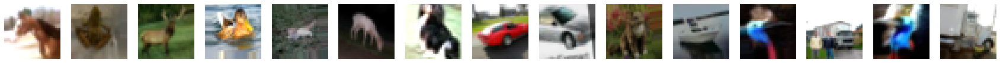

In [15]:
# view augmentations
nex = 15
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [20]:
from umap import UMAP

In [21]:
from tfumap.paths import MODEL_DIR

In [22]:
load_loc = "cifar10_0.0_1024_64____2020_08_01_08_39_45_034762_augmented"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [23]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [24]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [25]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [26]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.3984


In [27]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 15:40:04 2020 Finding Nearest Neighbors
Thu Aug  6 15:40:04 2020 Building RP forest with 10 trees
Thu Aug  6 15:40:05 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 15:40:14 2020 Finished Nearest Neighbor Search
Thu Aug  6 15:40:16 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 15:40:40 2020 Finished embedding


In [28]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 15:40:40 2020 Finding Nearest Neighbors
Thu Aug  6 15:40:40 2020 Building RP forest with 10 trees
Thu Aug  6 15:40:40 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 15:40:41 2020 Finished Nearest Neighbor Search
Thu Aug  6 15:40:41 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 15:40:55 2020 Finished embedding


In [29]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

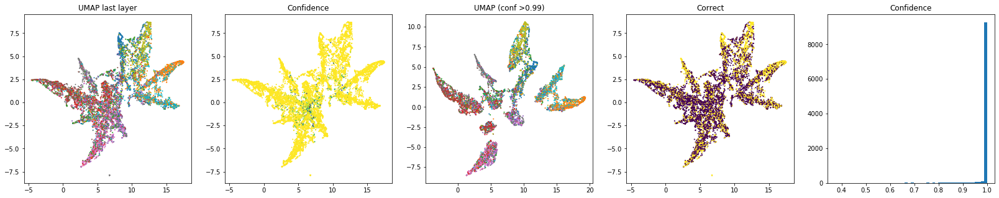

In [30]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [31]:
len(z_pred[Y_valid])

10000

In [32]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

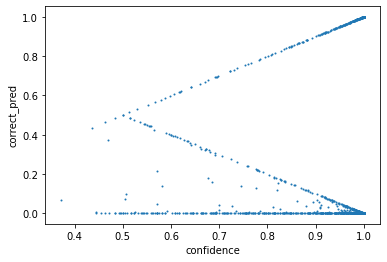

In [33]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [34]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [35]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [36]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [37]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [38]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


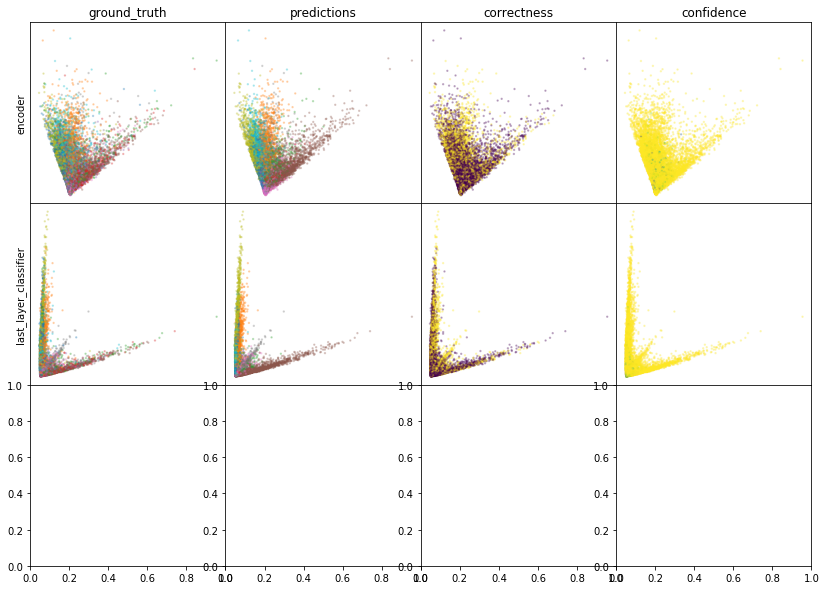

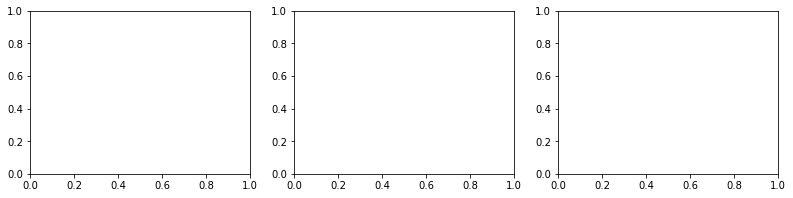

In [39]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [40]:
for i in tqdm(range(100)):
    test = next(img_data_gen.flow(X_labeled[:128], batch_size=128, shuffle=False))

In [41]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

    def augmentation_generator():  # edges_to, edges_from, batch_size
        """
        https://github.com/keras-team/keras/issues/5834
        """
        
        img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
            rotation_range=10,       # random rotation degrees
            width_shift_range=0.1,   # random shift 10%
            height_shift_range=0.1,
            horizontal_flip=True,
            brightness_range = (0.5, 1.5),
            ##rescale = 0.1,
            zoom_range = 0.2,
            rescale=1./255,  
            #shear_range = 6,
            ##zca_whitening = True,
        )
        
        n_batches = int(len(edges_from_exp) / batch_size)
        to_batches = np.reshape(
            edges_to_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        from_batches = np.reshape(
            edges_from_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        for batch_to, batch_from in zip(to_batches, from_batches):
            # yield X_train[batch_to], X_train[batch_from]
            yield (
                next(
                    img_data_gen.flow(
                        X_train[batch_to], batch_size=batch_size, shuffle=False
                    )
                ),
                next(
                    img_data_gen.flow(
                        X_train[batch_from], batch_size=batch_size, shuffle=False
                    )
                ),
            )

    nthreads = 10
    edge_iter = tf.data.Dataset.from_tensor_slices(
        ["Gen_" + str(i) for i in range(nthreads)]
    )
    edge_iter = ds.interleave(
        lambda x: tf.data.Dataset.from_generator(
            augmentation_generator, (tf.float32, tf.float32)
        ),
        cycle_length=nthreads,
        block_length=1,
        num_parallel_calls=nthreads,
    )

    return edge_iter, len(edges_to_exp)

In [42]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

        
    edge_iter = (
        tf.data.Dataset.from_tensor_slices((edges_to_exp, edges_from_exp))
    ).batch(batch_size).prefetch(5)
    
    return edge_iter, len(edges_to_exp)

In [43]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [44]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [45]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [46]:
from tfumap.paths import MODEL_DIR

In [47]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [48]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [49]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [54]:
repeat_augment_tolerance = 25 # augmentations are allowed to be repeated up until this many times 
# we could also have a bank of sampleable augmentations per exemplar

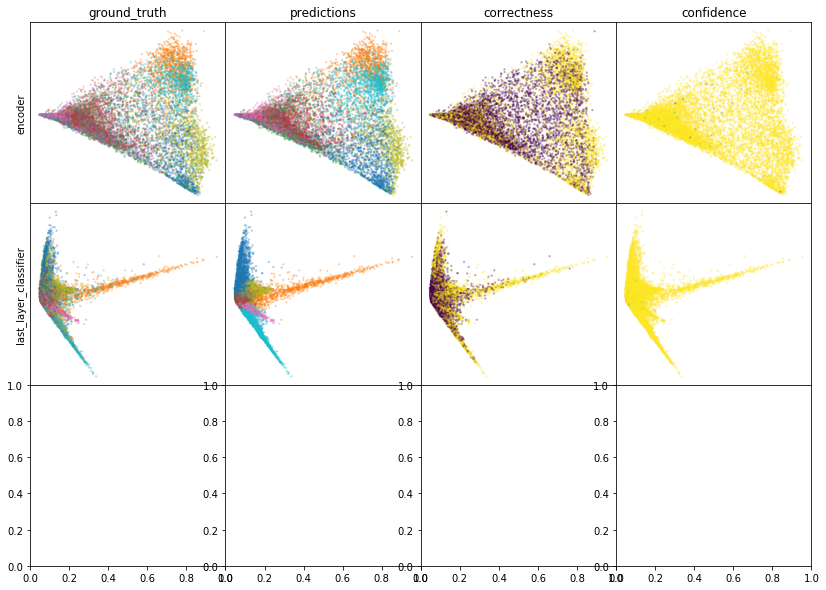

W0807 09:28:00.496704 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:28:01.337508 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:28:02.124897 140610860525376 legend.py:1282] No handles with labels found to put in legend.


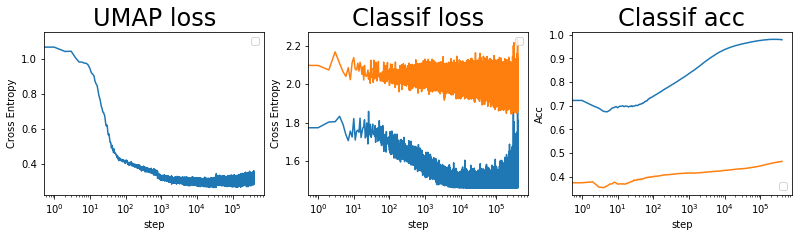

batch: 403000 | train acc: 0.9788 | val acc: 0.4654


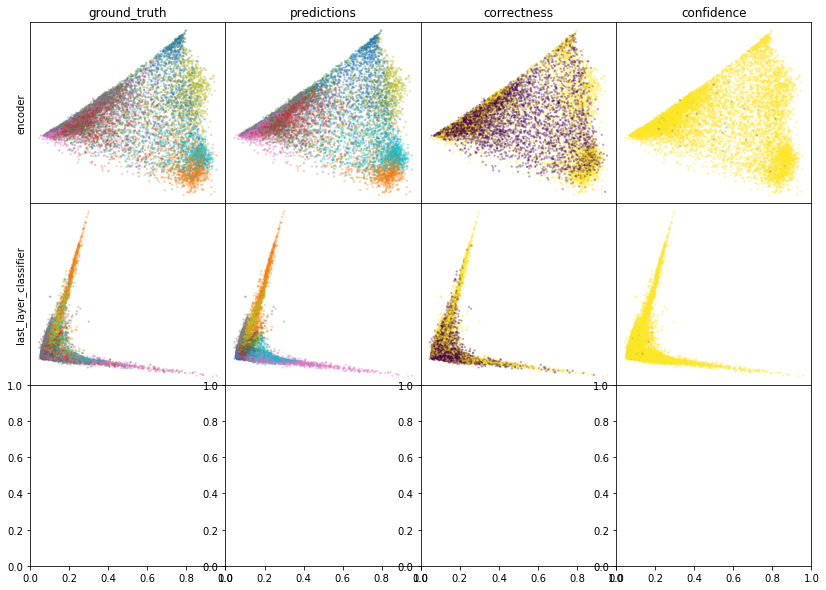

W0807 09:30:30.154870 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:30:31.063829 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:30:31.915431 140610860525376 legend.py:1282] No handles with labels found to put in legend.


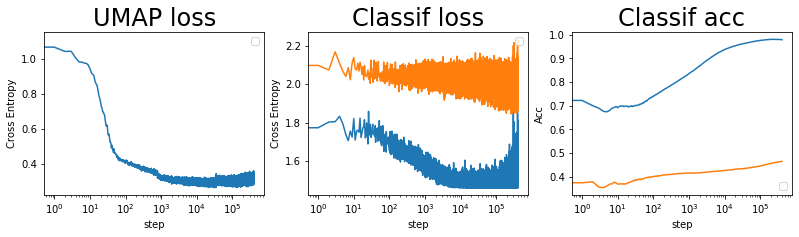

batch: 404000 | train acc: 0.9788 | val acc: 0.4654


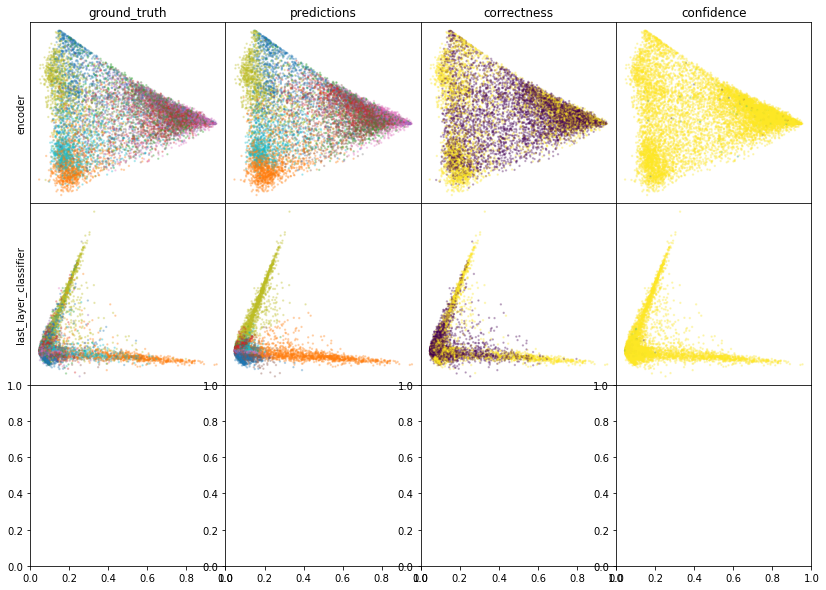

W0807 09:33:17.217904 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:33:18.107566 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:33:18.946891 140610860525376 legend.py:1282] No handles with labels found to put in legend.


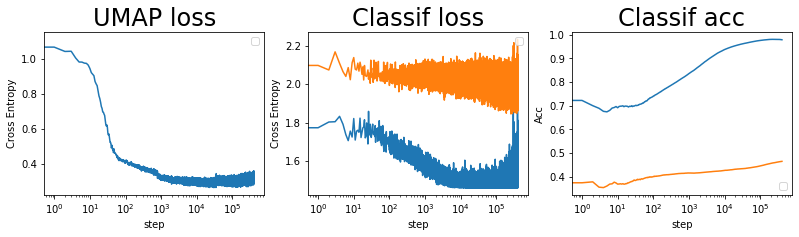

batch: 405000 | train acc: 0.9788 | val acc: 0.4654


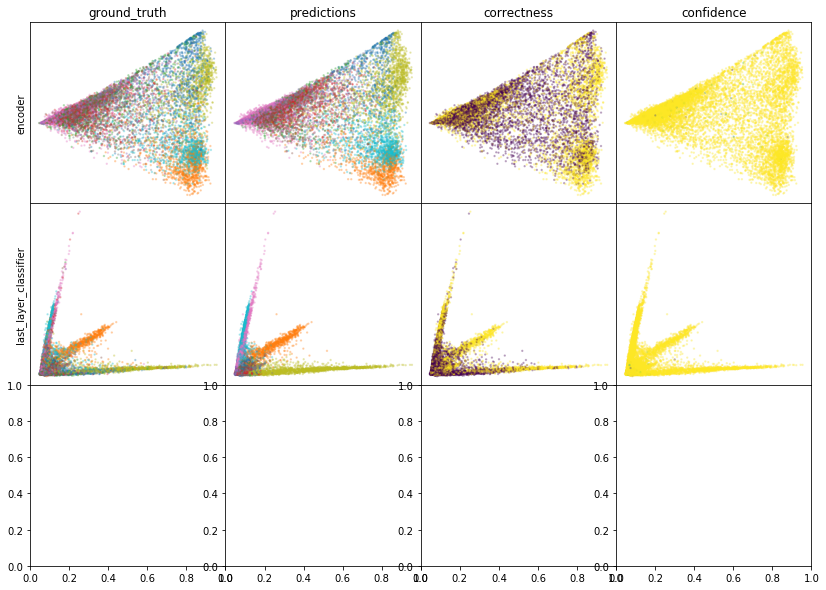

W0807 09:35:46.694528 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:35:47.589396 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:35:48.424696 140610860525376 legend.py:1282] No handles with labels found to put in legend.


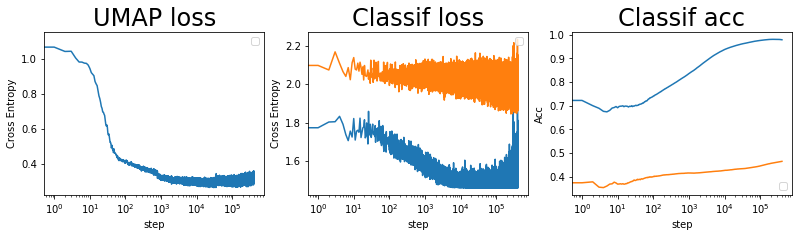

batch: 406000 | train acc: 0.9788 | val acc: 0.4654


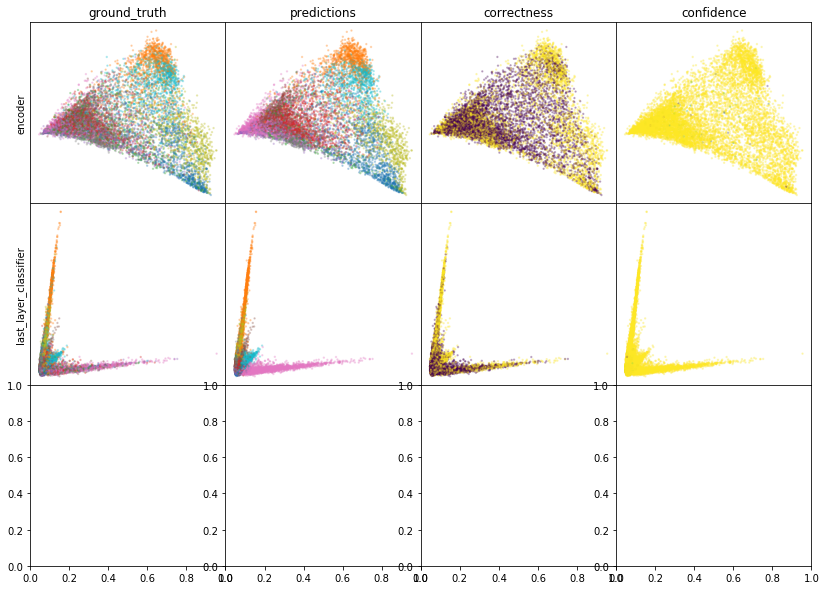

W0807 09:38:35.479362 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:38:36.384714 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:38:37.235507 140610860525376 legend.py:1282] No handles with labels found to put in legend.


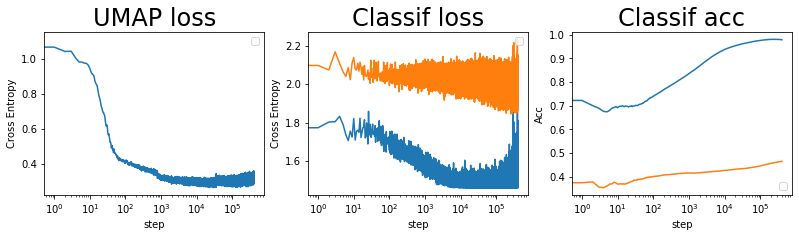

batch: 407000 | train acc: 0.9788 | val acc: 0.4655


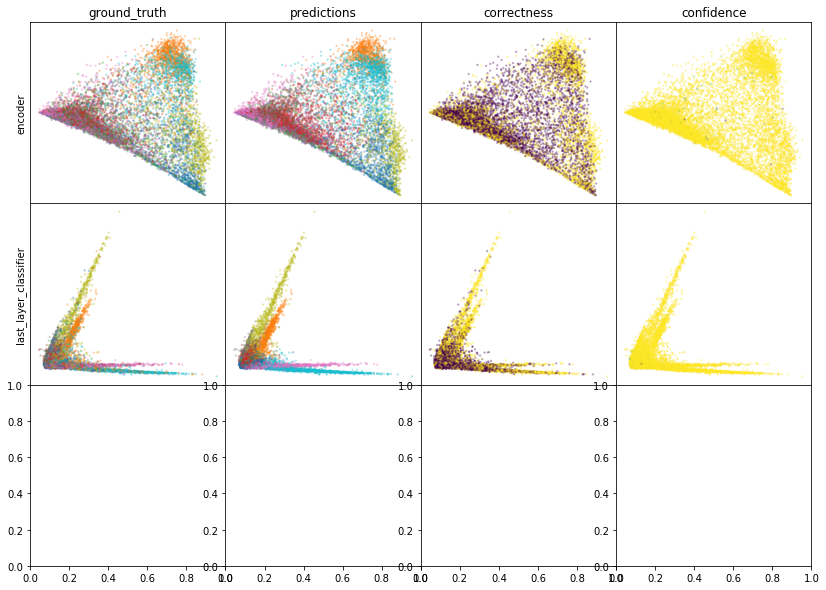

W0807 09:41:04.695010 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:41:05.597949 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:41:06.441001 140610860525376 legend.py:1282] No handles with labels found to put in legend.


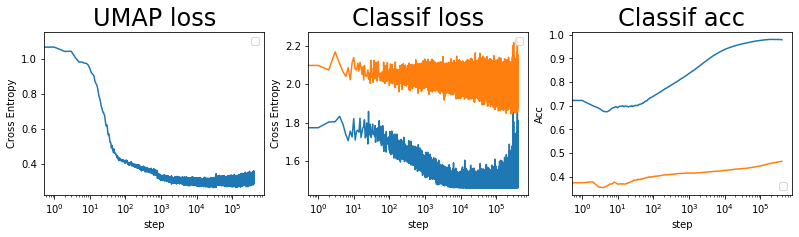

batch: 408000 | train acc: 0.9788 | val acc: 0.4655


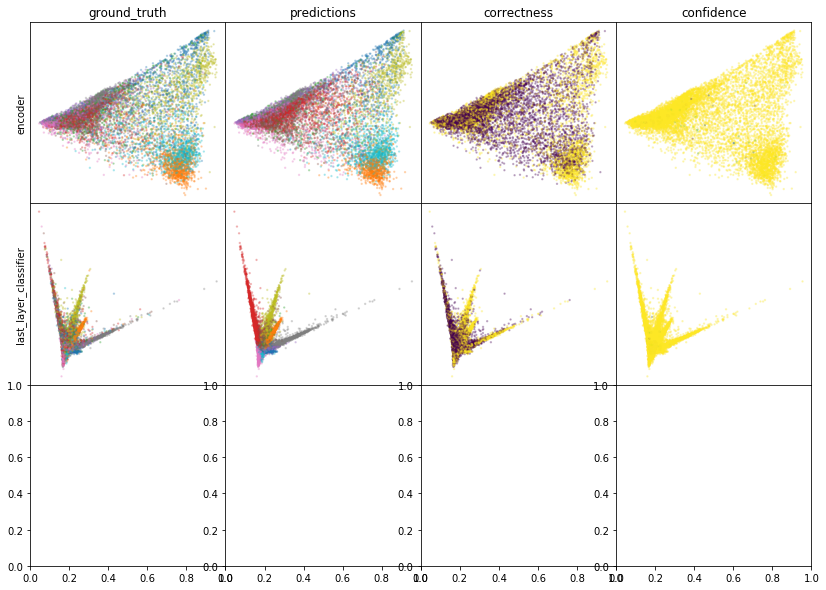

W0807 09:43:53.449779 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:43:54.356497 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:43:55.204832 140610860525376 legend.py:1282] No handles with labels found to put in legend.


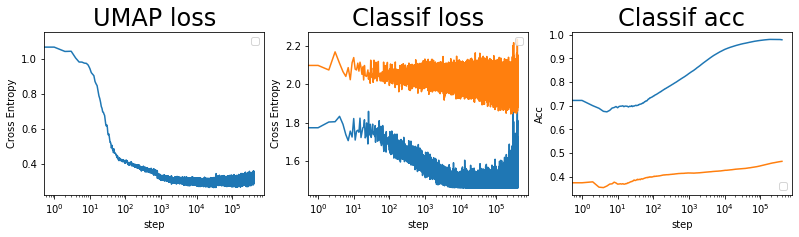

batch: 409000 | train acc: 0.9787 | val acc: 0.4655


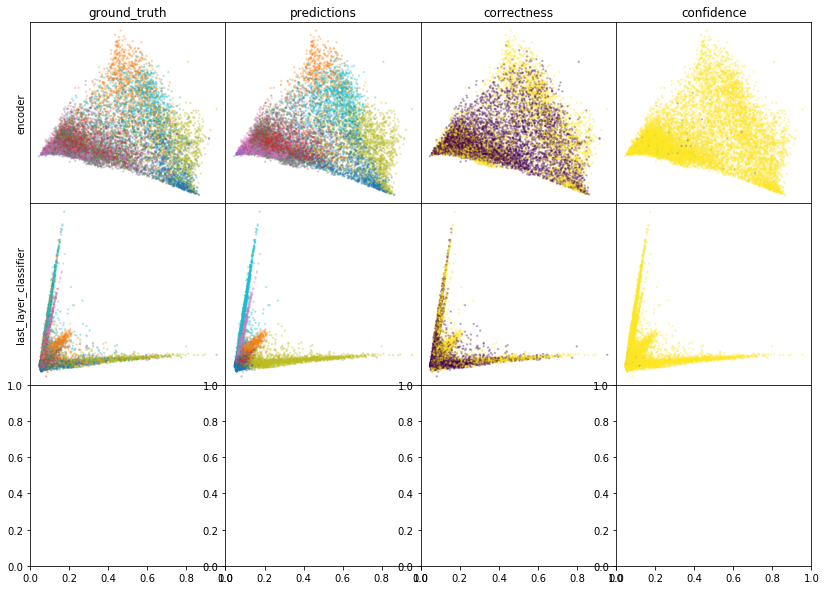

W0807 09:46:22.817896 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:46:23.725397 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:46:24.570914 140610860525376 legend.py:1282] No handles with labels found to put in legend.


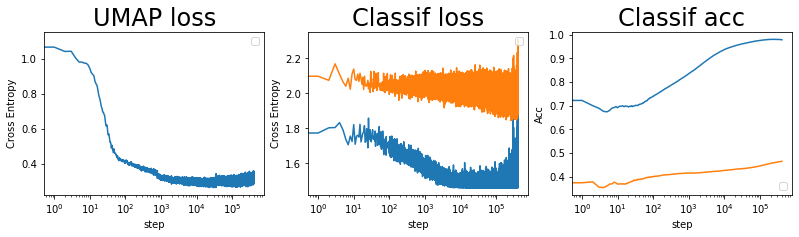

batch: 410000 | train acc: 0.9787 | val acc: 0.4655


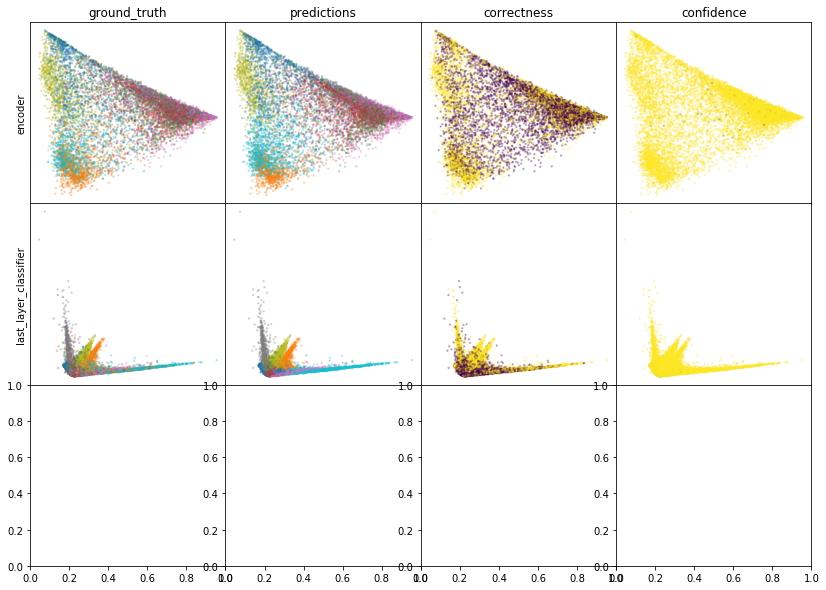

W0807 09:49:12.100903 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:49:13.006808 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:49:13.851259 140610860525376 legend.py:1282] No handles with labels found to put in legend.


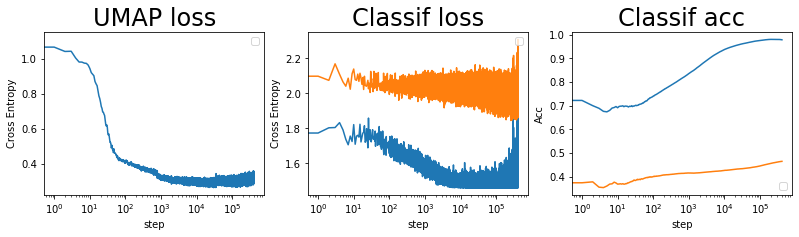

batch: 411000 | train acc: 0.9786 | val acc: 0.4655


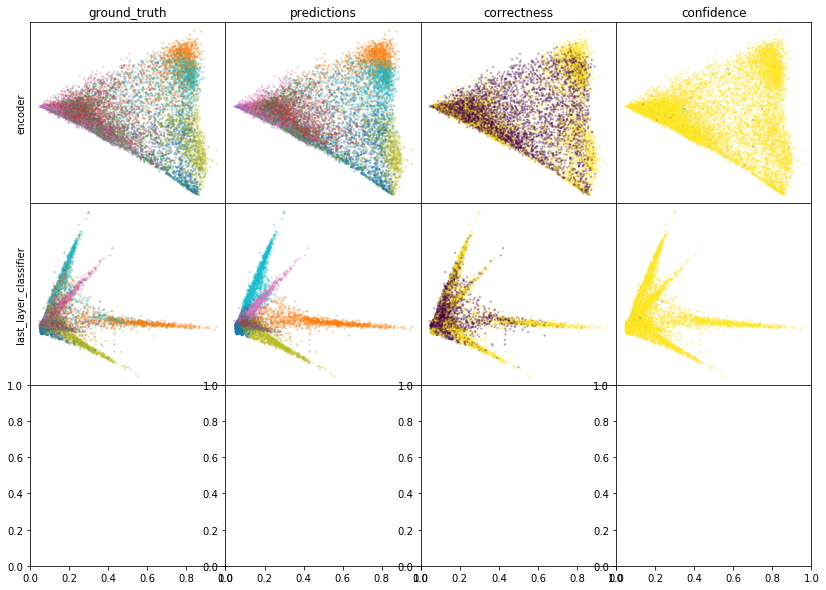

W0807 09:51:41.840290 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:51:42.740521 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:51:43.589284 140610860525376 legend.py:1282] No handles with labels found to put in legend.


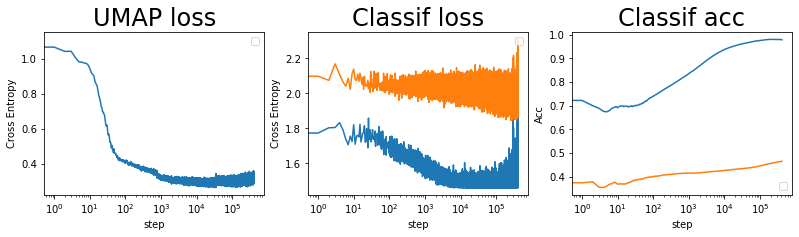

batch: 412000 | train acc: 0.9786 | val acc: 0.4655


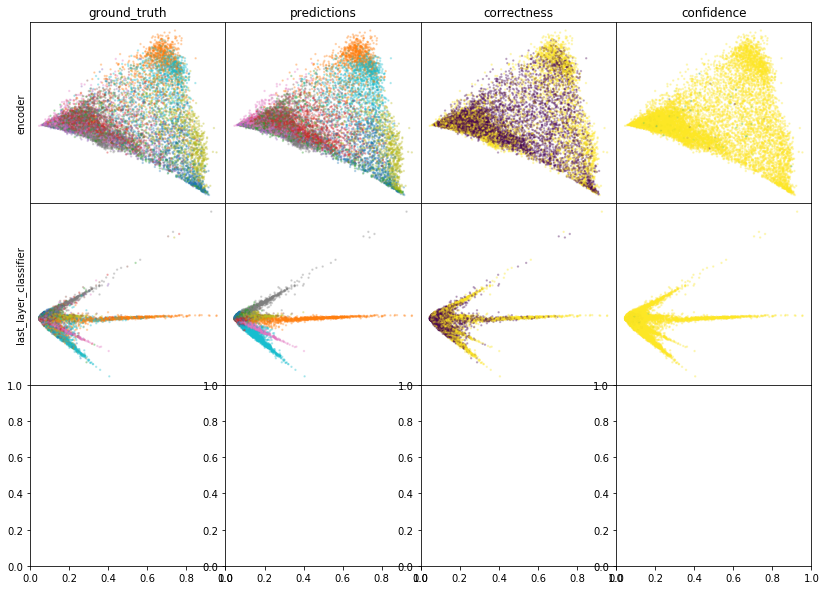

W0807 09:54:31.900655 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:54:32.813888 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:54:33.680075 140610860525376 legend.py:1282] No handles with labels found to put in legend.


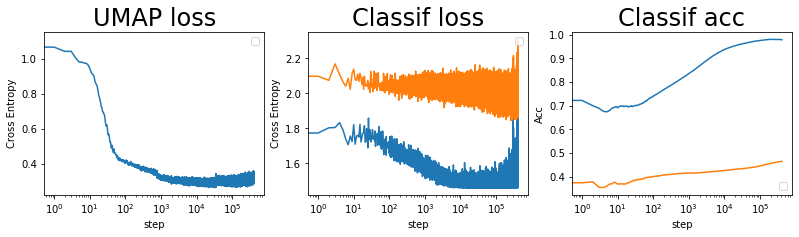

batch: 413000 | train acc: 0.9786 | val acc: 0.4655
leaving epoch because no improvement in 10000 batches


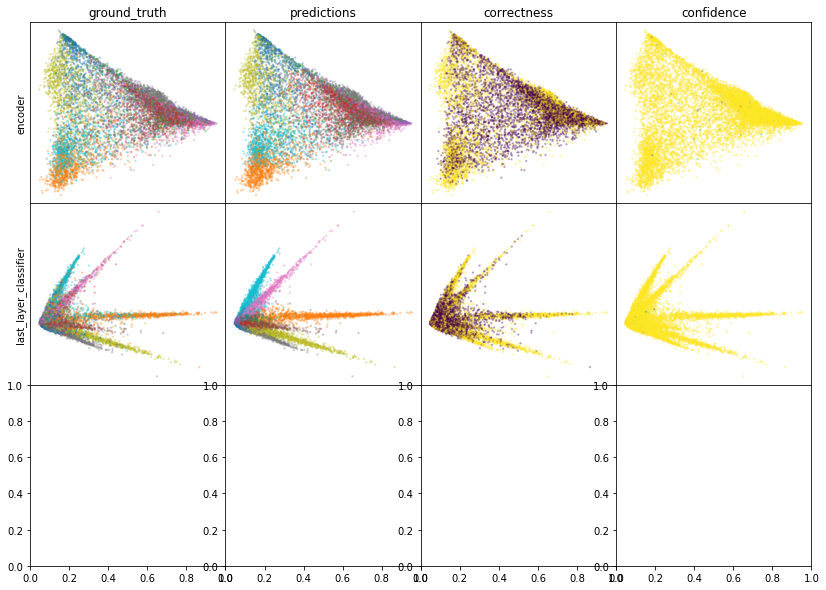

W0807 09:57:31.846064 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:57:32.764379 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 09:57:33.626724 140610860525376 legend.py:1282] No handles with labels found to put in legend.


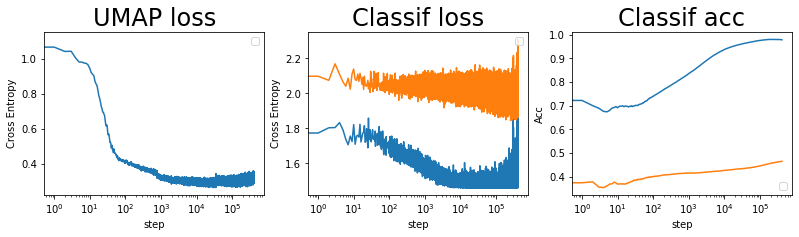

batch: 414000 | train acc: 0.9786 | val acc: 0.4654


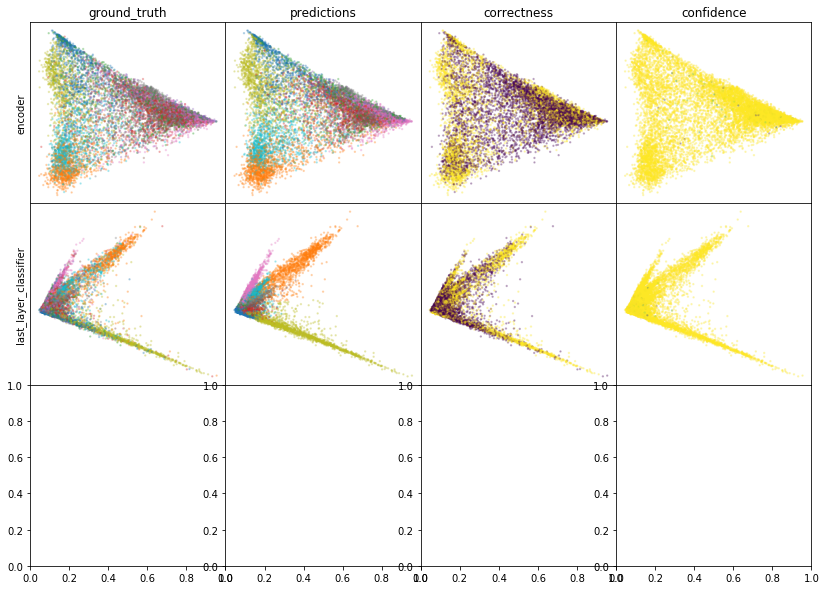

W0807 10:00:02.844810 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:00:03.753463 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:00:04.605772 140610860525376 legend.py:1282] No handles with labels found to put in legend.


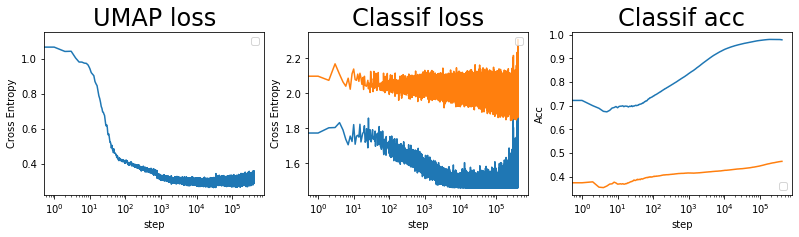

batch: 415000 | train acc: 0.9785 | val acc: 0.4654


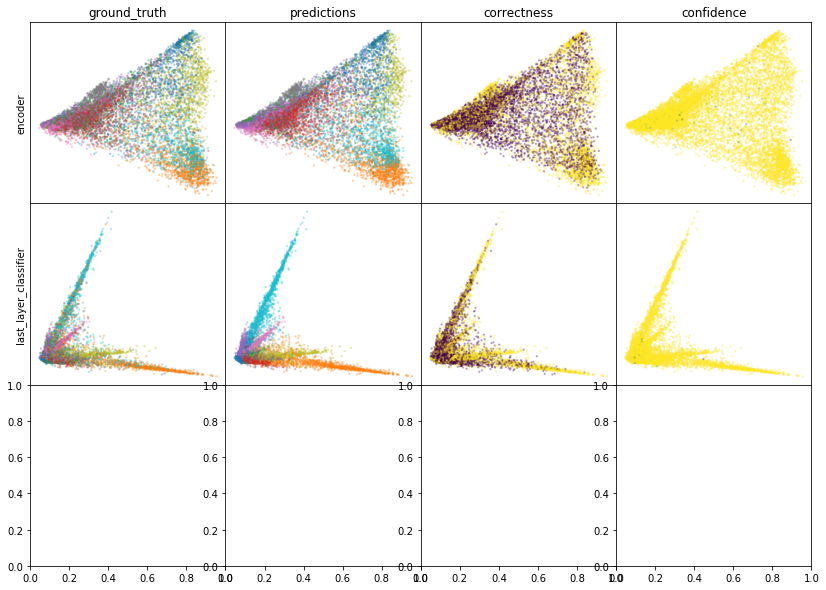

W0807 10:02:53.156608 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:02:54.083142 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:02:54.960033 140610860525376 legend.py:1282] No handles with labels found to put in legend.


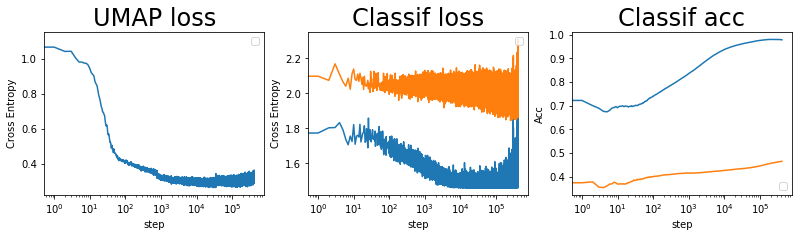

batch: 416000 | train acc: 0.9785 | val acc: 0.4654


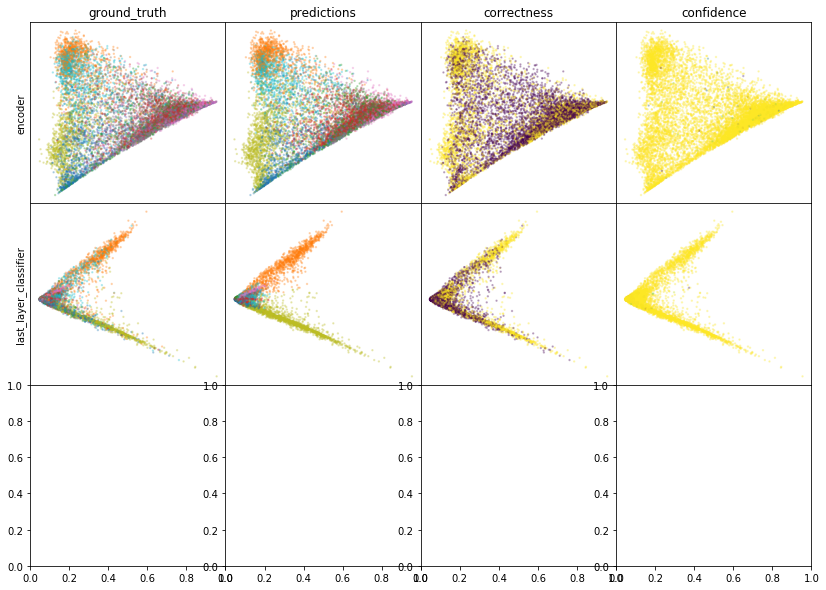

W0807 10:05:25.556945 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:05:26.464092 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:05:27.320116 140610860525376 legend.py:1282] No handles with labels found to put in legend.


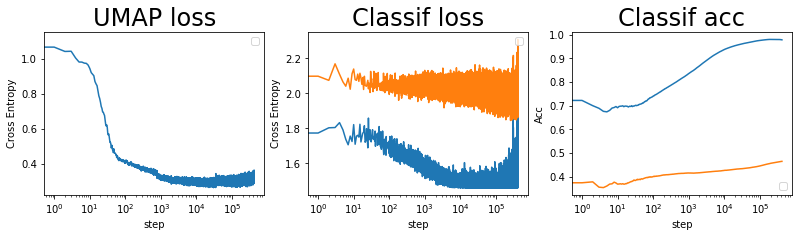

batch: 417000 | train acc: 0.9785 | val acc: 0.4654


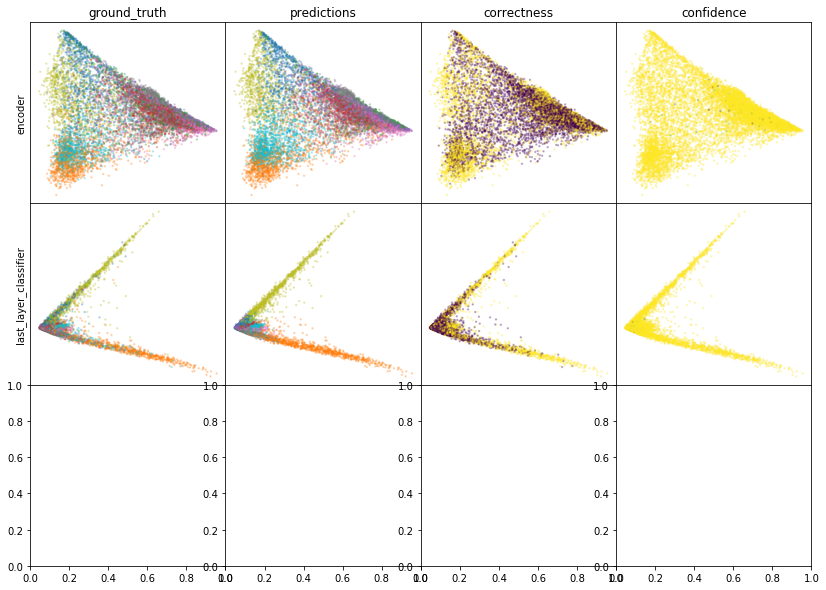

W0807 10:08:15.271746 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:08:16.192134 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:08:17.063631 140610860525376 legend.py:1282] No handles with labels found to put in legend.


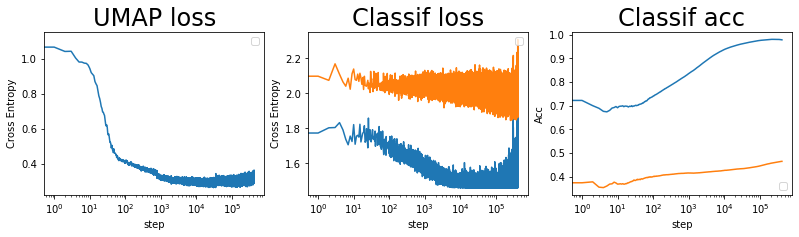

batch: 418000 | train acc: 0.9784 | val acc: 0.4654


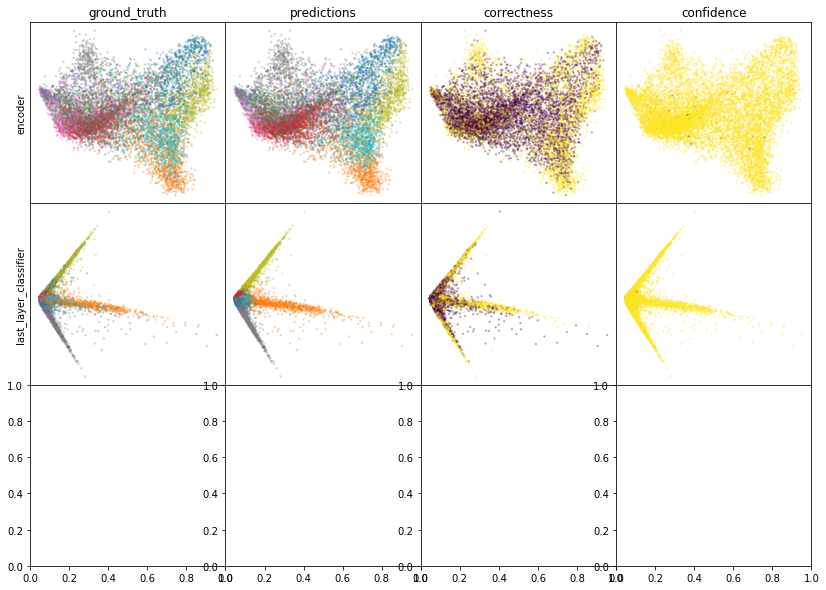

W0807 10:11:06.654640 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:11:07.565886 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:11:08.424361 140610860525376 legend.py:1282] No handles with labels found to put in legend.


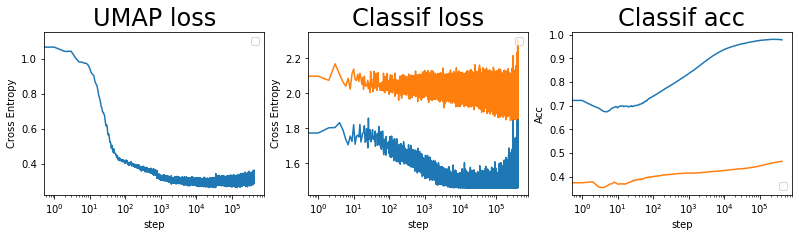

batch: 419000 | train acc: 0.9784 | val acc: 0.4655


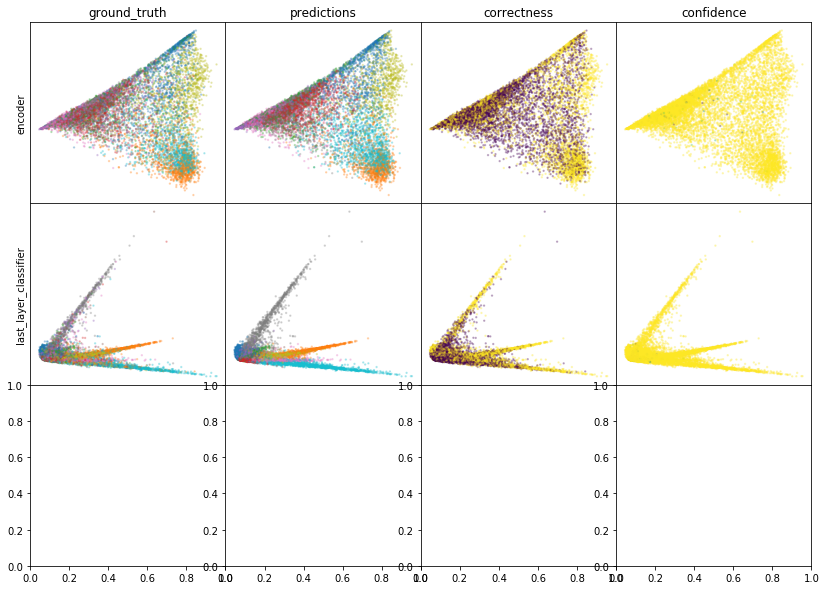

W0807 10:13:38.382306 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:13:39.296924 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:13:40.157993 140610860525376 legend.py:1282] No handles with labels found to put in legend.


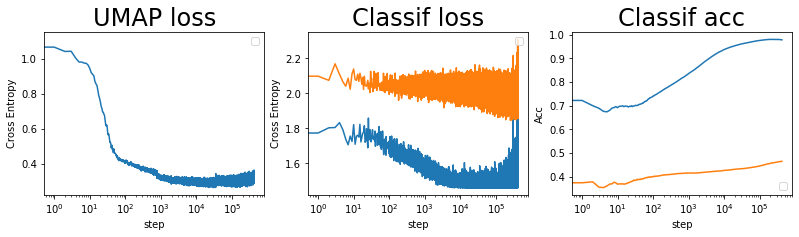

batch: 420000 | train acc: 0.9784 | val acc: 0.4655


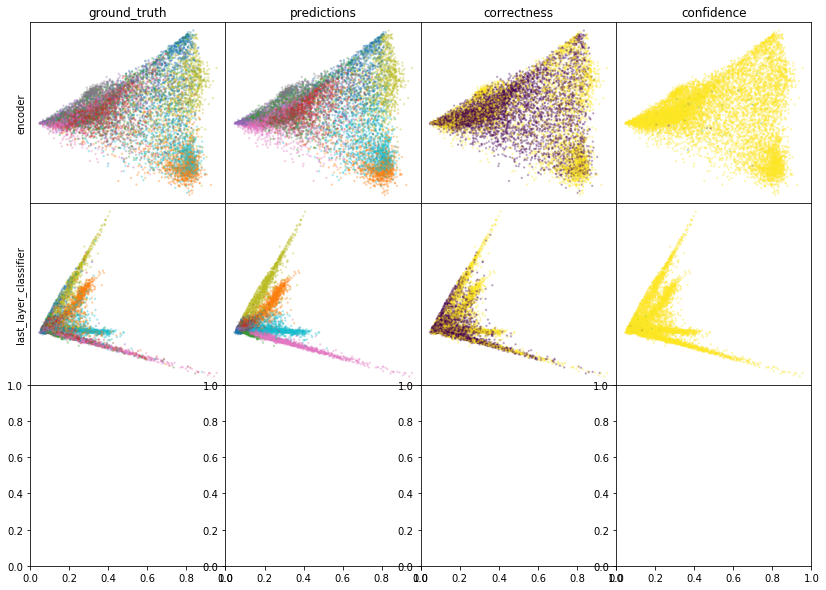

W0807 10:16:29.337117 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:16:30.253007 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:16:31.117771 140610860525376 legend.py:1282] No handles with labels found to put in legend.


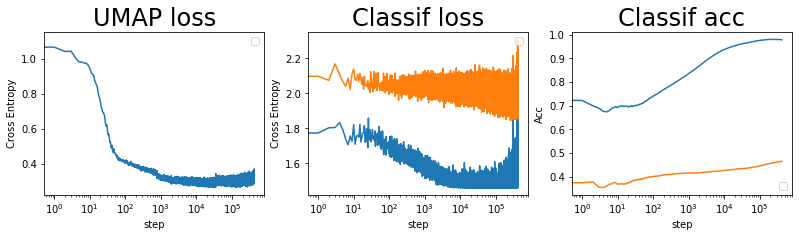

batch: 421000 | train acc: 0.9783 | val acc: 0.4655


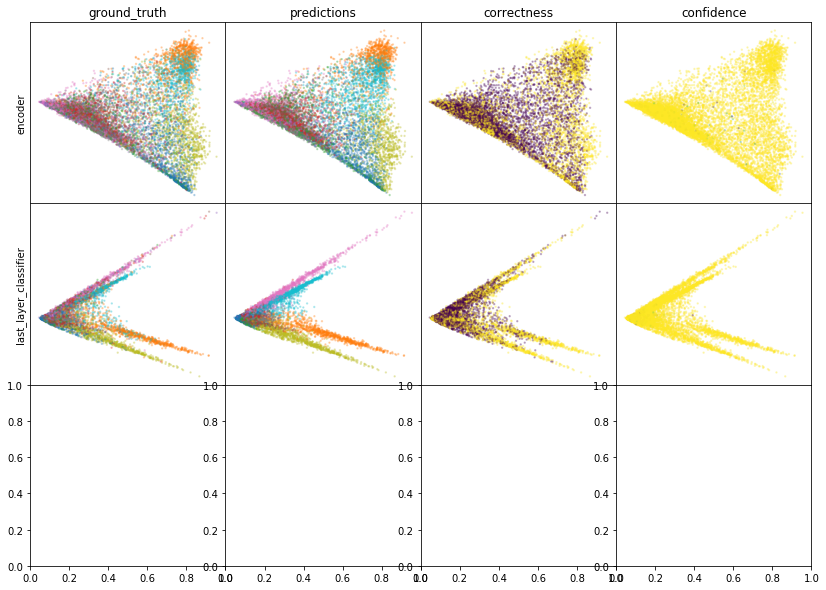

W0807 10:19:07.319739 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:19:08.417104 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:19:09.567477 140610860525376 legend.py:1282] No handles with labels found to put in legend.


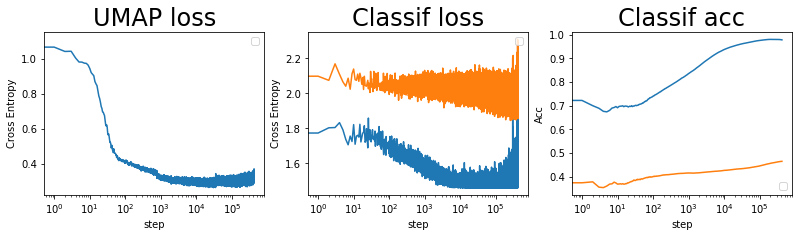

batch: 422000 | train acc: 0.9783 | val acc: 0.4655


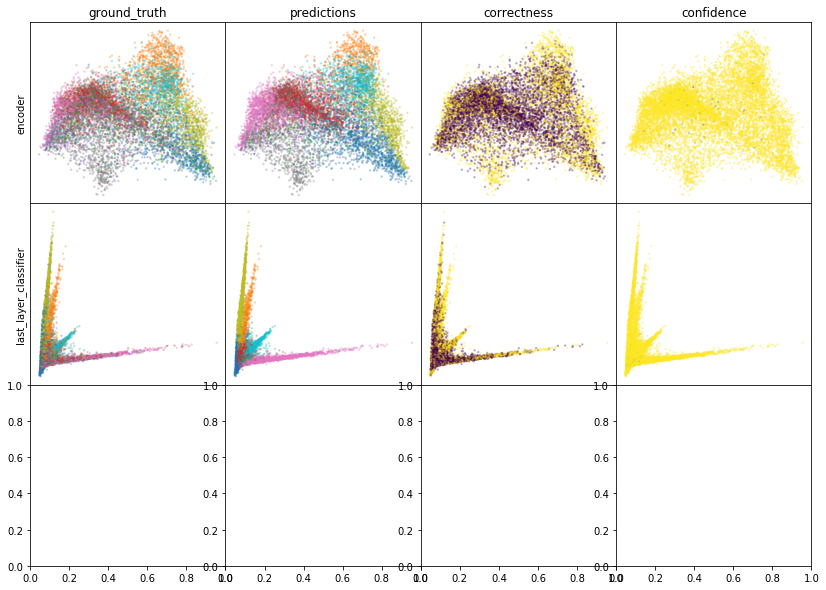

W0807 10:21:59.045137 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:21:59.974462 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:22:00.844295 140610860525376 legend.py:1282] No handles with labels found to put in legend.


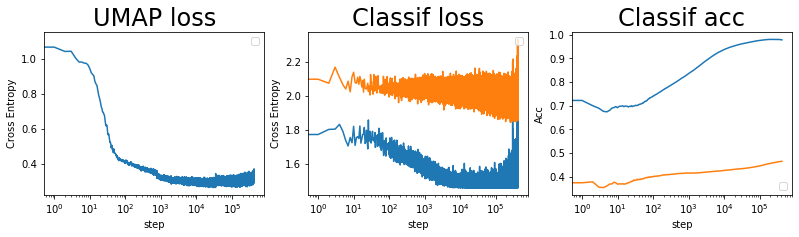

batch: 423000 | train acc: 0.9783 | val acc: 0.4655
leaving epoch because no improvement in 10000 batches


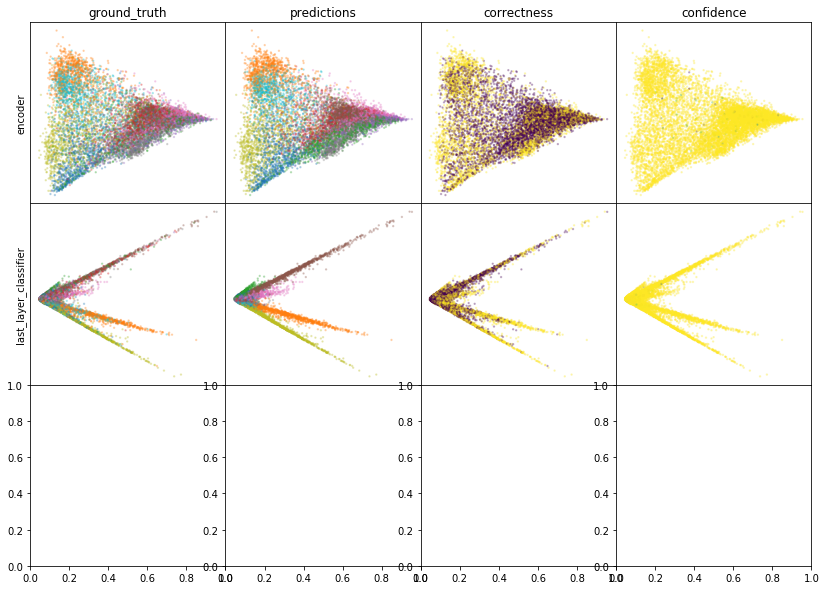

W0807 10:25:02.719687 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:25:03.651943 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:25:04.530771 140610860525376 legend.py:1282] No handles with labels found to put in legend.


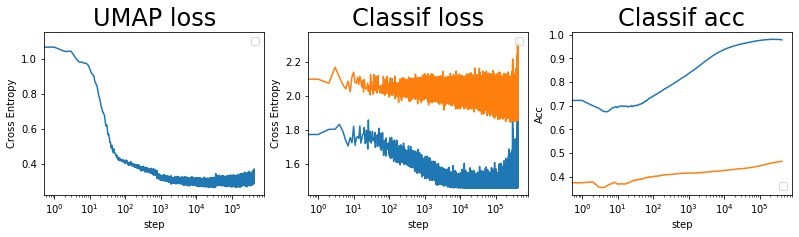

batch: 424000 | train acc: 0.9782 | val acc: 0.4655


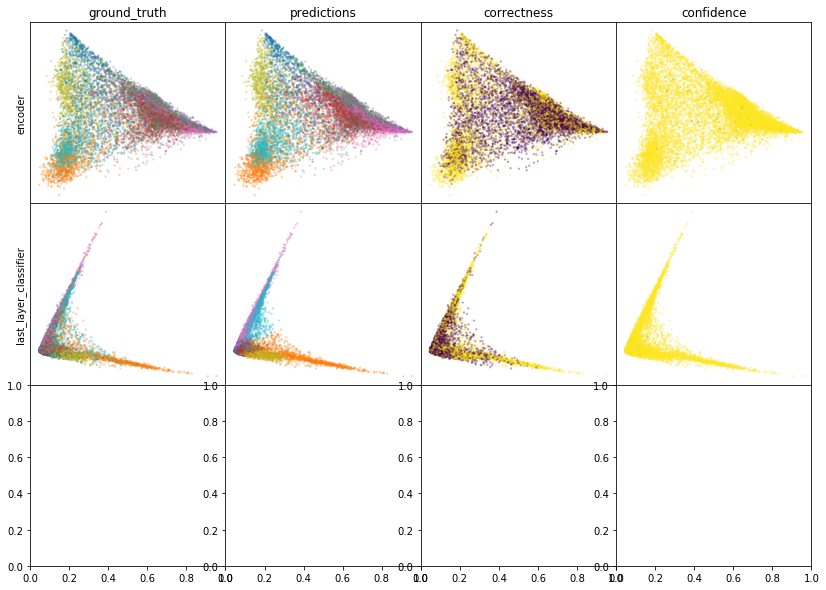

W0807 10:27:34.216895 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:27:35.140120 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:27:36.011775 140610860525376 legend.py:1282] No handles with labels found to put in legend.


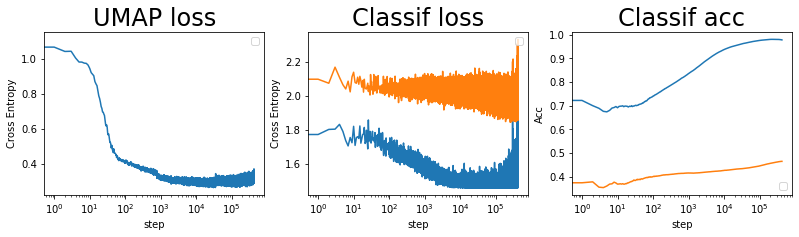

batch: 425000 | train acc: 0.9781 | val acc: 0.4655


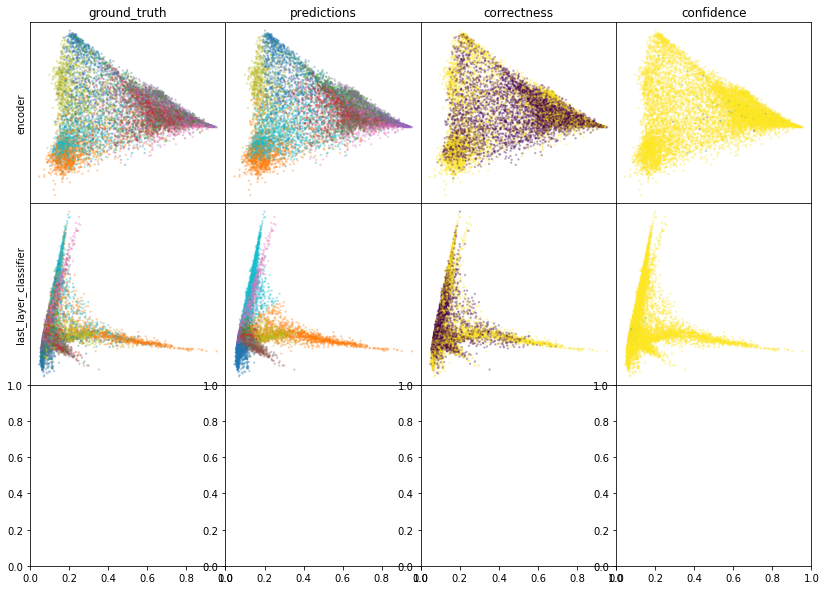

W0807 10:30:22.490622 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:30:23.425187 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:30:24.304475 140610860525376 legend.py:1282] No handles with labels found to put in legend.


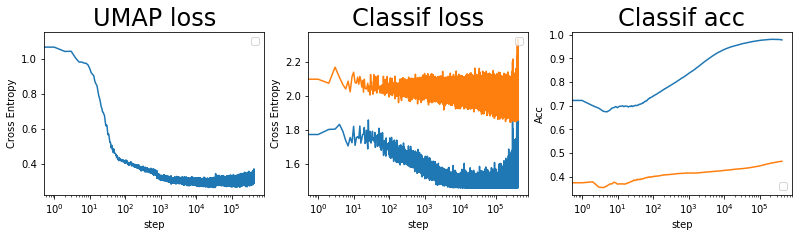

batch: 426000 | train acc: 0.9781 | val acc: 0.4655


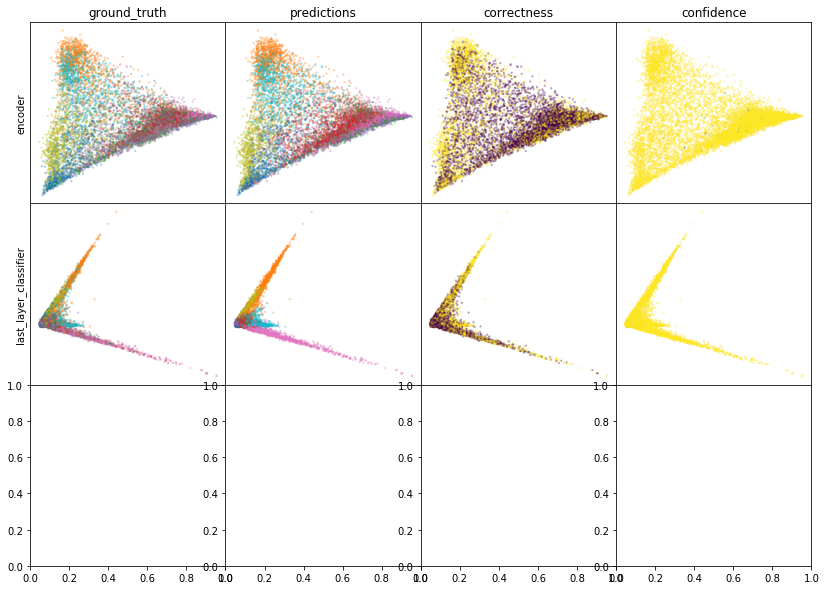

W0807 10:32:54.044609 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:32:54.980735 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:32:55.863376 140610860525376 legend.py:1282] No handles with labels found to put in legend.


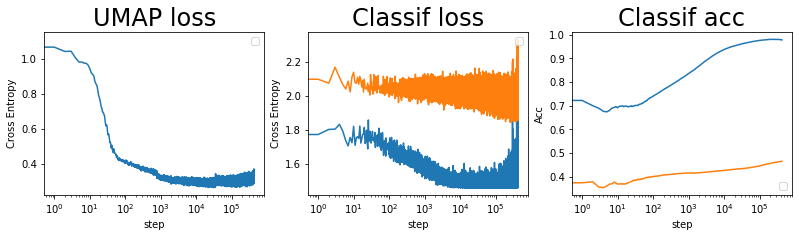

batch: 427000 | train acc: 0.978 | val acc: 0.4655


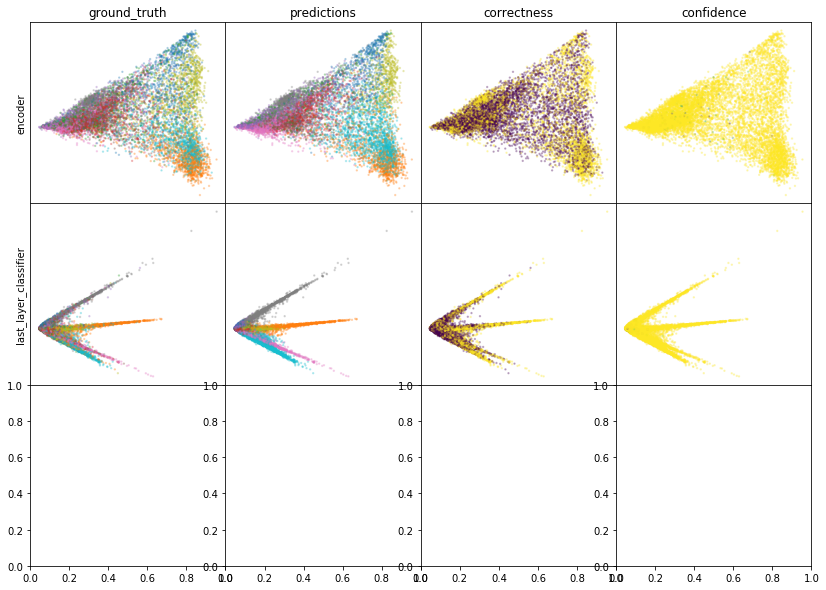

W0807 10:35:43.927845 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:35:44.859135 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:35:45.736903 140610860525376 legend.py:1282] No handles with labels found to put in legend.


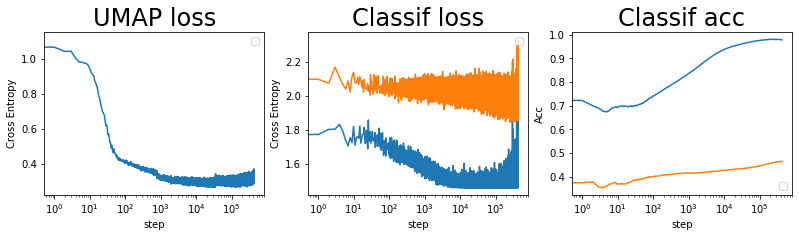

batch: 428000 | train acc: 0.978 | val acc: 0.4655


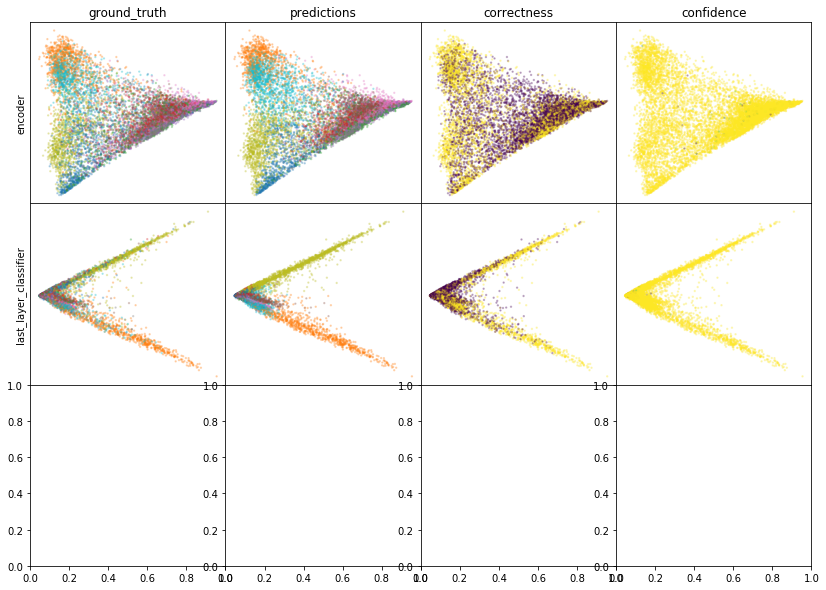

W0807 10:38:18.639818 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:38:19.586463 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:38:20.476818 140610860525376 legend.py:1282] No handles with labels found to put in legend.


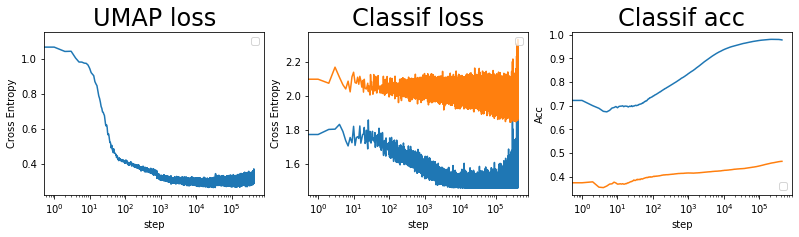

batch: 429000 | train acc: 0.978 | val acc: 0.4655


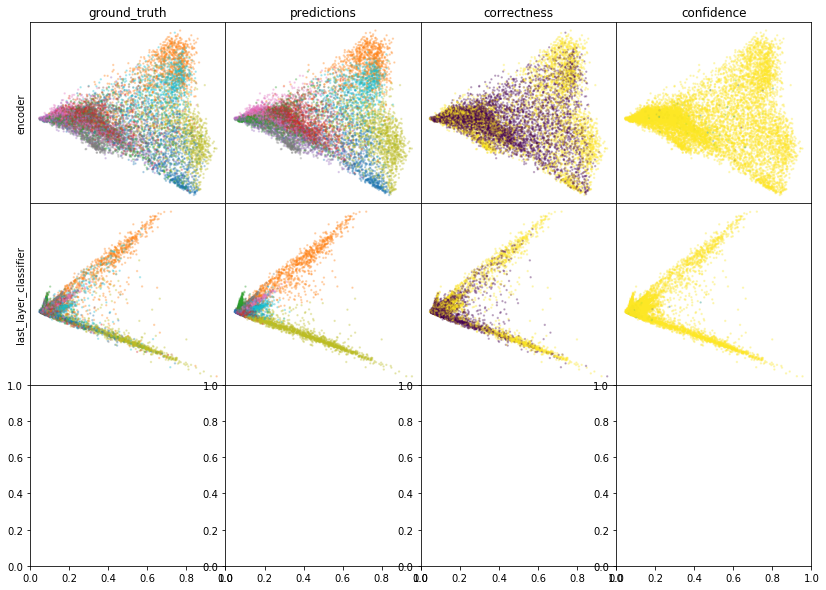

W0807 10:41:11.588131 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:41:12.526860 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:41:13.410125 140610860525376 legend.py:1282] No handles with labels found to put in legend.


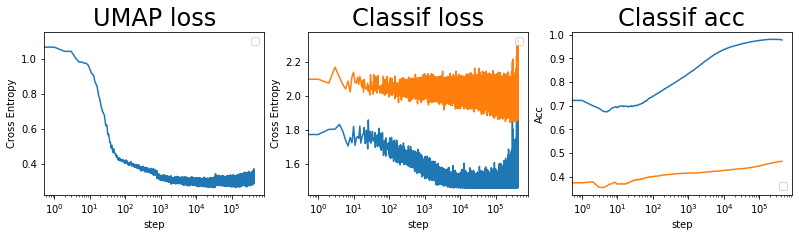

batch: 430000 | train acc: 0.978 | val acc: 0.4655


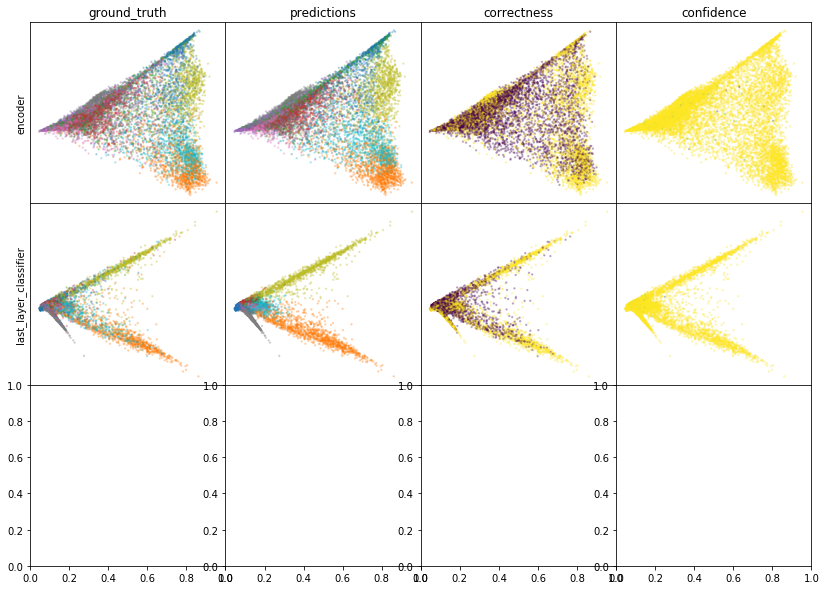

W0807 10:43:43.442274 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:43:44.375103 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:43:45.252479 140610860525376 legend.py:1282] No handles with labels found to put in legend.


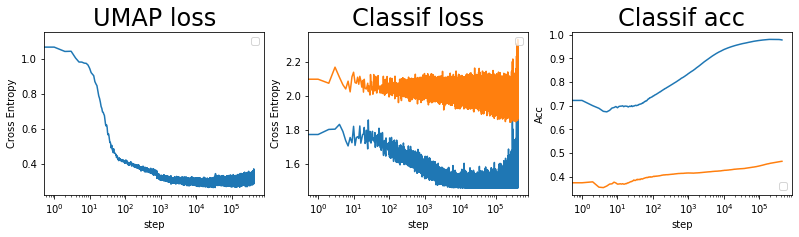

batch: 431000 | train acc: 0.978 | val acc: 0.4655


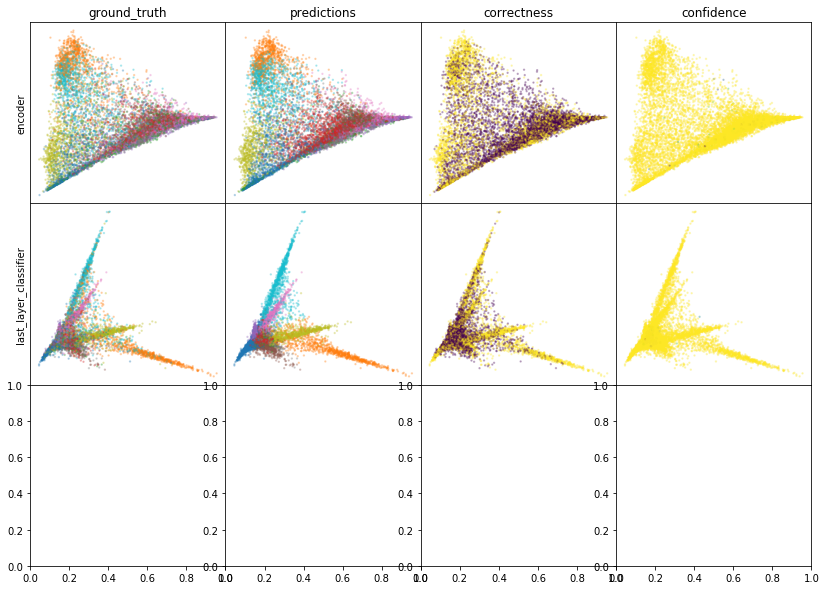

W0807 10:46:33.656708 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:46:34.600412 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:46:35.483528 140610860525376 legend.py:1282] No handles with labels found to put in legend.


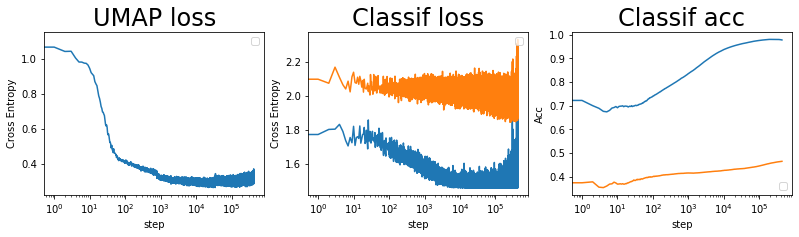

batch: 432000 | train acc: 0.9779 | val acc: 0.4656


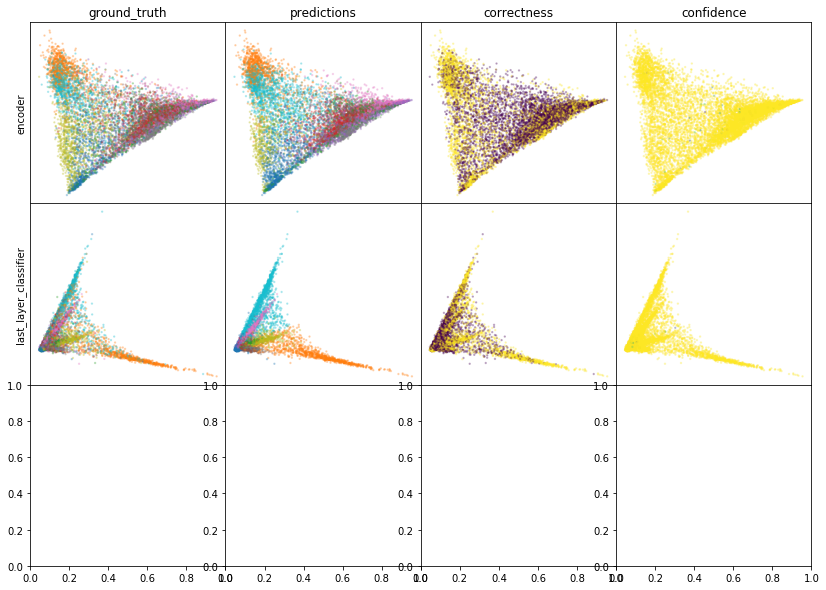

W0807 10:49:24.693304 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:49:25.642837 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:49:26.534635 140610860525376 legend.py:1282] No handles with labels found to put in legend.


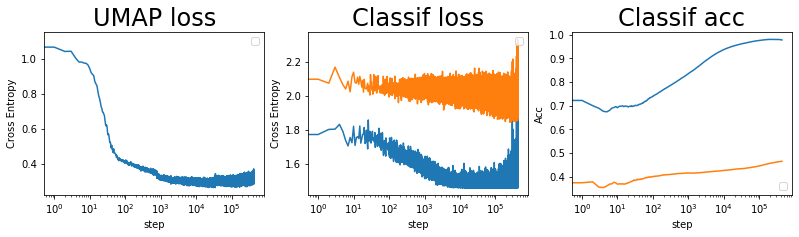

batch: 433000 | train acc: 0.9779 | val acc: 0.4656


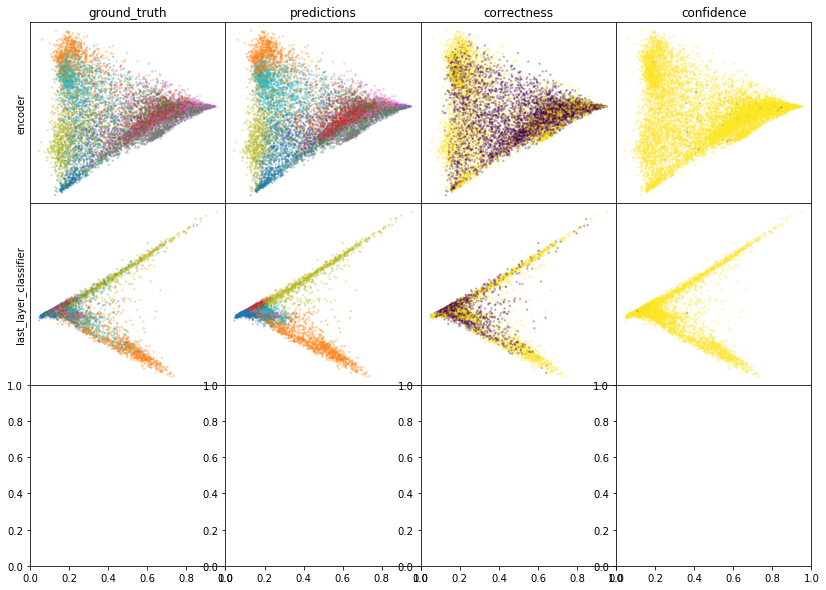

W0807 10:51:59.002225 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:51:59.943788 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:52:00.825325 140610860525376 legend.py:1282] No handles with labels found to put in legend.


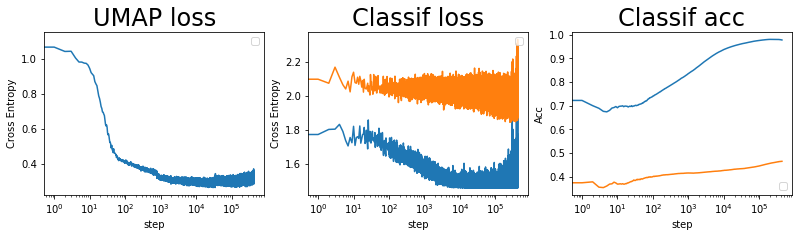

batch: 434000 | train acc: 0.9779 | val acc: 0.4656


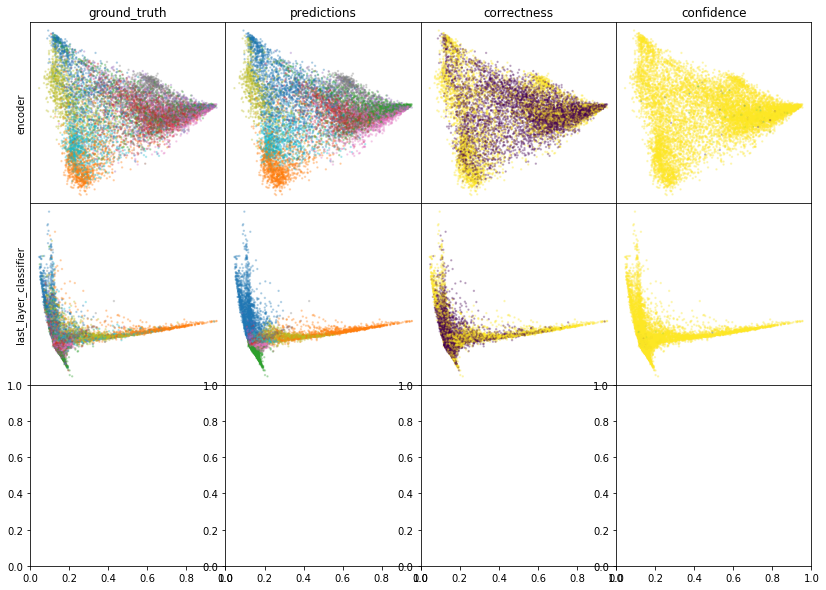

W0807 10:54:50.693918 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:54:51.652870 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:54:52.558899 140610860525376 legend.py:1282] No handles with labels found to put in legend.


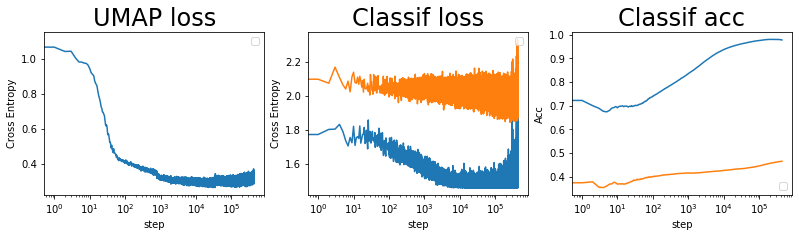

batch: 435000 | train acc: 0.9779 | val acc: 0.4656


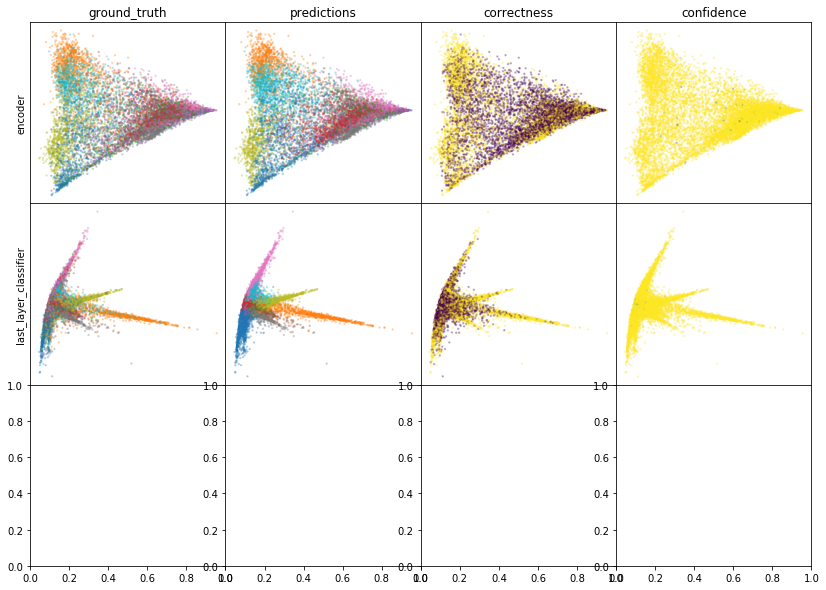

W0807 10:57:25.195229 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:57:26.149518 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 10:57:27.052412 140610860525376 legend.py:1282] No handles with labels found to put in legend.


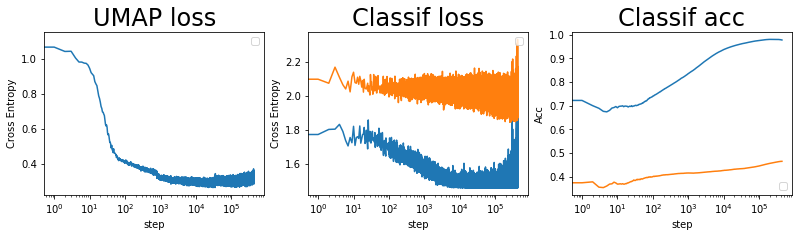

batch: 436000 | train acc: 0.9778 | val acc: 0.4656


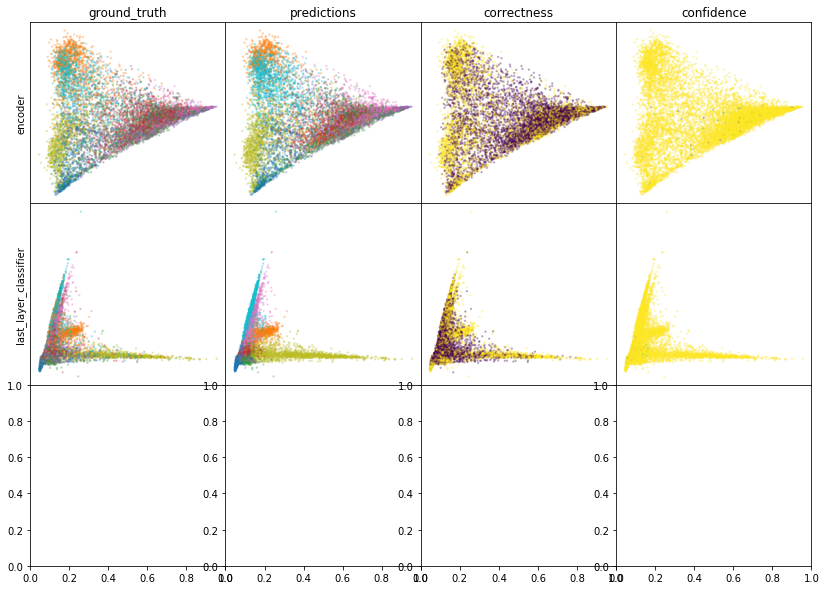

W0807 11:00:18.126423 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:00:19.087321 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:00:19.992579 140610860525376 legend.py:1282] No handles with labels found to put in legend.


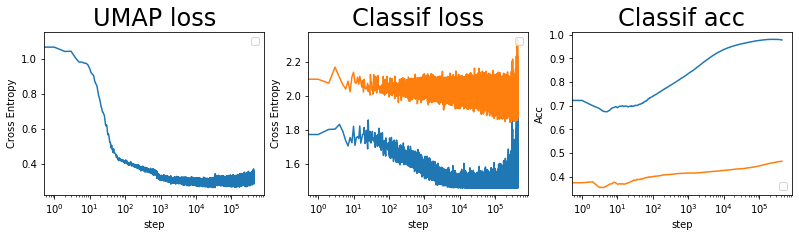

batch: 437000 | train acc: 0.9778 | val acc: 0.4656


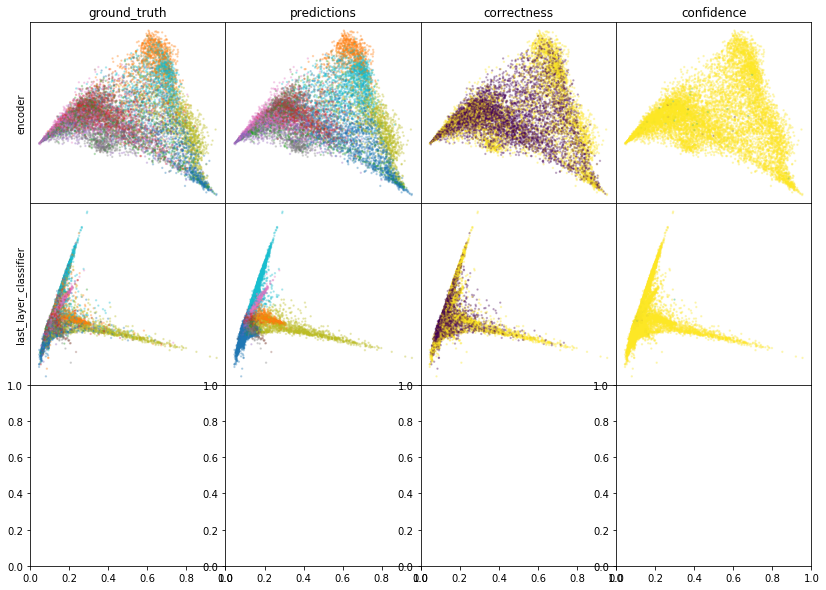

W0807 11:02:51.987087 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:02:52.939101 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:02:53.834239 140610860525376 legend.py:1282] No handles with labels found to put in legend.


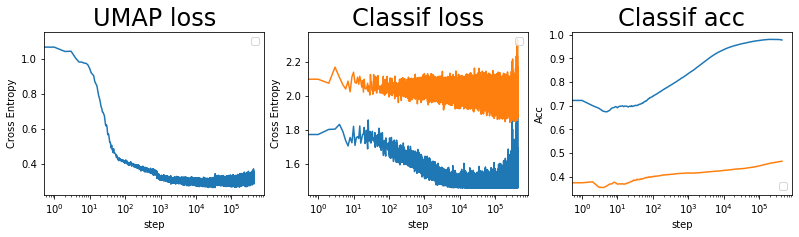

batch: 438000 | train acc: 0.9778 | val acc: 0.4656


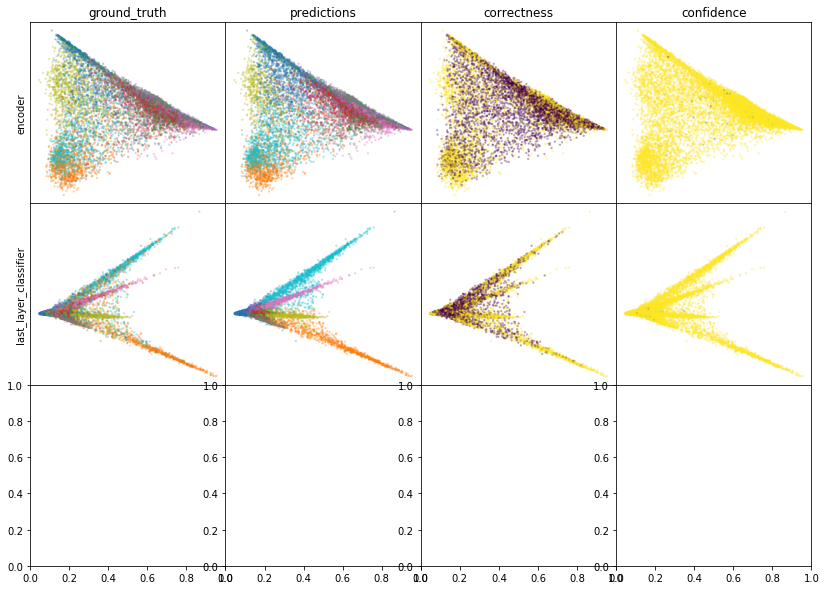

W0807 11:05:43.763711 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:05:44.727707 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:05:45.642972 140610860525376 legend.py:1282] No handles with labels found to put in legend.


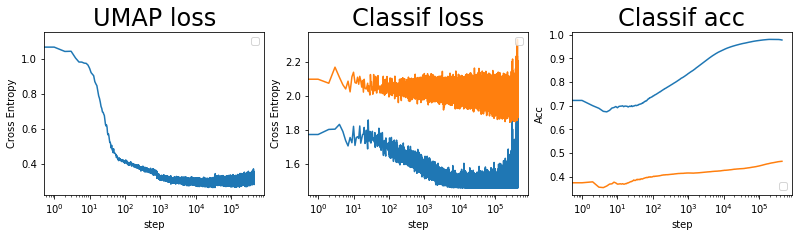

batch: 439000 | train acc: 0.9778 | val acc: 0.4657


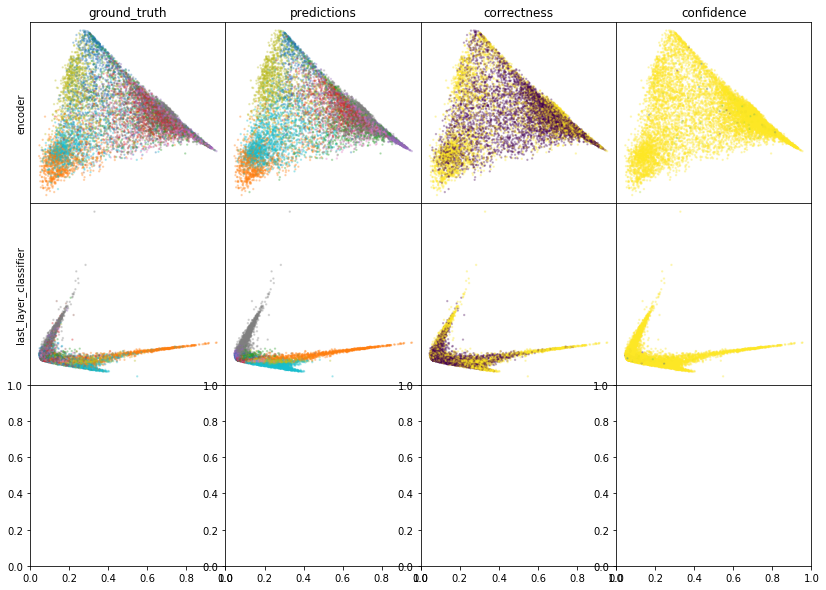

W0807 11:08:18.164950 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:08:19.128080 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:08:20.037812 140610860525376 legend.py:1282] No handles with labels found to put in legend.


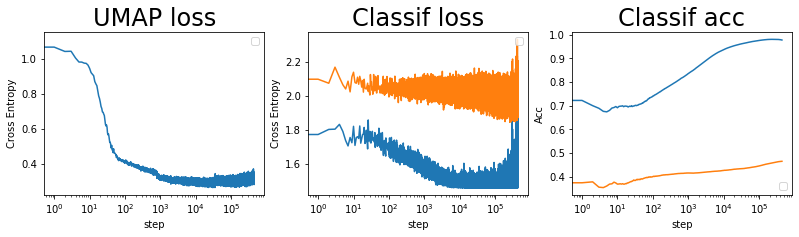

batch: 440000 | train acc: 0.9777 | val acc: 0.4656


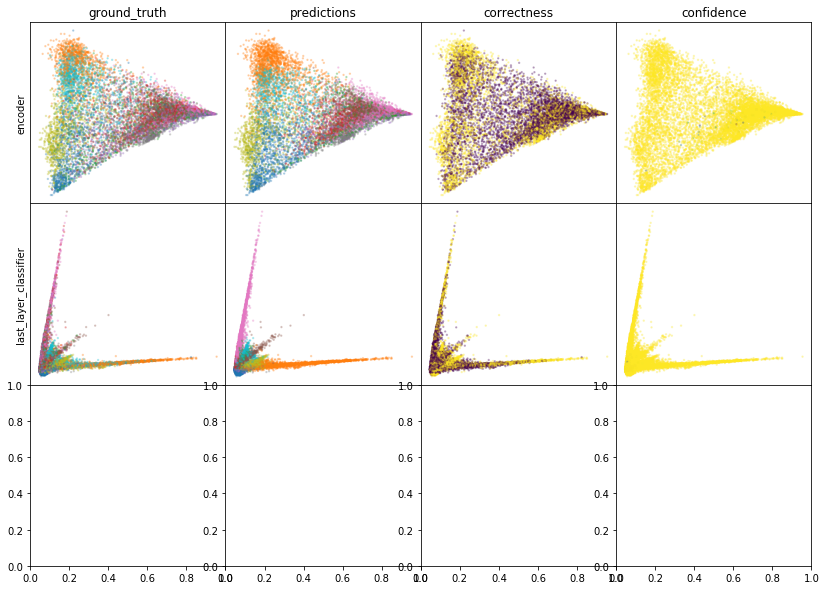

W0807 11:11:13.245288 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:11:14.210170 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:11:15.121811 140610860525376 legend.py:1282] No handles with labels found to put in legend.


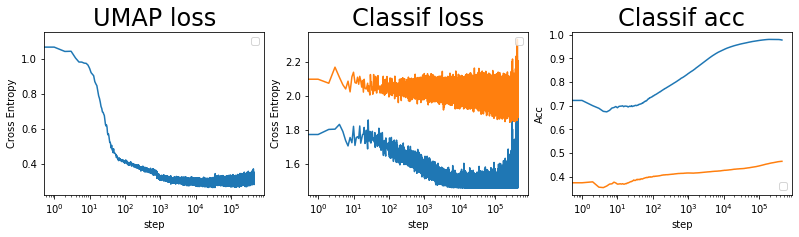

batch: 441000 | train acc: 0.9777 | val acc: 0.4656


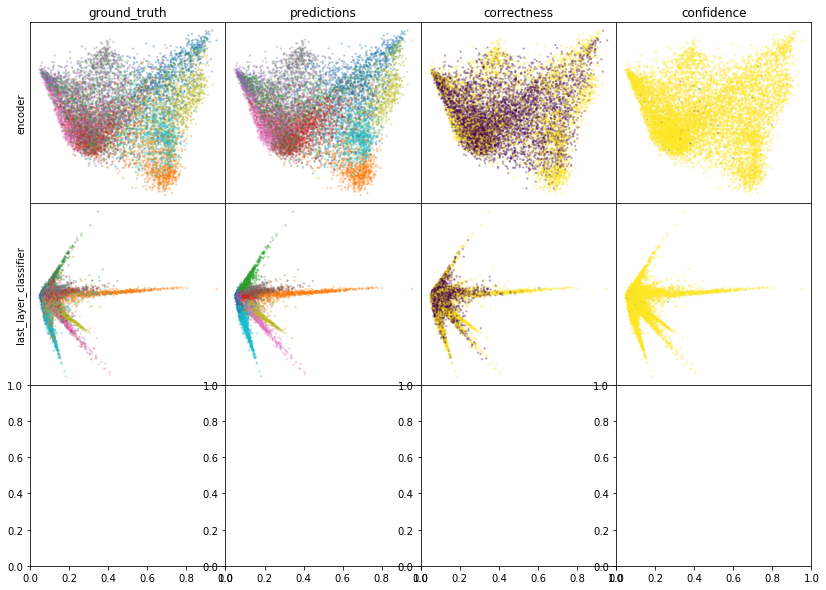

W0807 11:13:48.863791 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:13:49.825187 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:13:50.736282 140610860525376 legend.py:1282] No handles with labels found to put in legend.


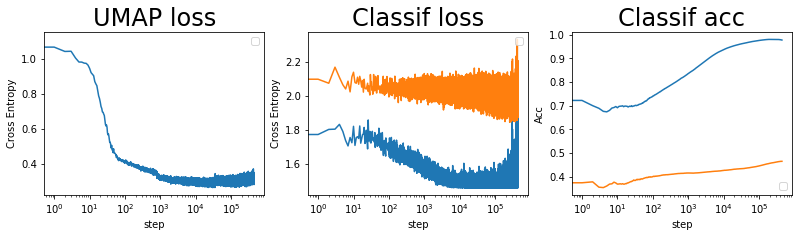

batch: 442000 | train acc: 0.9776 | val acc: 0.4656


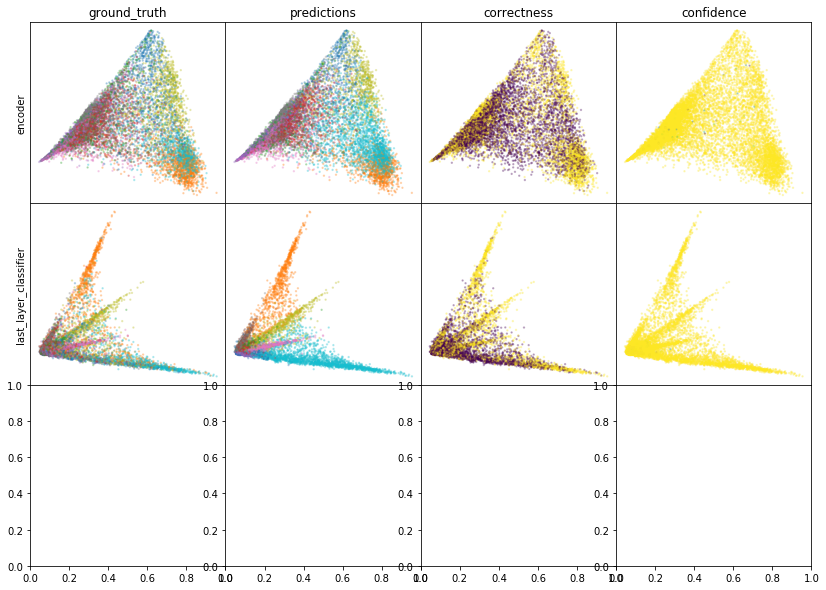

W0807 11:16:40.885253 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:16:41.856595 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:16:42.772510 140610860525376 legend.py:1282] No handles with labels found to put in legend.


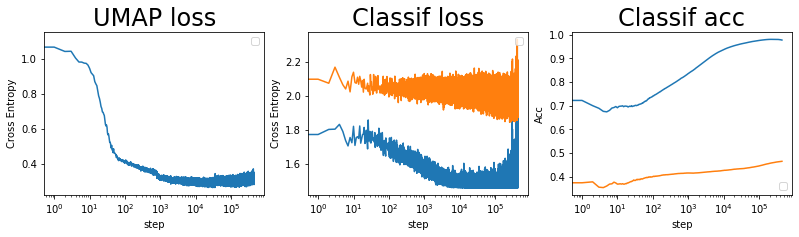

batch: 443000 | train acc: 0.9776 | val acc: 0.4656


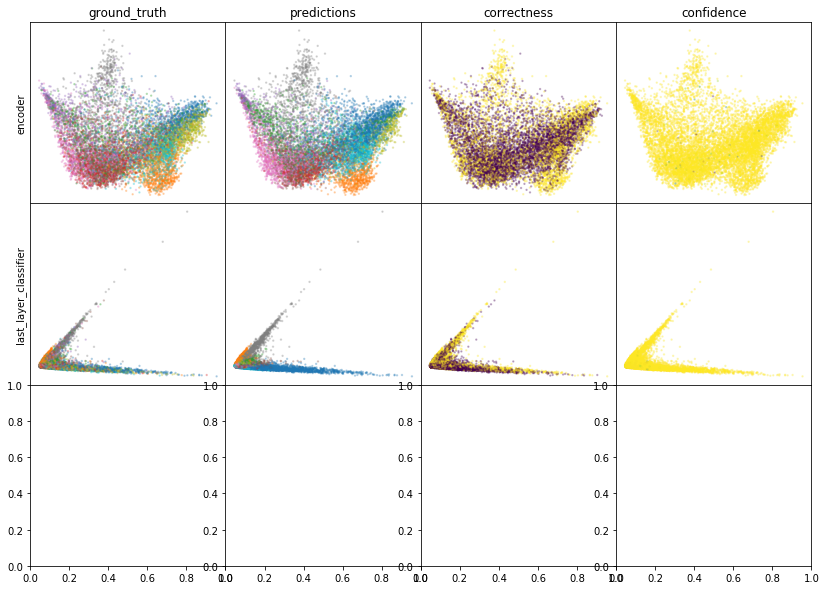

W0807 11:19:16.632901 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:19:17.599535 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:19:18.511907 140610860525376 legend.py:1282] No handles with labels found to put in legend.


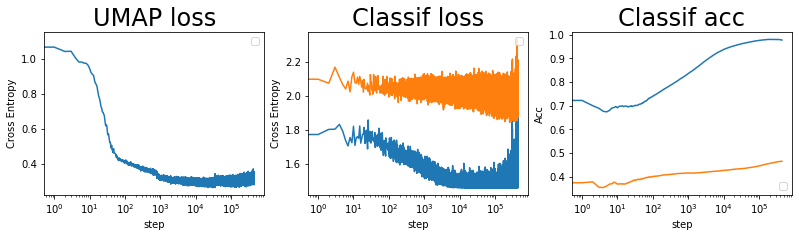

batch: 444000 | train acc: 0.9776 | val acc: 0.4656


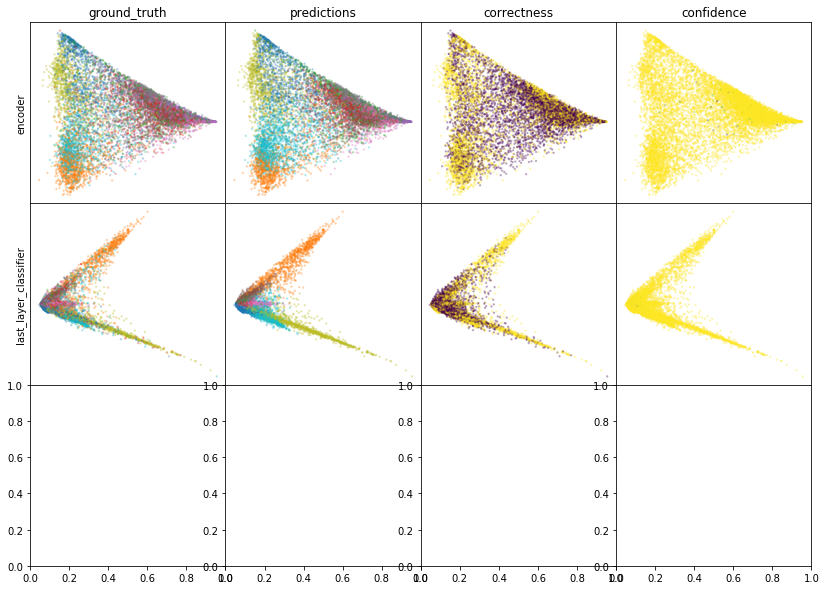

W0807 11:22:09.780519 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:22:10.748183 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:22:11.660237 140610860525376 legend.py:1282] No handles with labels found to put in legend.


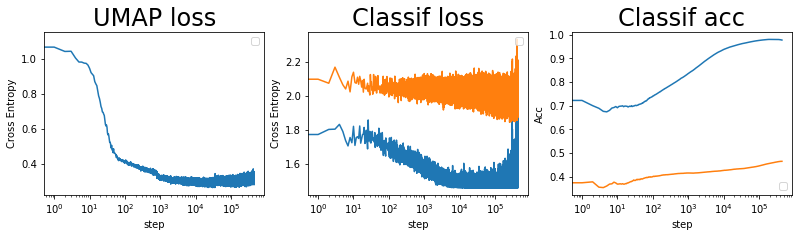

batch: 445000 | train acc: 0.9775 | val acc: 0.4656


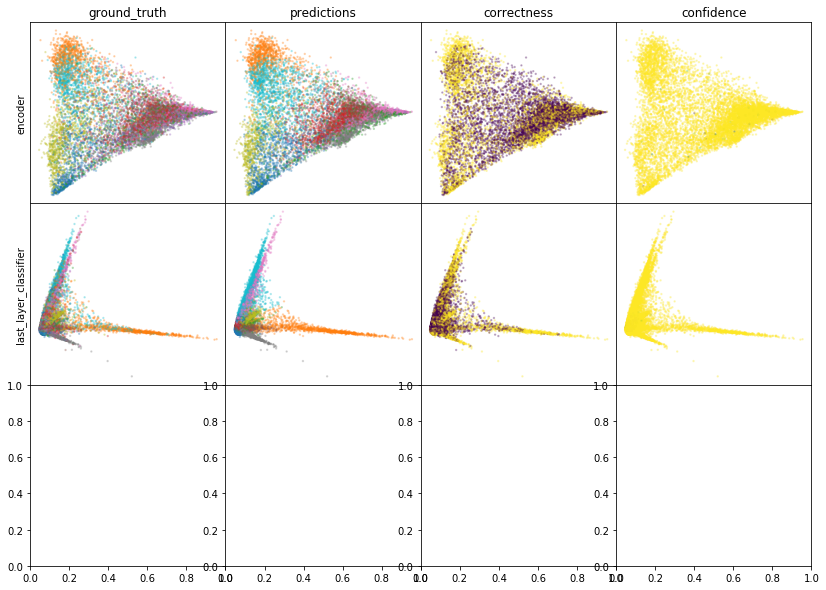

W0807 11:24:46.502897 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:24:47.462453 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:24:48.374282 140610860525376 legend.py:1282] No handles with labels found to put in legend.


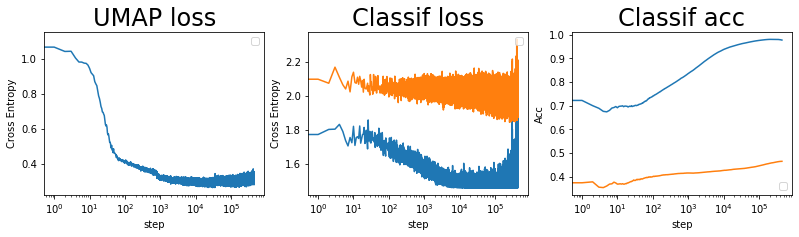

batch: 446000 | train acc: 0.9775 | val acc: 0.4656
leaving epoch because no improvement in 10000 batches


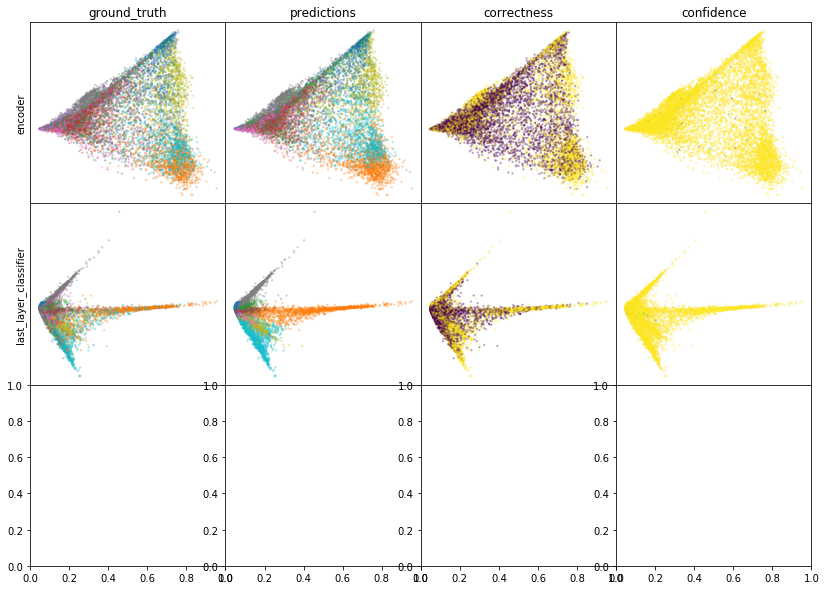

W0807 11:27:53.164319 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:27:54.129467 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:27:55.048877 140610860525376 legend.py:1282] No handles with labels found to put in legend.


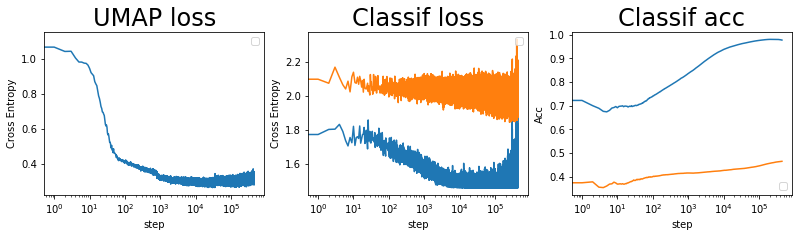

batch: 447000 | train acc: 0.9775 | val acc: 0.4656


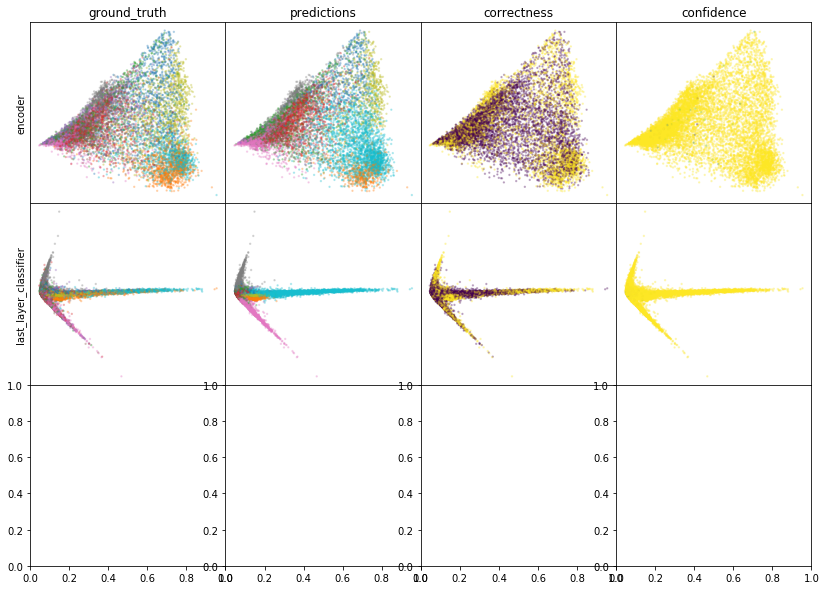

W0807 11:30:30.799819 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:30:31.773860 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:30:32.695410 140610860525376 legend.py:1282] No handles with labels found to put in legend.


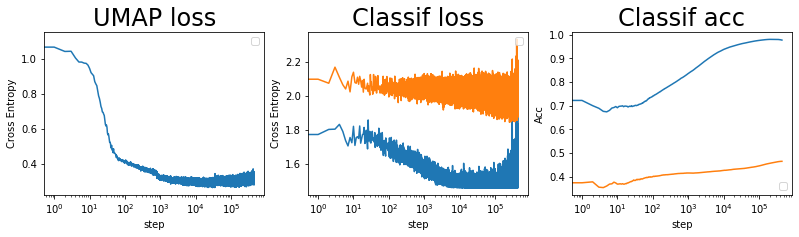

batch: 448000 | train acc: 0.9774 | val acc: 0.4656


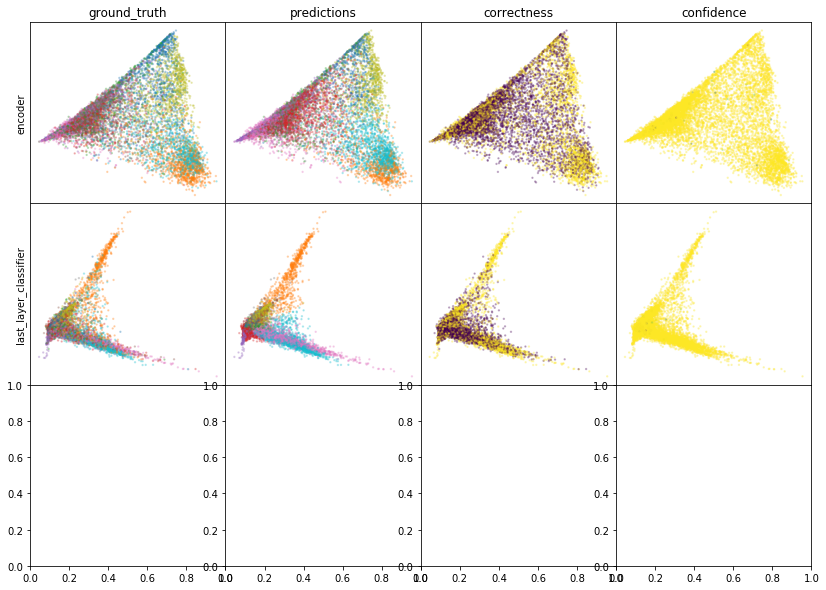

W0807 11:33:25.667955 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:33:26.660766 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:33:27.597183 140610860525376 legend.py:1282] No handles with labels found to put in legend.


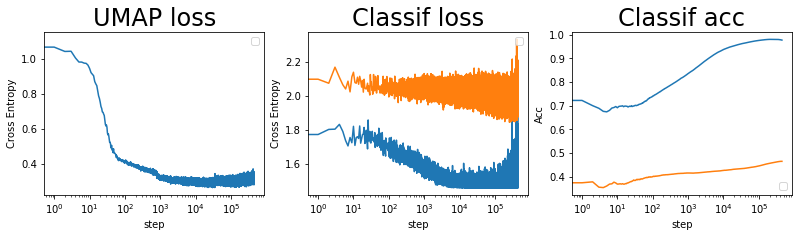

batch: 449000 | train acc: 0.9774 | val acc: 0.4656


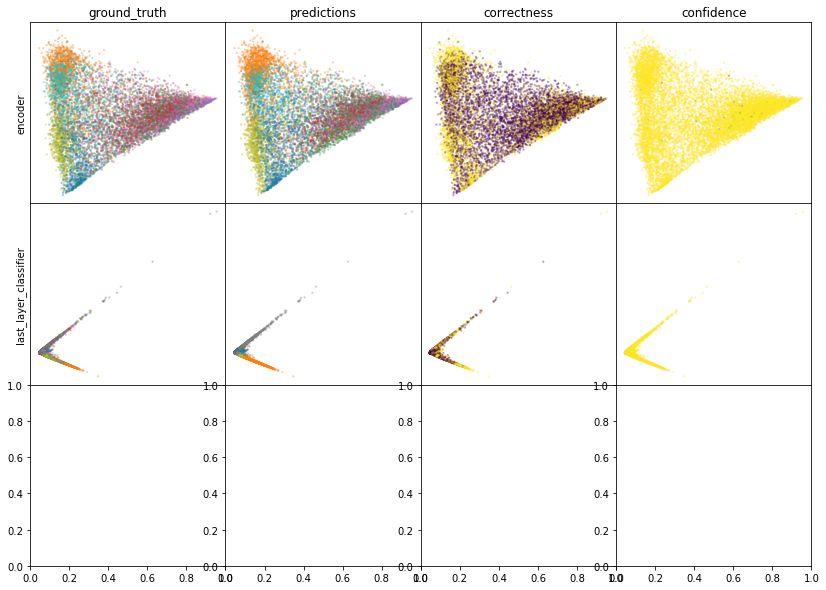

W0807 11:36:02.603423 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:36:03.584831 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:36:04.511250 140610860525376 legend.py:1282] No handles with labels found to put in legend.


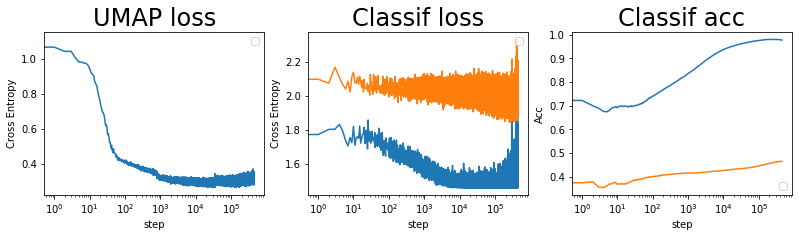

batch: 450000 | train acc: 0.9774 | val acc: 0.4656


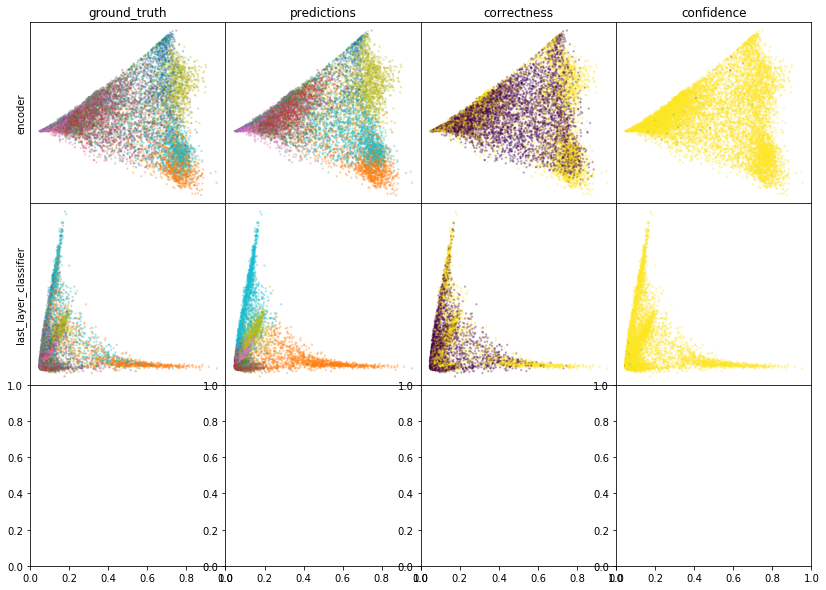

W0807 11:38:57.092037 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:38:58.078280 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:38:59.008151 140610860525376 legend.py:1282] No handles with labels found to put in legend.


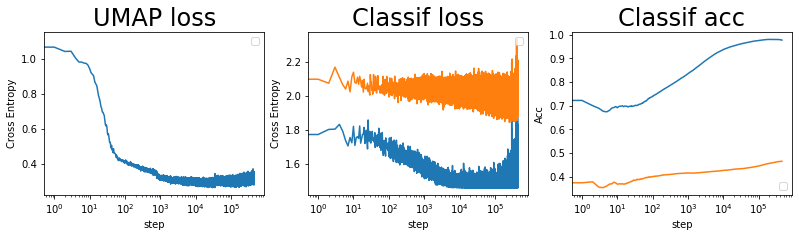

batch: 451000 | train acc: 0.9773 | val acc: 0.4656


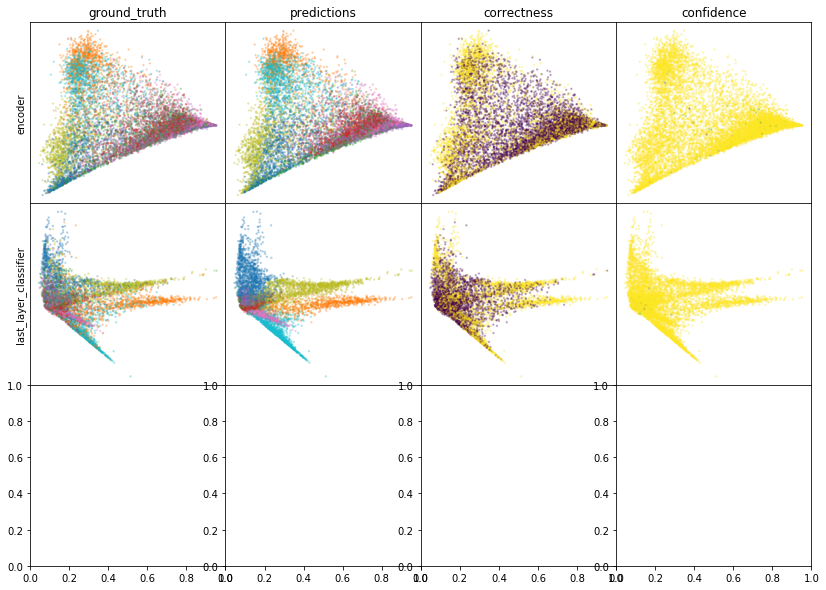

W0807 11:41:33.828136 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:41:34.807145 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:41:35.730092 140610860525376 legend.py:1282] No handles with labels found to put in legend.


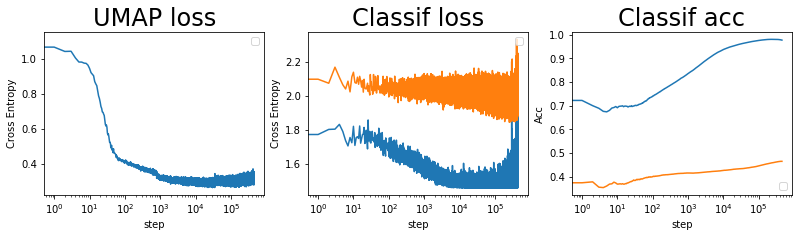

batch: 452000 | train acc: 0.9773 | val acc: 0.4656


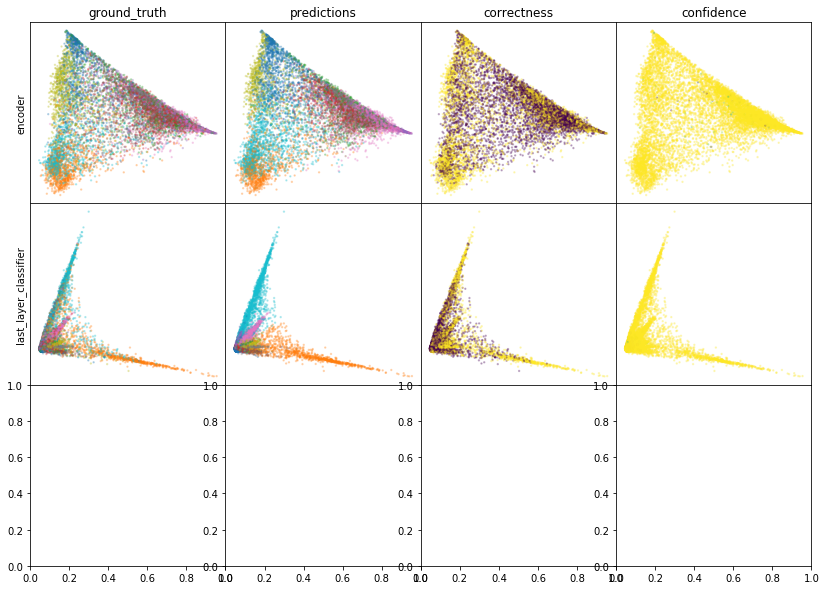

W0807 11:44:29.721536 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:44:30.715666 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:44:31.660692 140610860525376 legend.py:1282] No handles with labels found to put in legend.


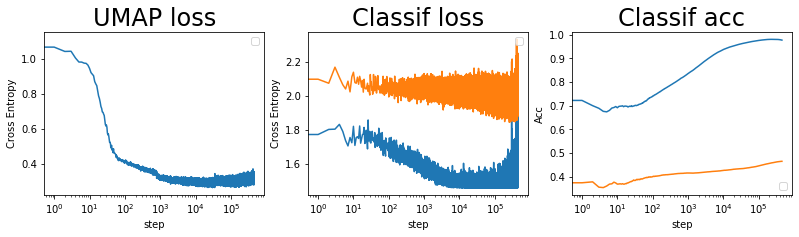

batch: 453000 | train acc: 0.9773 | val acc: 0.4656


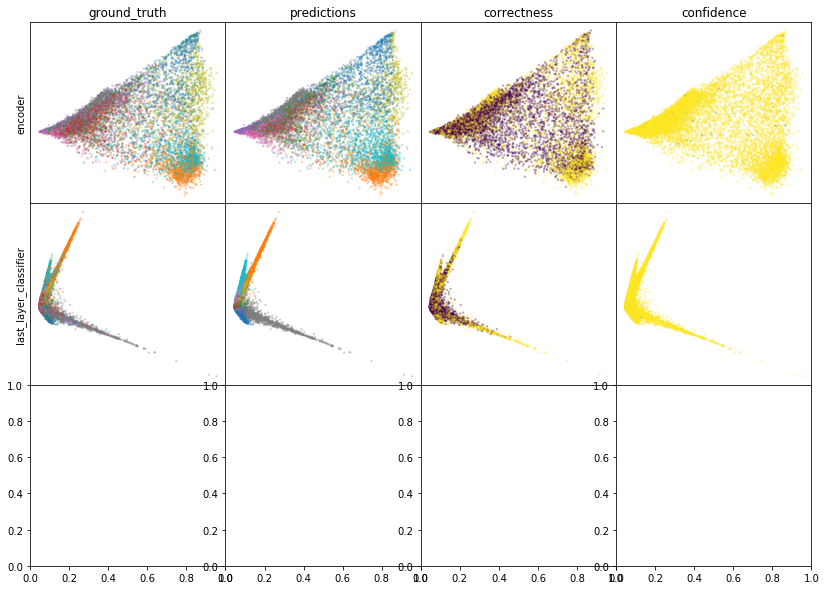

W0807 11:47:05.950580 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:47:06.937343 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:47:07.864371 140610860525376 legend.py:1282] No handles with labels found to put in legend.


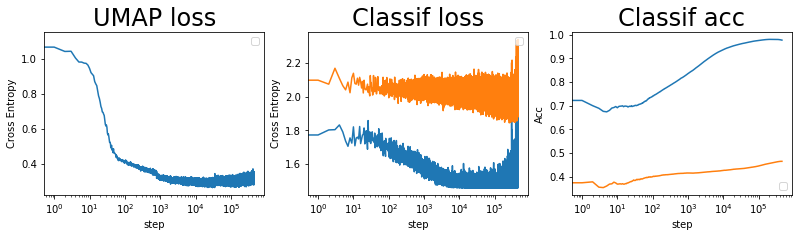

batch: 454000 | train acc: 0.9773 | val acc: 0.4656


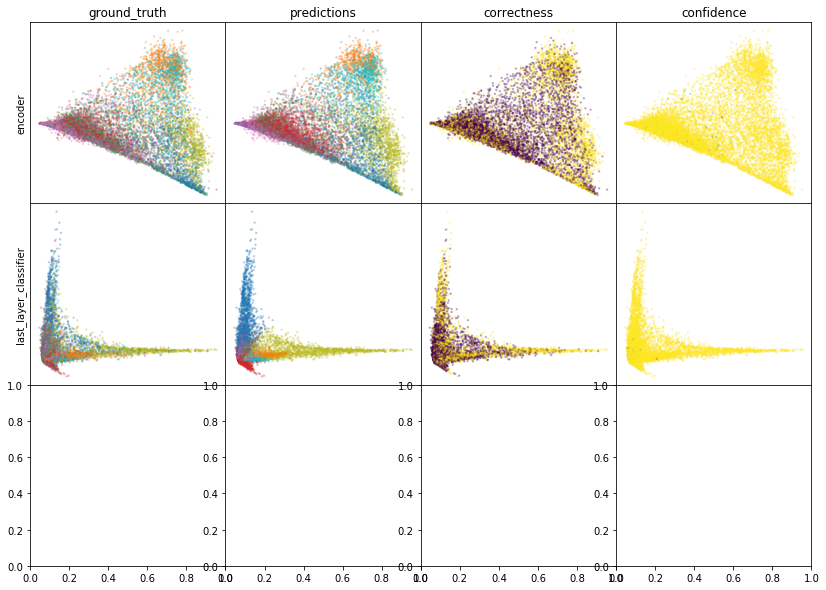

W0807 11:50:03.636435 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:50:04.638963 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:50:05.578502 140610860525376 legend.py:1282] No handles with labels found to put in legend.


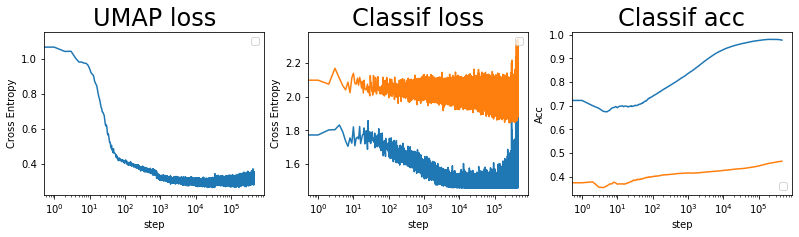

batch: 455000 | train acc: 0.9772 | val acc: 0.4656


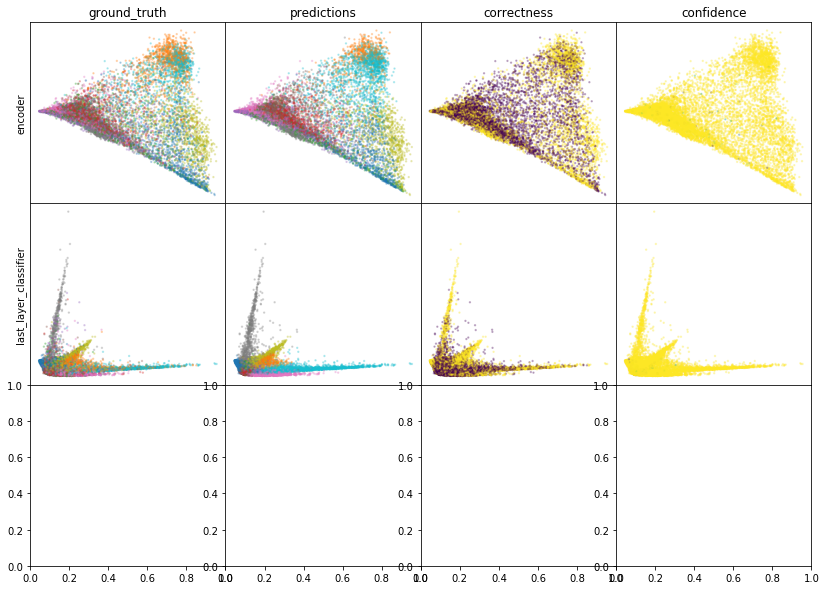

W0807 11:52:42.610945 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:52:43.603710 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:52:44.534442 140610860525376 legend.py:1282] No handles with labels found to put in legend.


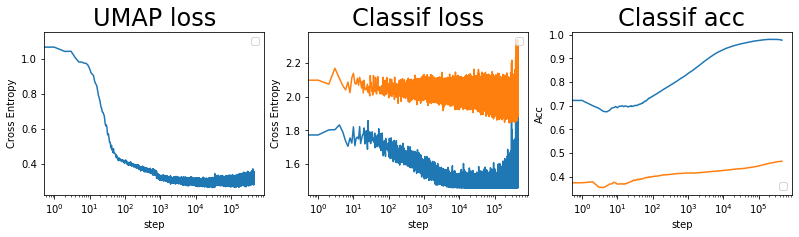

batch: 456000 | train acc: 0.9772 | val acc: 0.4656
leaving epoch because no improvement in 10000 batches


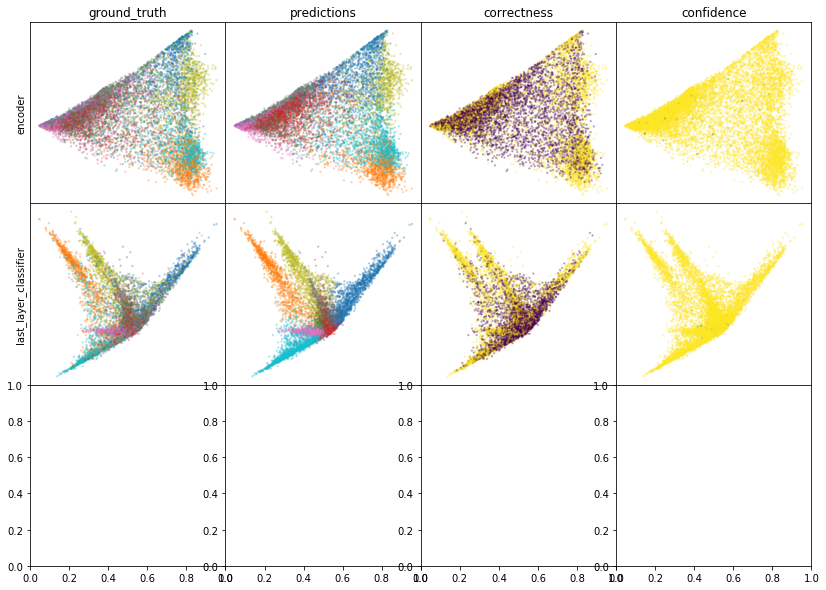

W0807 11:56:10.109293 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:56:11.096376 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:56:12.030106 140610860525376 legend.py:1282] No handles with labels found to put in legend.


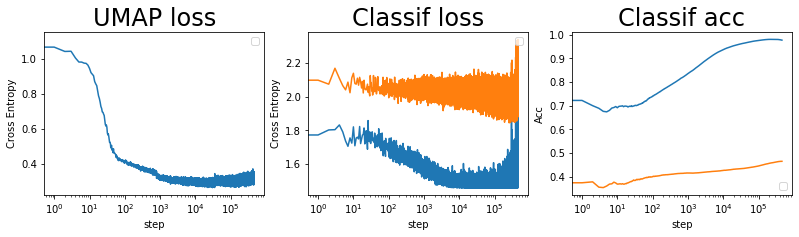

batch: 457000 | train acc: 0.9772 | val acc: 0.4656


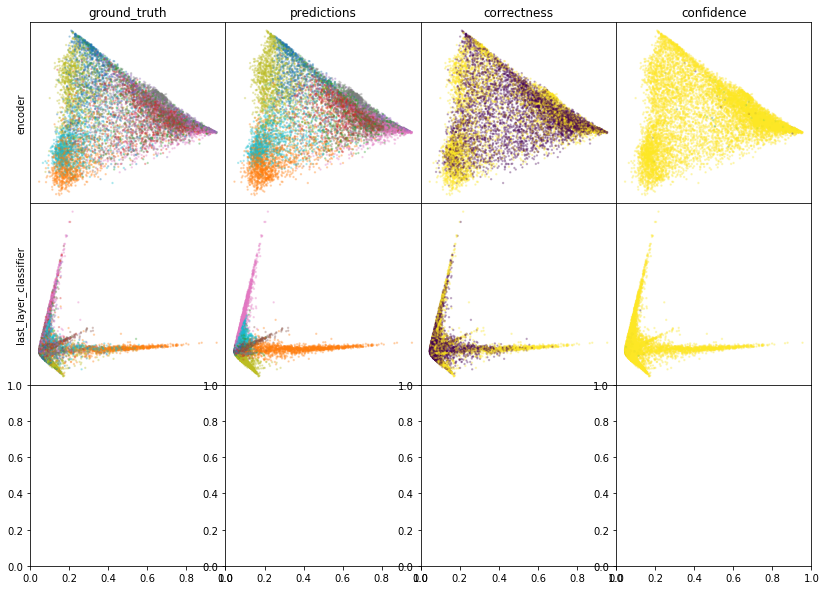

W0807 11:58:46.051599 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:58:47.042701 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 11:58:47.978550 140610860525376 legend.py:1282] No handles with labels found to put in legend.


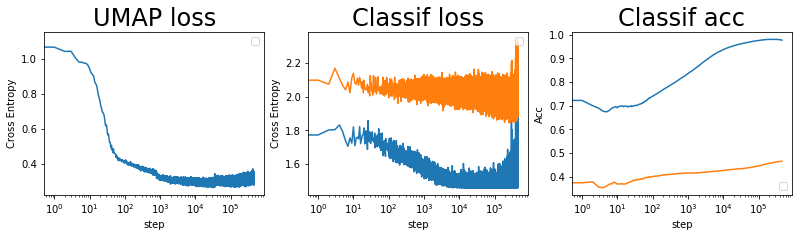

batch: 458000 | train acc: 0.9771 | val acc: 0.4656


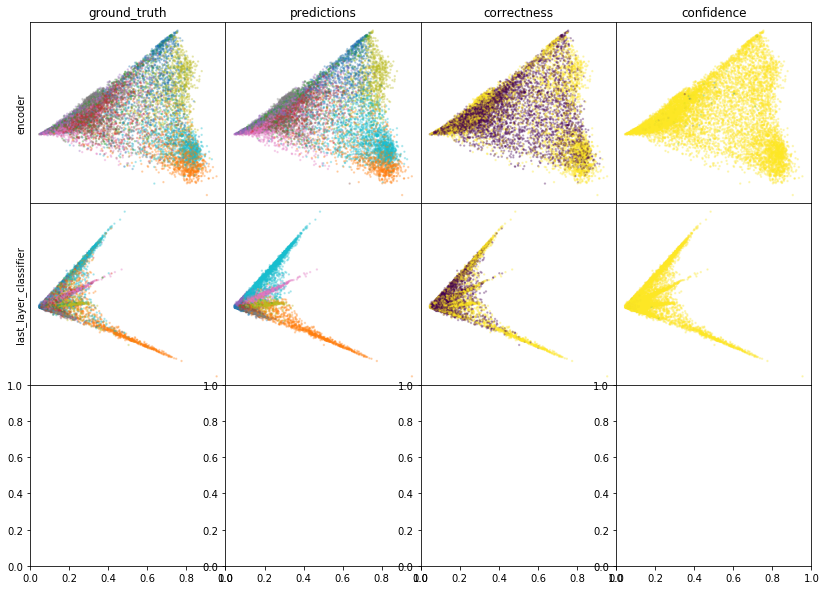

W0807 12:01:44.409546 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:01:45.397781 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:01:46.327342 140610860525376 legend.py:1282] No handles with labels found to put in legend.


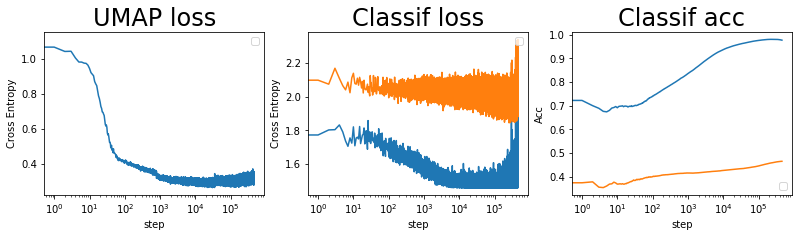

batch: 459000 | train acc: 0.9771 | val acc: 0.4656


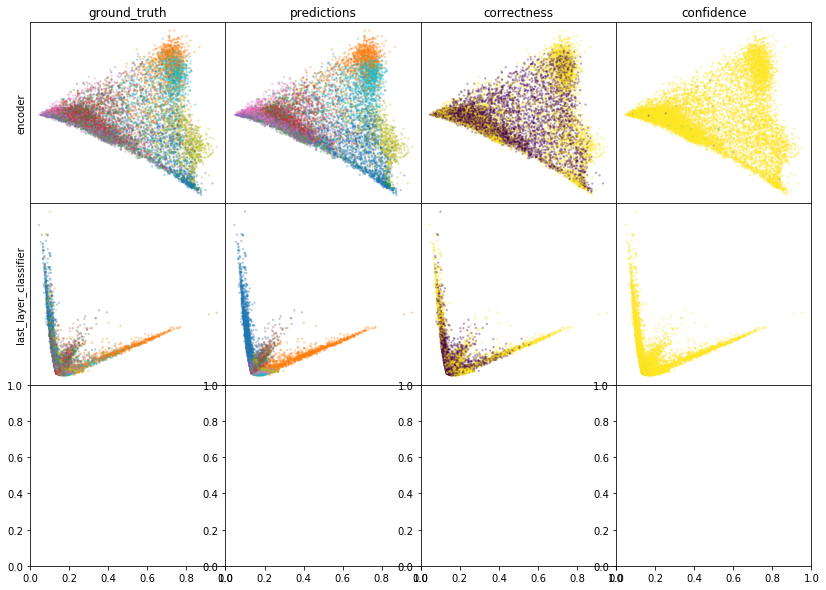

W0807 12:04:21.791860 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:04:22.790003 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:04:23.733480 140610860525376 legend.py:1282] No handles with labels found to put in legend.


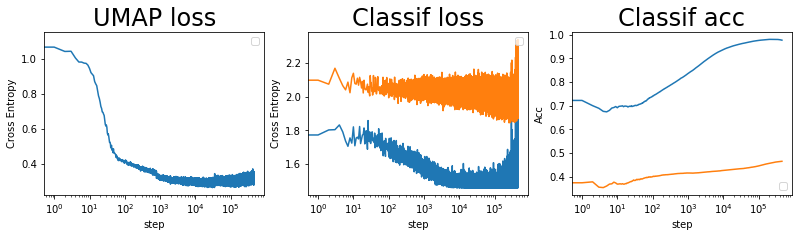

batch: 460000 | train acc: 0.977 | val acc: 0.4656


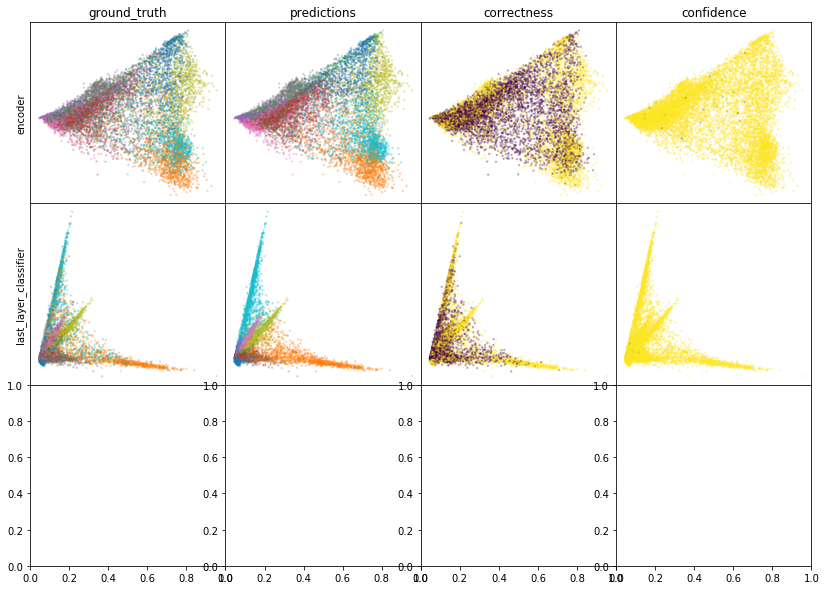

W0807 12:07:19.122727 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:07:20.124835 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:07:21.077108 140610860525376 legend.py:1282] No handles with labels found to put in legend.


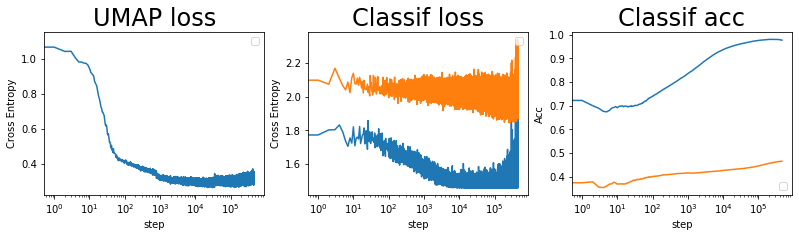

batch: 461000 | train acc: 0.977 | val acc: 0.4657


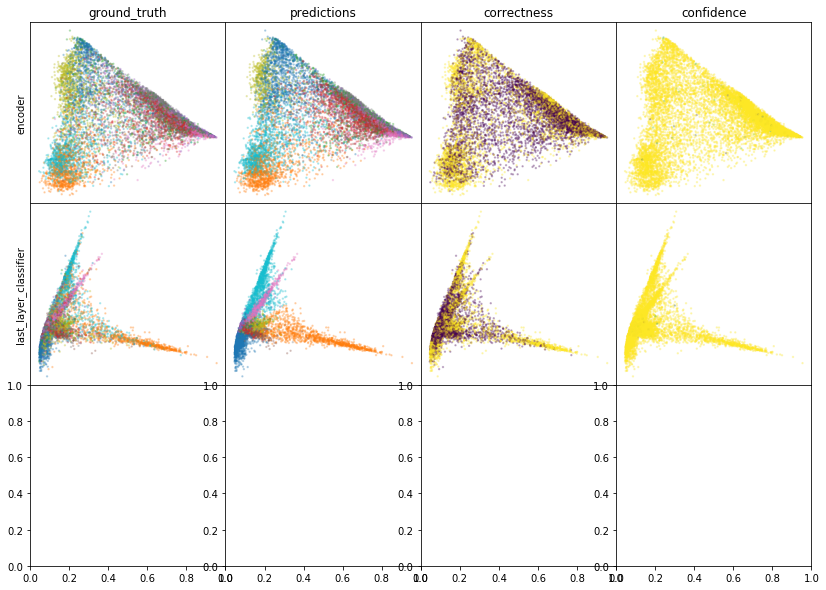

W0807 12:09:56.198078 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:09:57.212255 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:09:58.168076 140610860525376 legend.py:1282] No handles with labels found to put in legend.


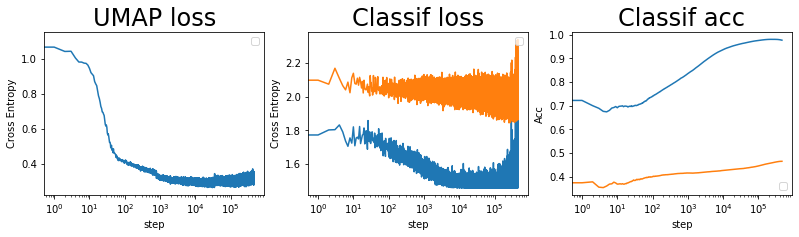

batch: 462000 | train acc: 0.977 | val acc: 0.4657


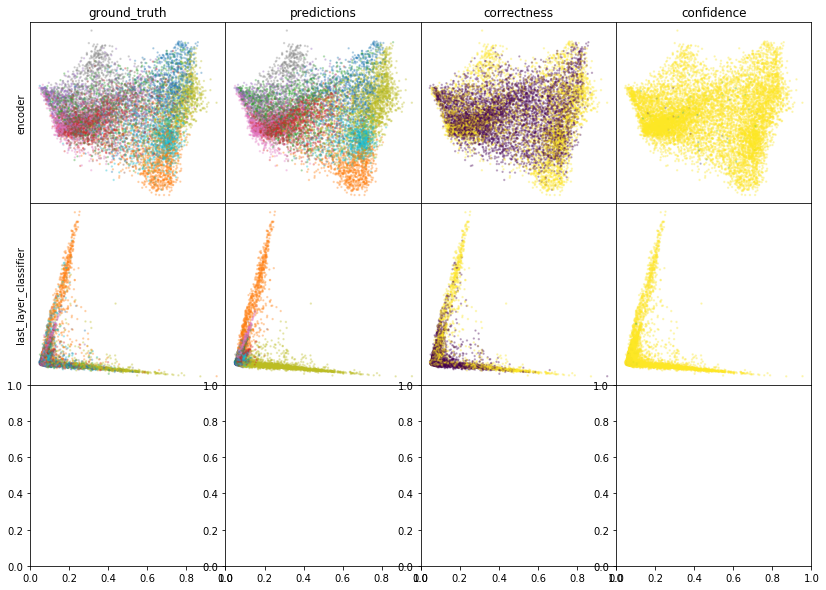

W0807 12:12:53.201725 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:12:54.198563 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:12:55.139696 140610860525376 legend.py:1282] No handles with labels found to put in legend.


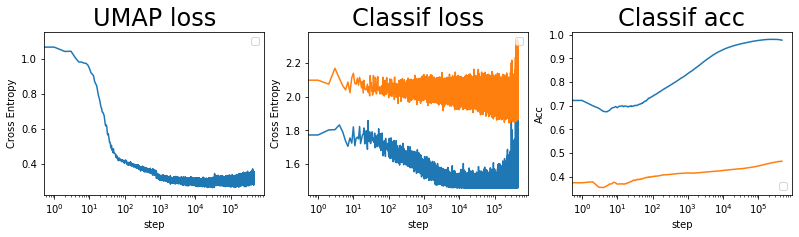

batch: 463000 | train acc: 0.977 | val acc: 0.4657


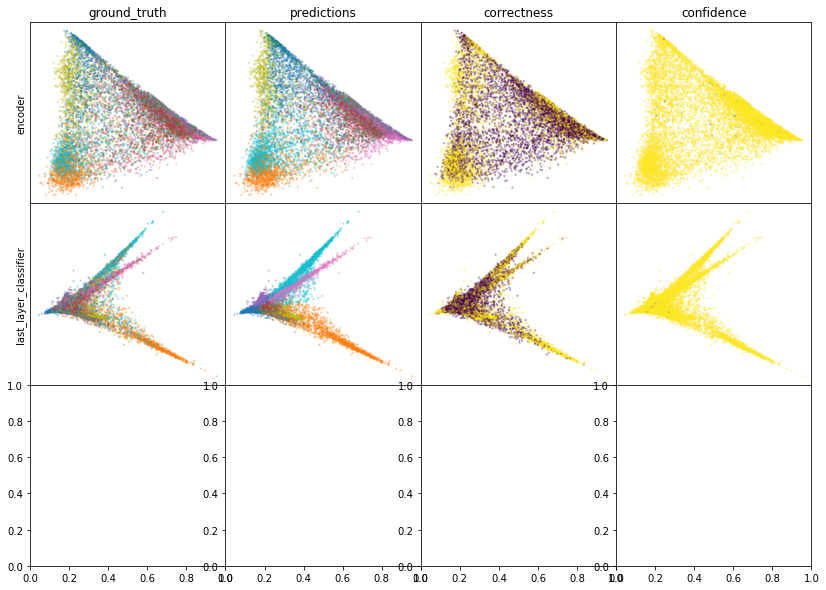

W0807 12:15:32.344523 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:15:33.368036 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:15:34.336822 140610860525376 legend.py:1282] No handles with labels found to put in legend.


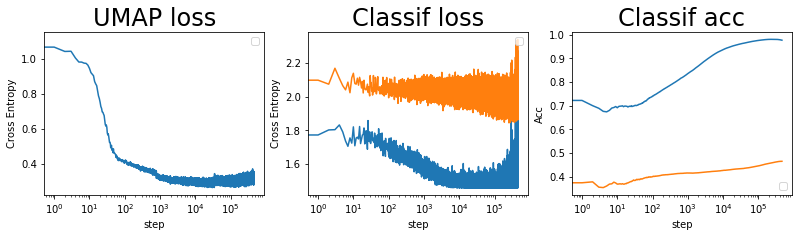

batch: 464000 | train acc: 0.9769 | val acc: 0.4657


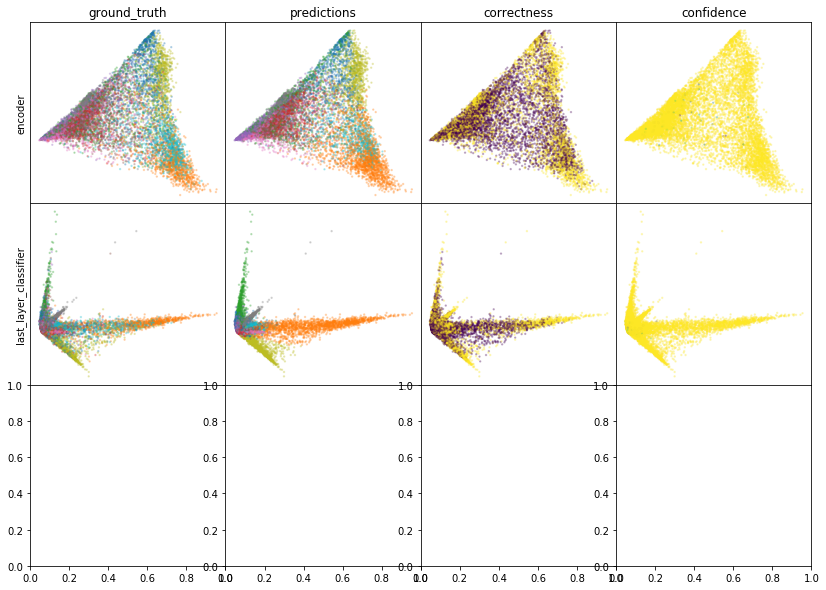

W0807 12:18:30.624713 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:18:31.630086 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:18:32.578497 140610860525376 legend.py:1282] No handles with labels found to put in legend.


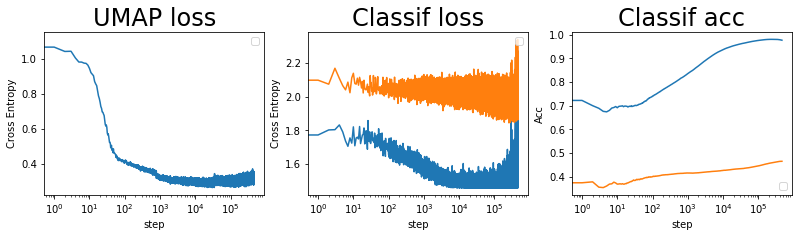

batch: 465000 | train acc: 0.9769 | val acc: 0.4657


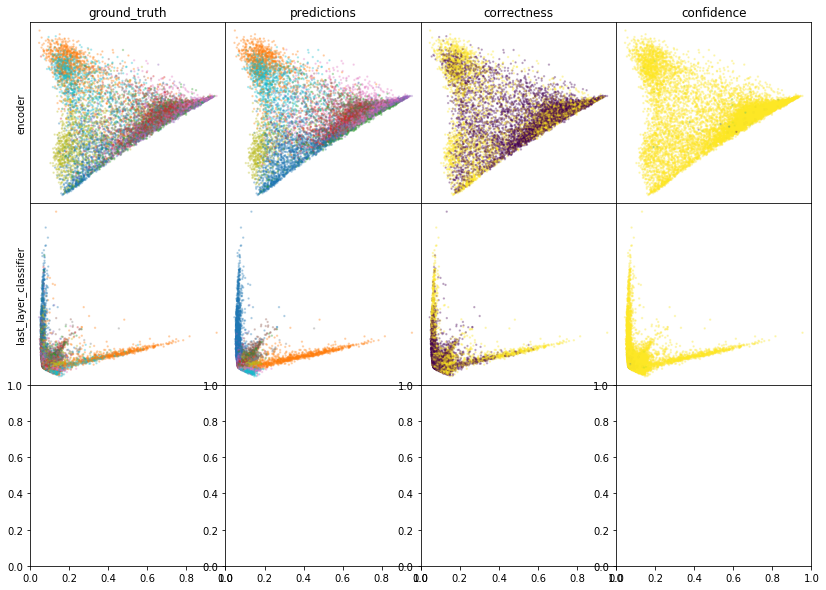

W0807 12:21:09.165550 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:21:10.175792 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:21:11.130198 140610860525376 legend.py:1282] No handles with labels found to put in legend.


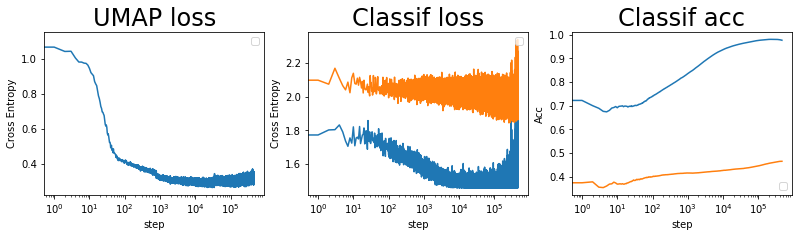

batch: 466000 | train acc: 0.9768 | val acc: 0.4657


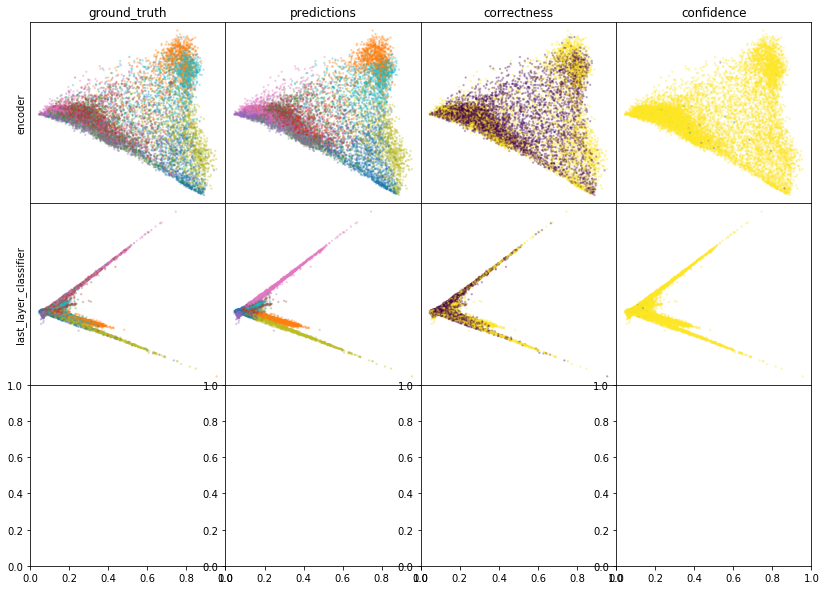

W0807 12:24:08.169913 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:24:09.178675 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:24:10.125577 140610860525376 legend.py:1282] No handles with labels found to put in legend.


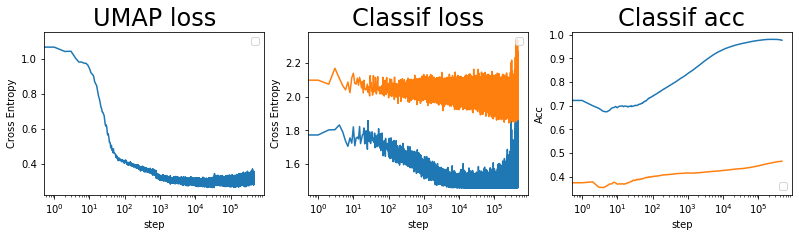

batch: 467000 | train acc: 0.9768 | val acc: 0.4657


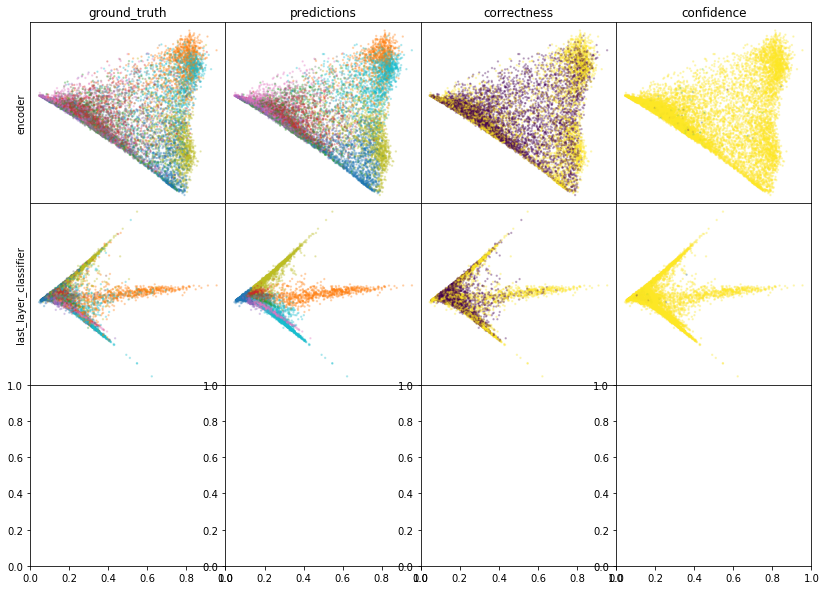

W0807 12:26:47.371152 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:26:48.393720 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:26:49.361609 140610860525376 legend.py:1282] No handles with labels found to put in legend.


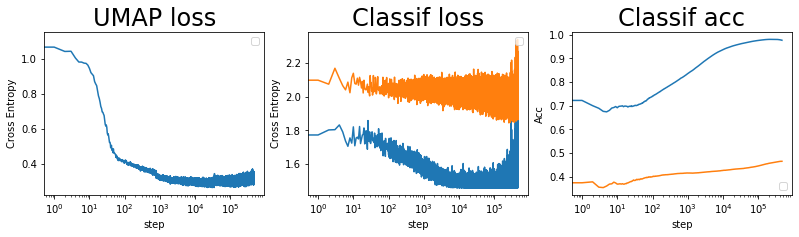

batch: 468000 | train acc: 0.9767 | val acc: 0.4657


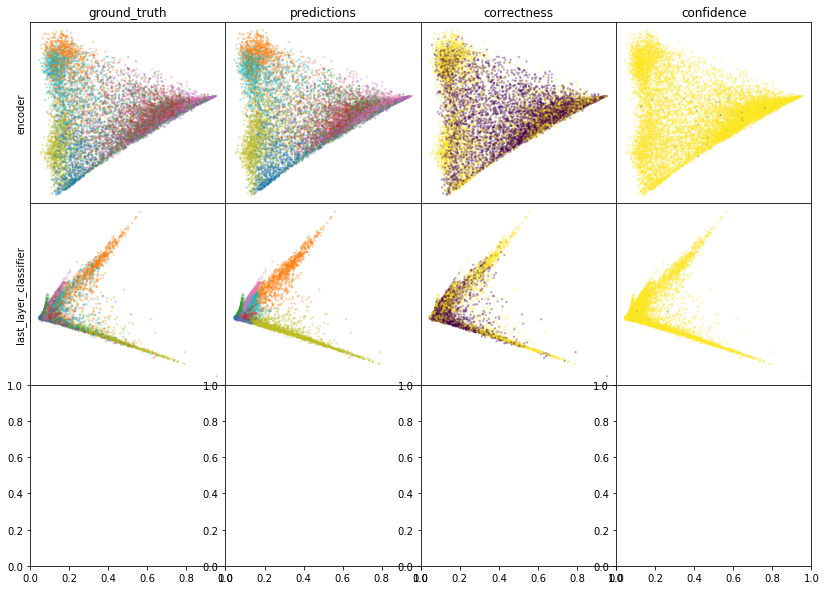

W0807 12:29:45.466641 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:29:46.478669 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:29:47.432283 140610860525376 legend.py:1282] No handles with labels found to put in legend.


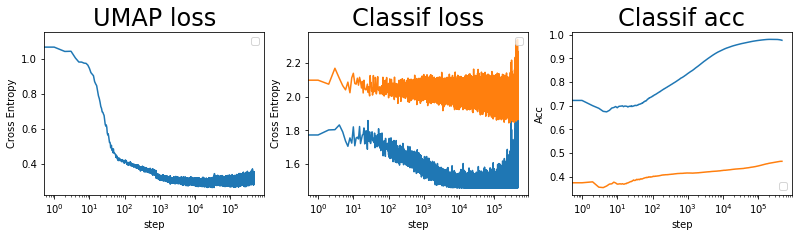

batch: 469000 | train acc: 0.9767 | val acc: 0.4657


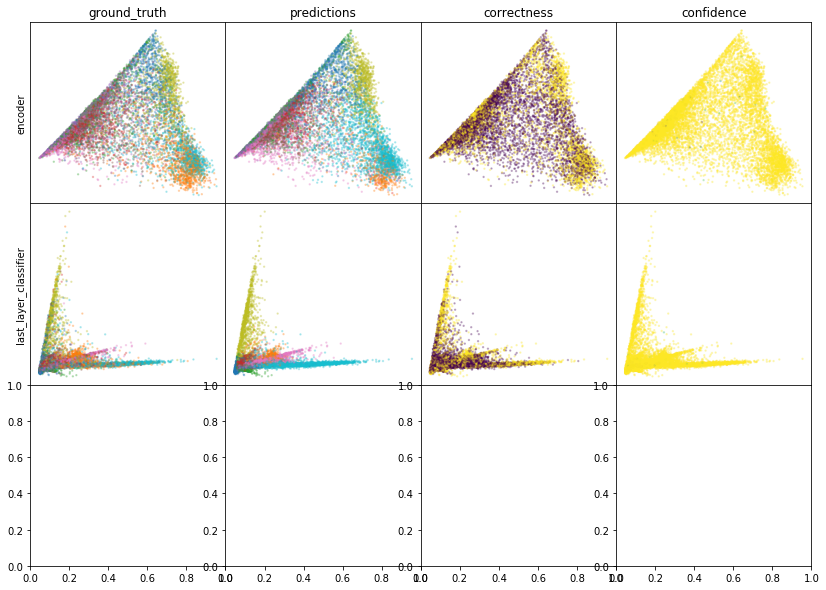

W0807 12:32:26.018506 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:32:27.035428 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:32:27.989475 140610860525376 legend.py:1282] No handles with labels found to put in legend.


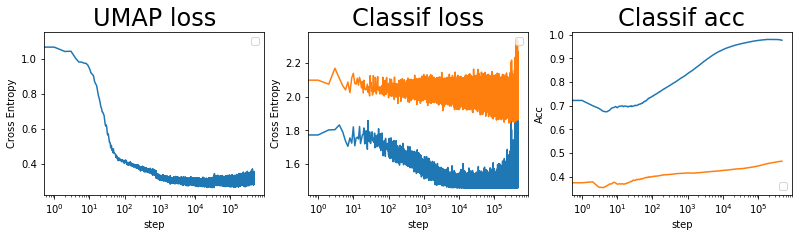

batch: 470000 | train acc: 0.9767 | val acc: 0.4657


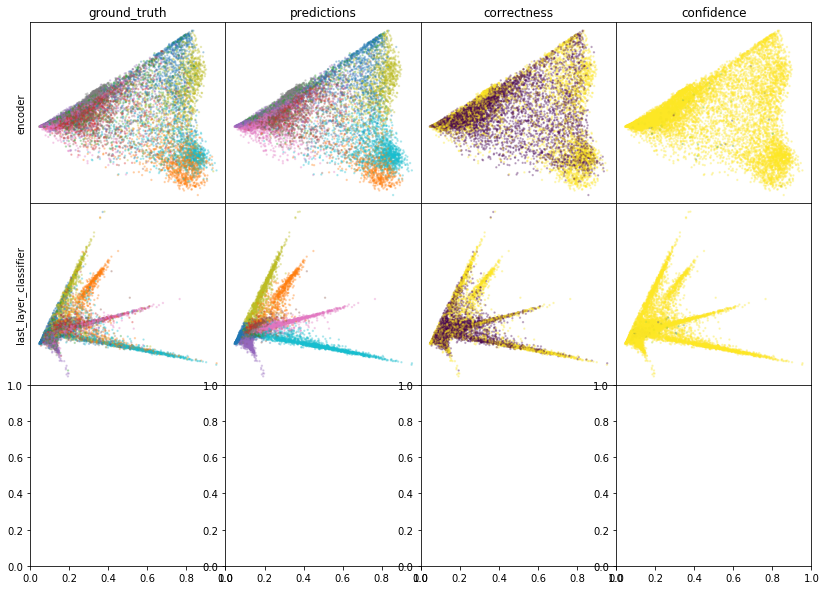

W0807 12:35:22.790416 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:35:23.809272 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:35:24.771876 140610860525376 legend.py:1282] No handles with labels found to put in legend.


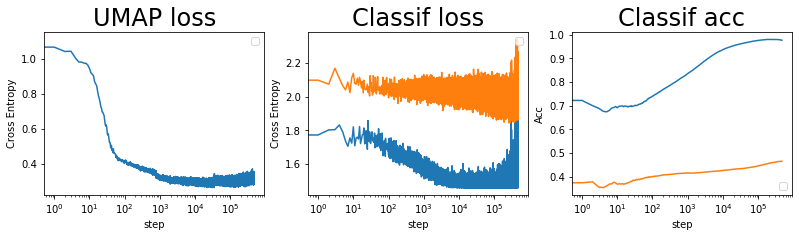

batch: 471000 | train acc: 0.9767 | val acc: 0.4657


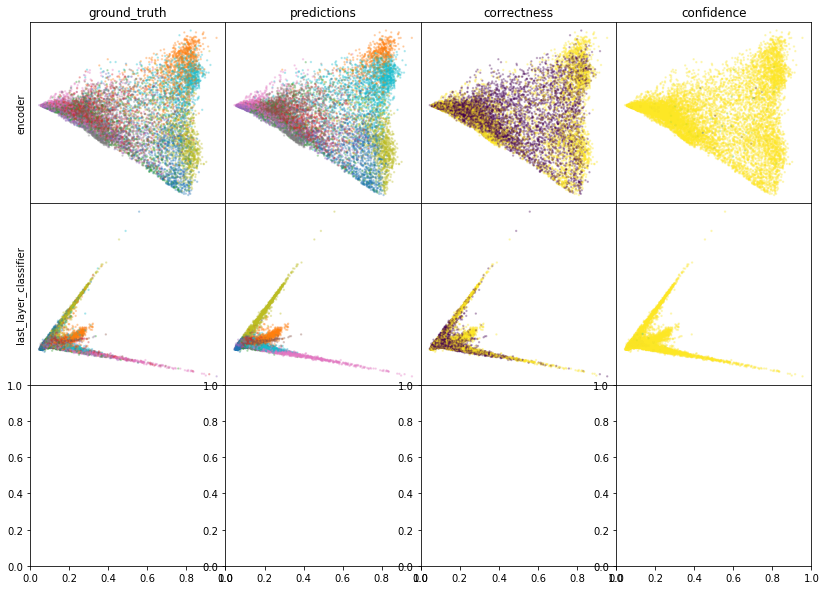

W0807 12:38:05.404545 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:38:06.425051 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:38:07.381895 140610860525376 legend.py:1282] No handles with labels found to put in legend.


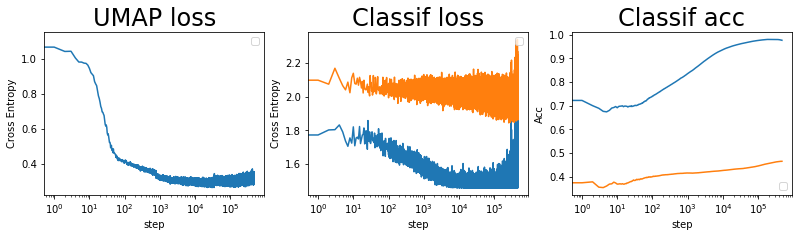

batch: 472000 | train acc: 0.9766 | val acc: 0.4657
leaving epoch because no improvement in 10000 batches


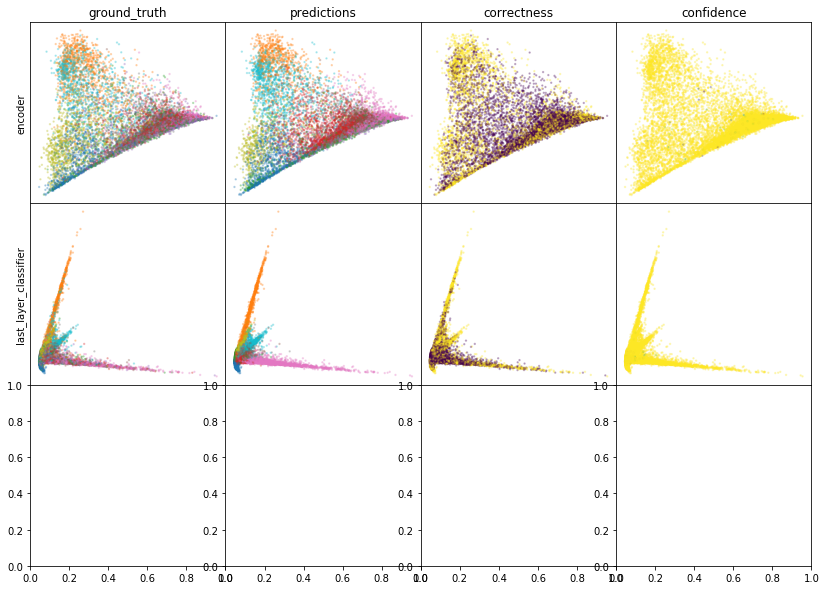

W0807 12:41:33.868108 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:41:34.887650 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:41:35.841393 140610860525376 legend.py:1282] No handles with labels found to put in legend.


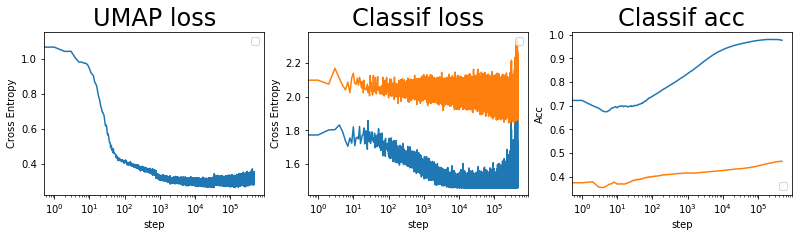

batch: 473000 | train acc: 0.9766 | val acc: 0.4657


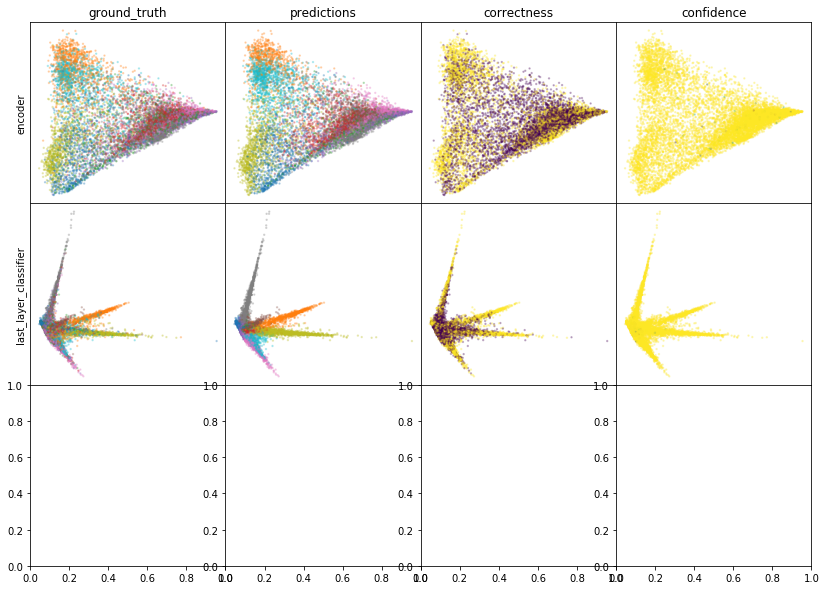

W0807 12:44:13.529785 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:44:14.551598 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:44:15.507591 140610860525376 legend.py:1282] No handles with labels found to put in legend.


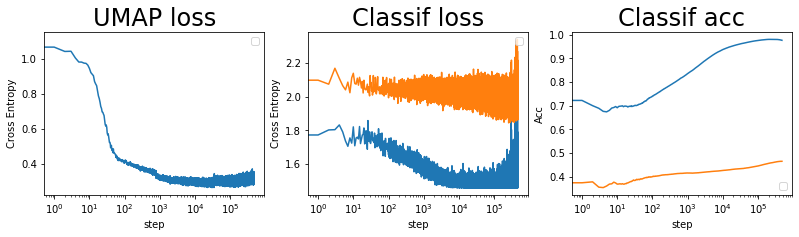

batch: 474000 | train acc: 0.9765 | val acc: 0.4657


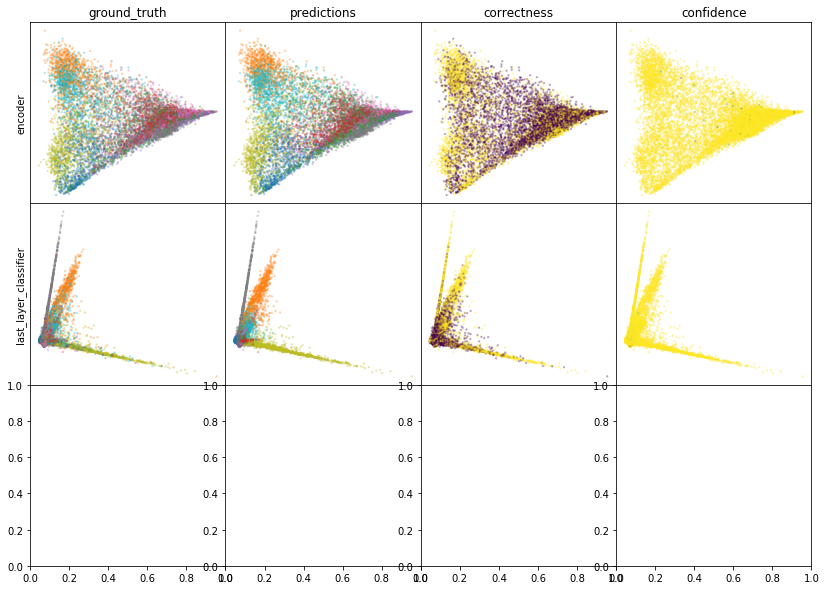

W0807 12:47:15.594574 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:47:16.627319 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:47:17.596966 140610860525376 legend.py:1282] No handles with labels found to put in legend.


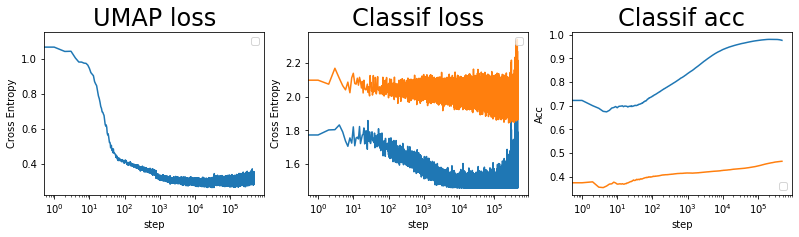

batch: 475000 | train acc: 0.9765 | val acc: 0.4657


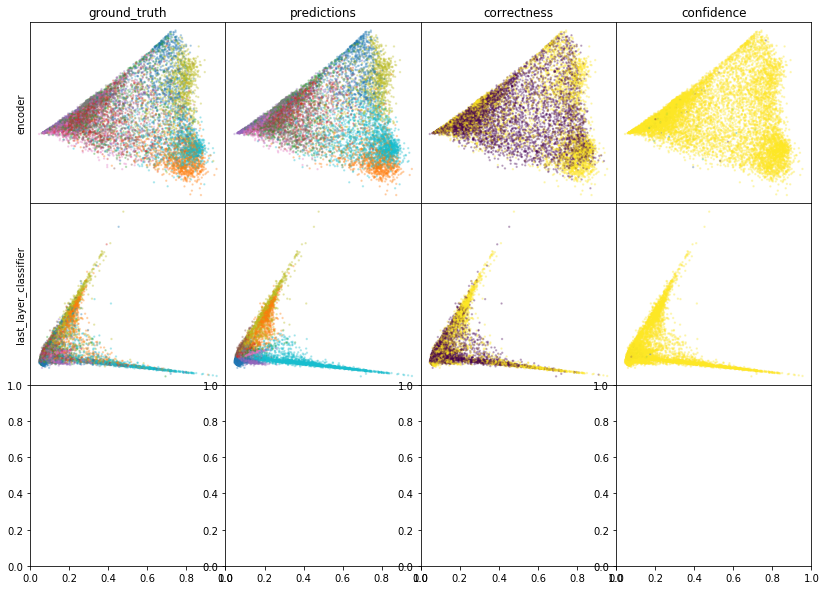

W0807 12:49:56.242105 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:49:57.278338 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:49:58.258654 140610860525376 legend.py:1282] No handles with labels found to put in legend.


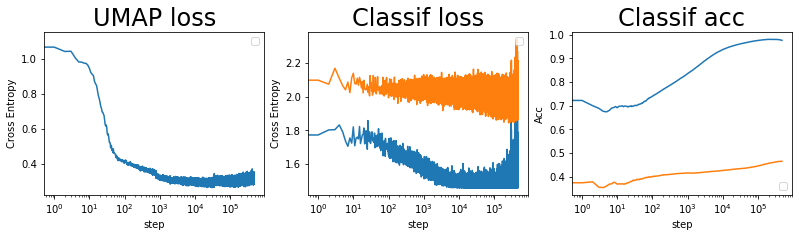

batch: 476000 | train acc: 0.9764 | val acc: 0.4657


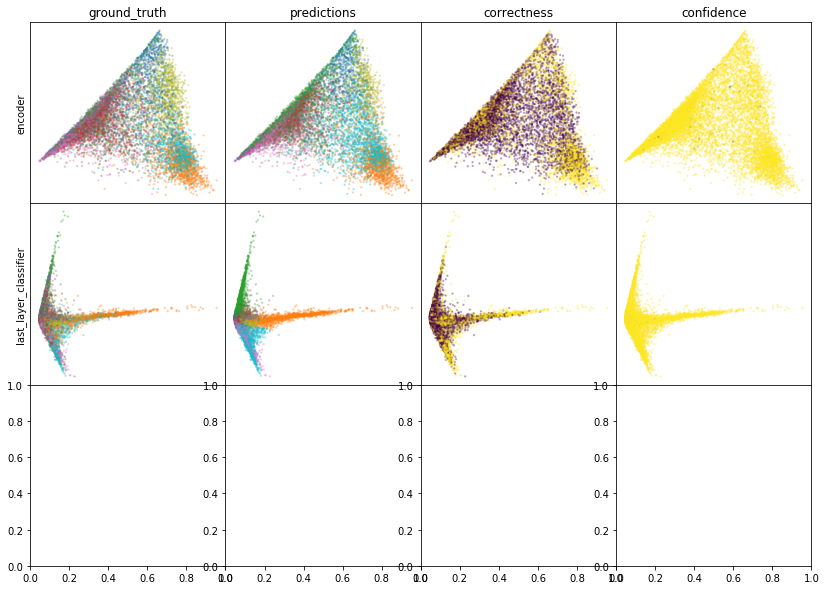

W0807 12:52:56.547837 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:52:57.585581 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:52:58.566095 140610860525376 legend.py:1282] No handles with labels found to put in legend.


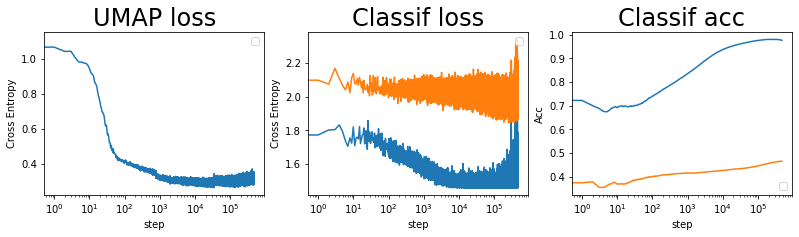

batch: 477000 | train acc: 0.9764 | val acc: 0.4657


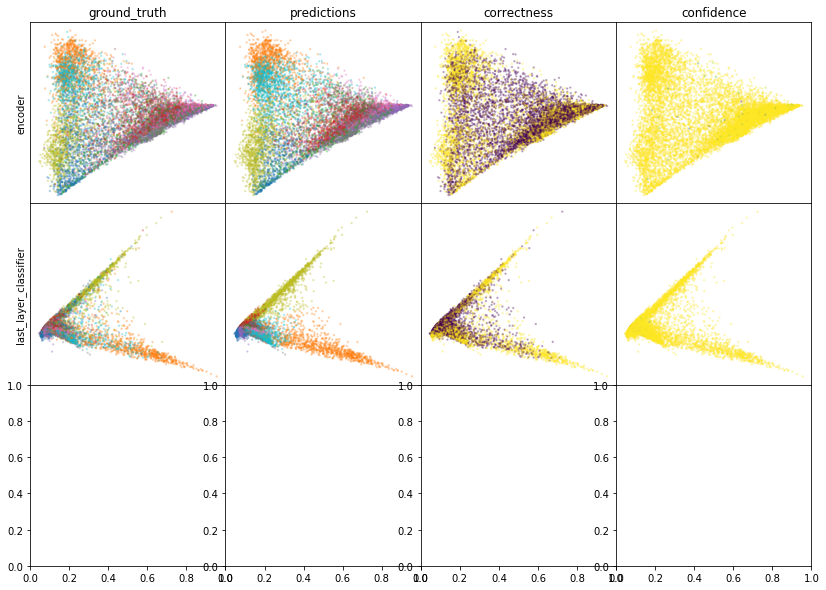

W0807 12:55:39.227350 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:55:40.272730 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:55:41.254353 140610860525376 legend.py:1282] No handles with labels found to put in legend.


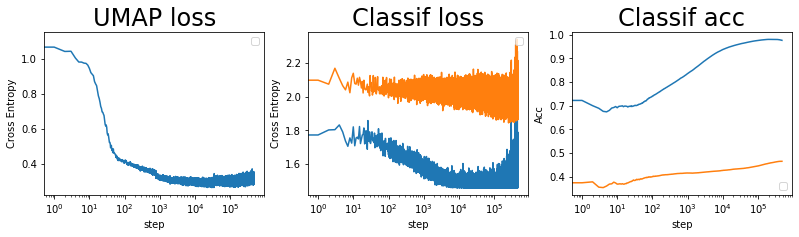

batch: 478000 | train acc: 0.9764 | val acc: 0.4657


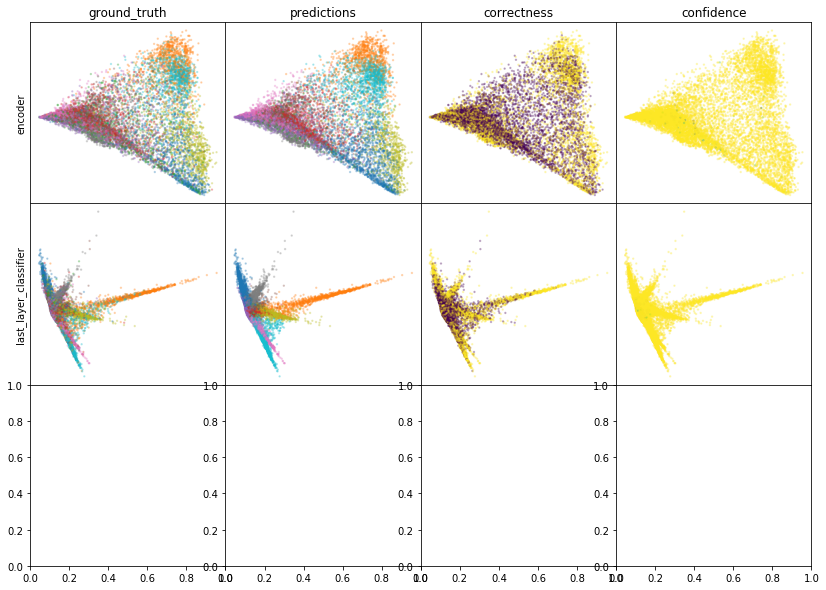

W0807 12:58:38.961330 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:58:39.988159 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 12:58:40.957533 140610860525376 legend.py:1282] No handles with labels found to put in legend.


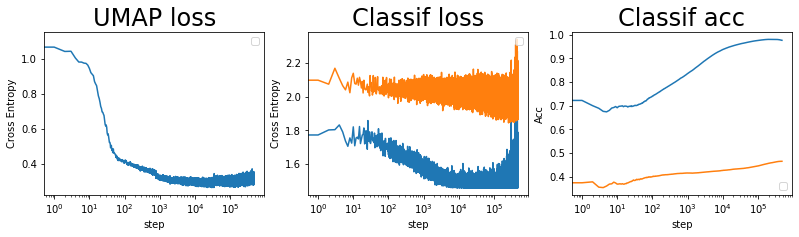

batch: 479000 | train acc: 0.9764 | val acc: 0.4657


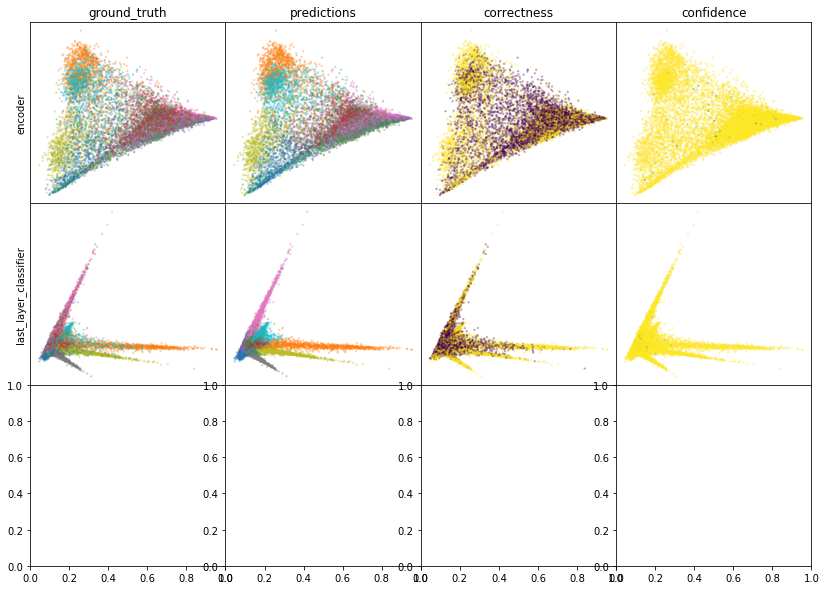

W0807 13:01:22.221777 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:01:23.263684 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:01:24.245444 140610860525376 legend.py:1282] No handles with labels found to put in legend.


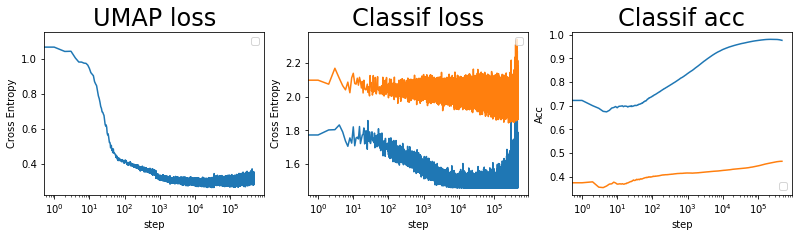

batch: 480000 | train acc: 0.9764 | val acc: 0.4657


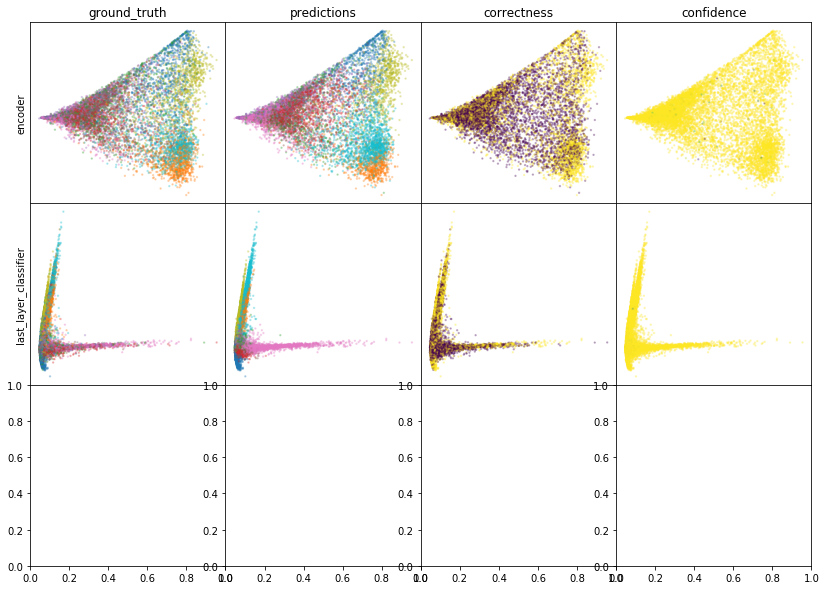

W0807 13:04:22.279231 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:04:23.310710 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:04:24.285380 140610860525376 legend.py:1282] No handles with labels found to put in legend.


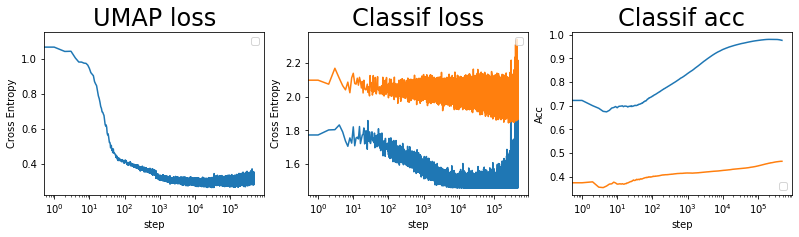

batch: 481000 | train acc: 0.9763 | val acc: 0.4657


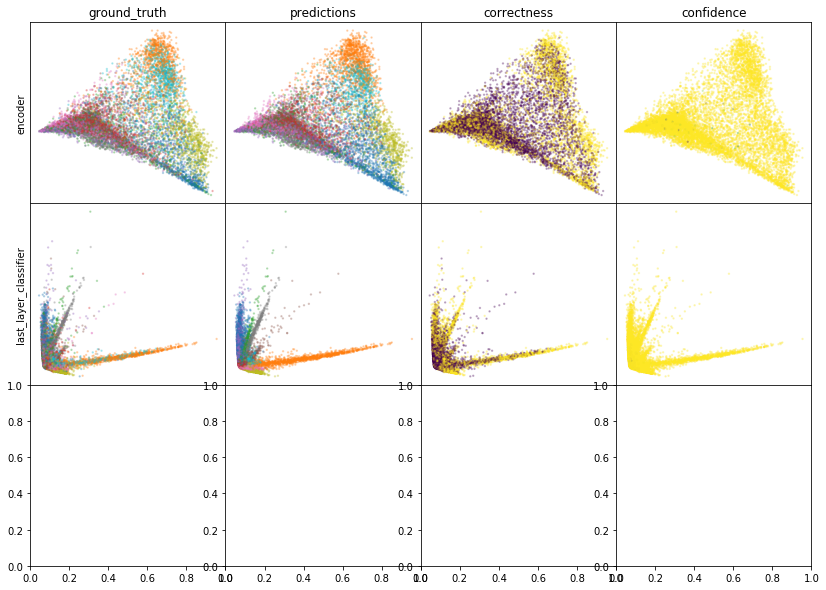

W0807 13:07:04.172384 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:07:05.213486 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:07:06.203094 140610860525376 legend.py:1282] No handles with labels found to put in legend.


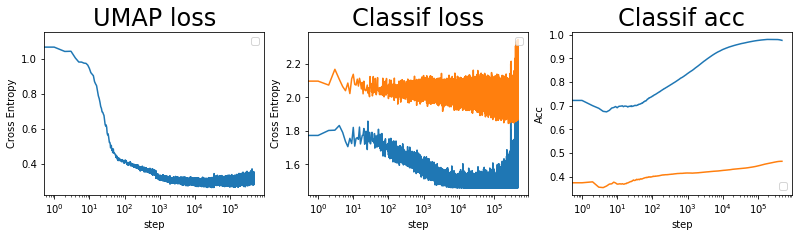

batch: 482000 | train acc: 0.9763 | val acc: 0.4657
leaving epoch because no improvement in 10000 batches


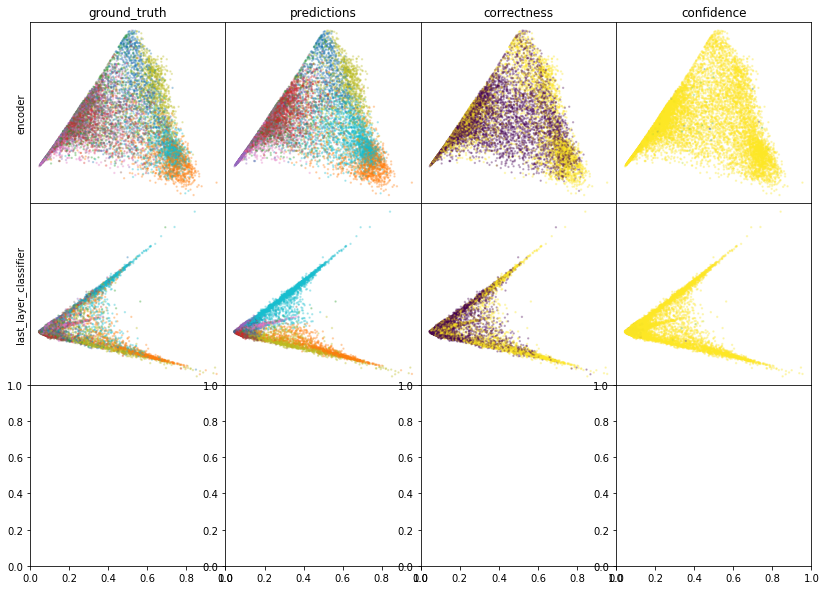

W0807 13:10:36.170110 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:10:37.204463 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:10:38.185345 140610860525376 legend.py:1282] No handles with labels found to put in legend.


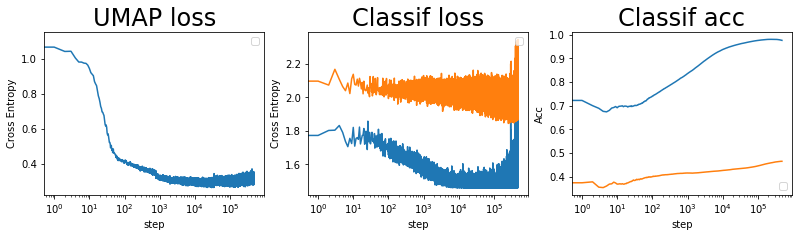

batch: 483000 | train acc: 0.9762 | val acc: 0.4657


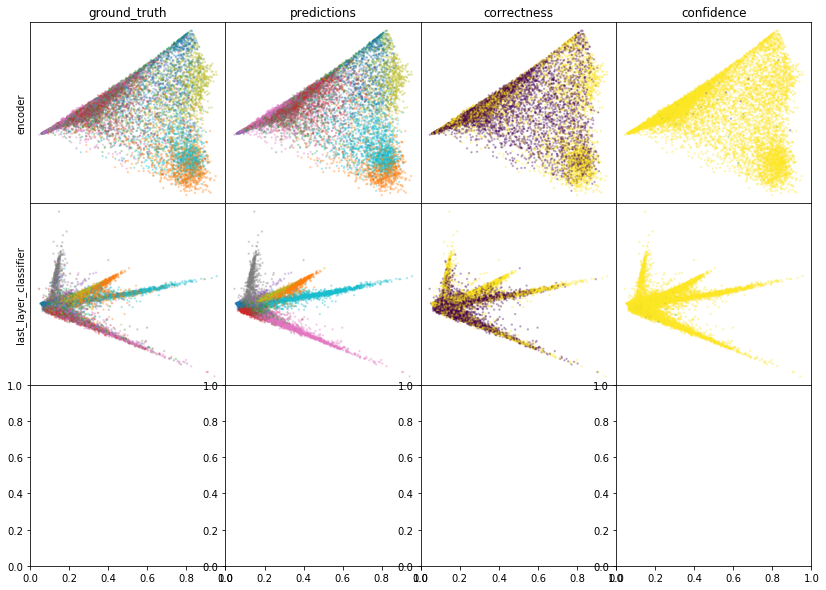

W0807 13:13:17.985621 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:13:19.023610 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:13:19.998366 140610860525376 legend.py:1282] No handles with labels found to put in legend.


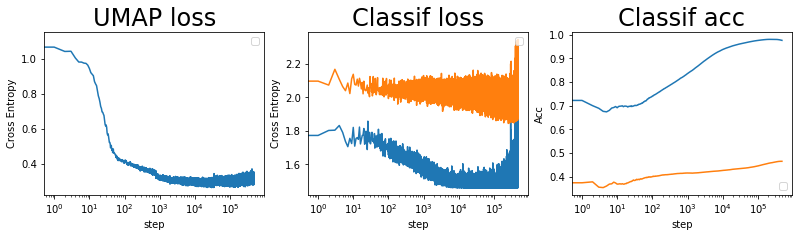

batch: 484000 | train acc: 0.9762 | val acc: 0.4657


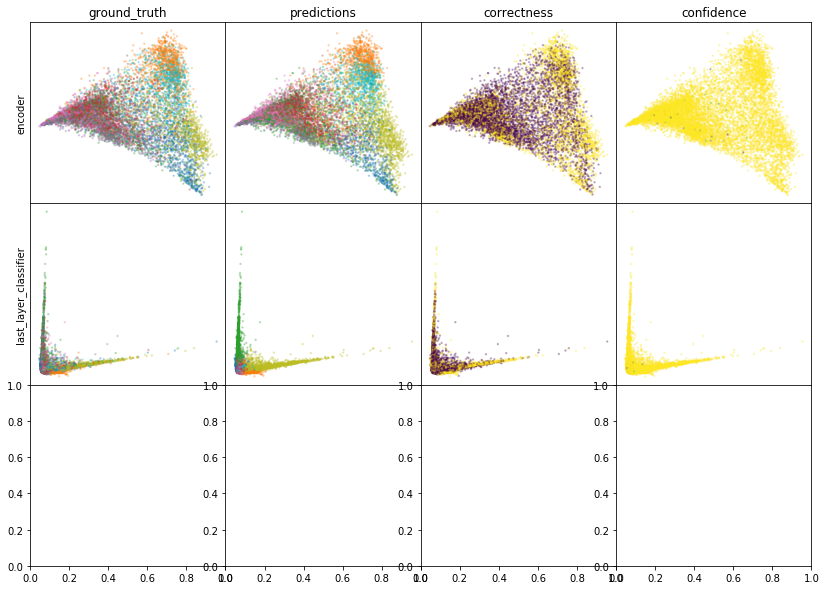

W0807 13:16:19.356646 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:16:20.405608 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:16:21.392102 140610860525376 legend.py:1282] No handles with labels found to put in legend.


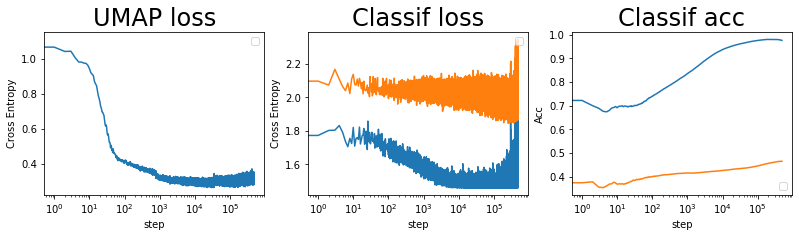

batch: 485000 | train acc: 0.9762 | val acc: 0.4657


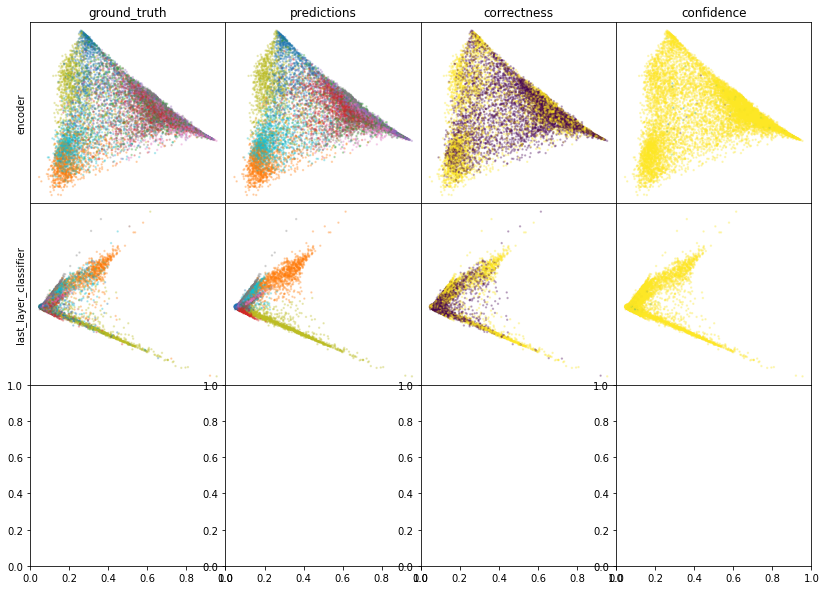

W0807 13:19:02.277562 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:19:03.346678 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:19:04.354104 140610860525376 legend.py:1282] No handles with labels found to put in legend.


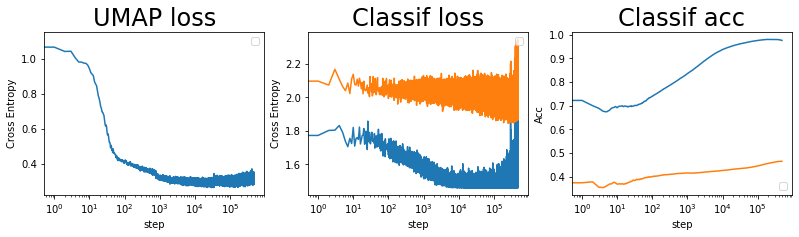

batch: 486000 | train acc: 0.9762 | val acc: 0.4657


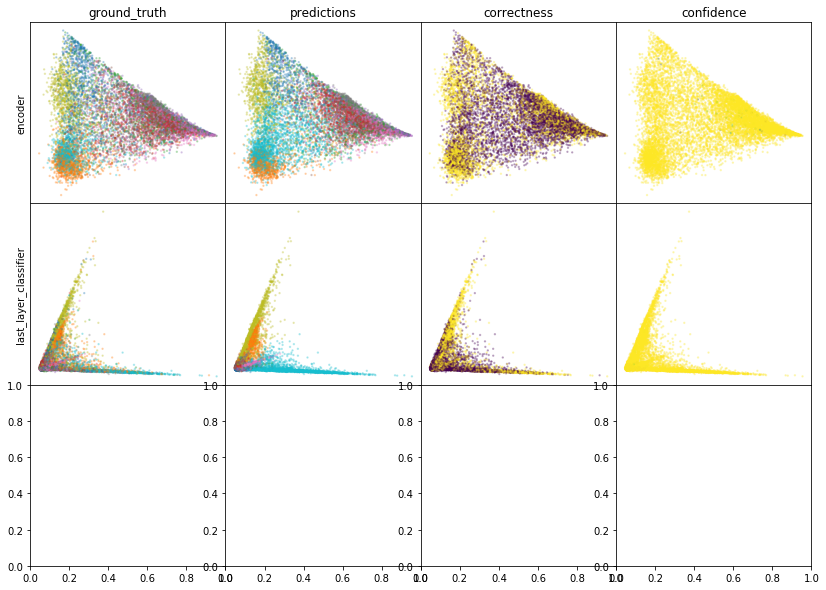

W0807 13:22:05.345922 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:22:06.384921 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:22:07.357710 140610860525376 legend.py:1282] No handles with labels found to put in legend.


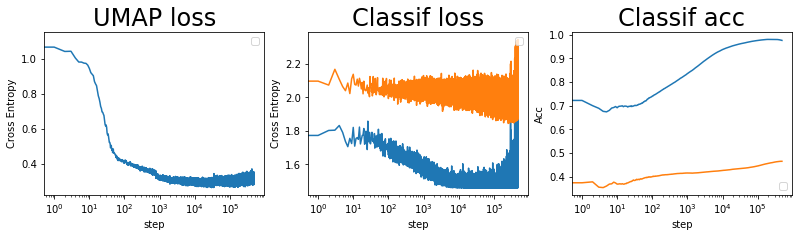

batch: 487000 | train acc: 0.9761 | val acc: 0.4657


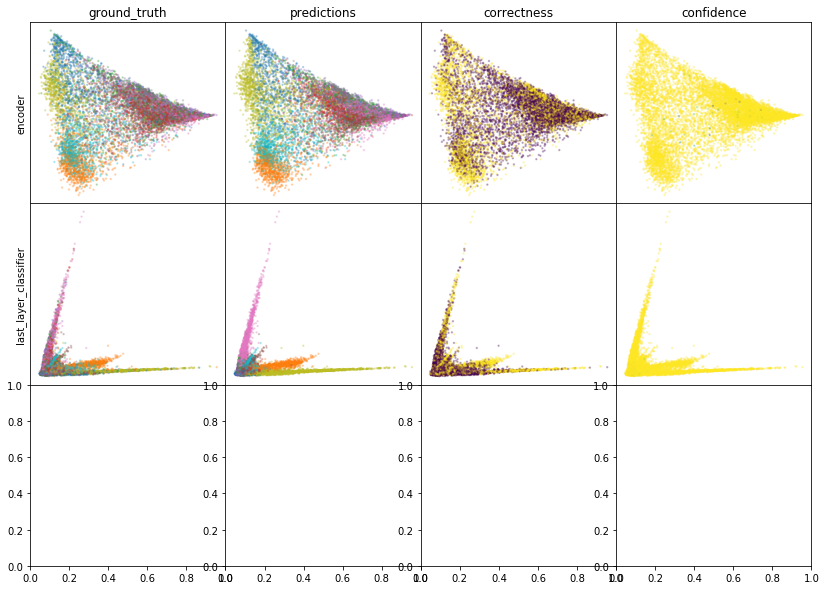

W0807 13:24:47.826655 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:24:48.874451 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:24:49.862011 140610860525376 legend.py:1282] No handles with labels found to put in legend.


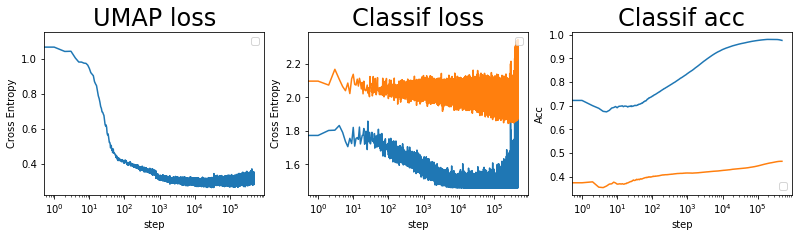

batch: 488000 | train acc: 0.9761 | val acc: 0.4657


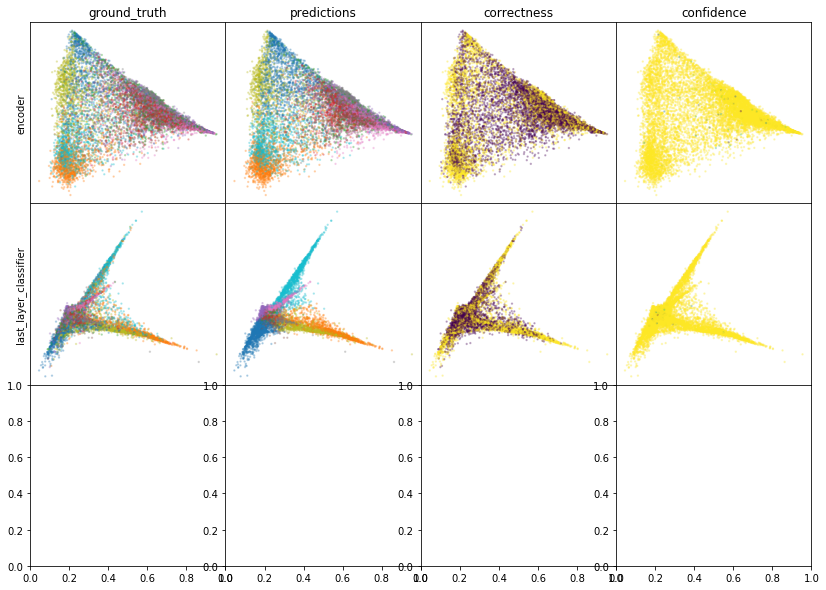

W0807 13:27:50.820857 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:27:51.887708 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:27:52.889020 140610860525376 legend.py:1282] No handles with labels found to put in legend.


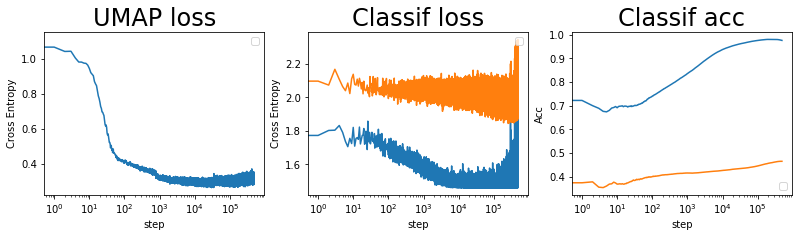

batch: 489000 | train acc: 0.9761 | val acc: 0.4657


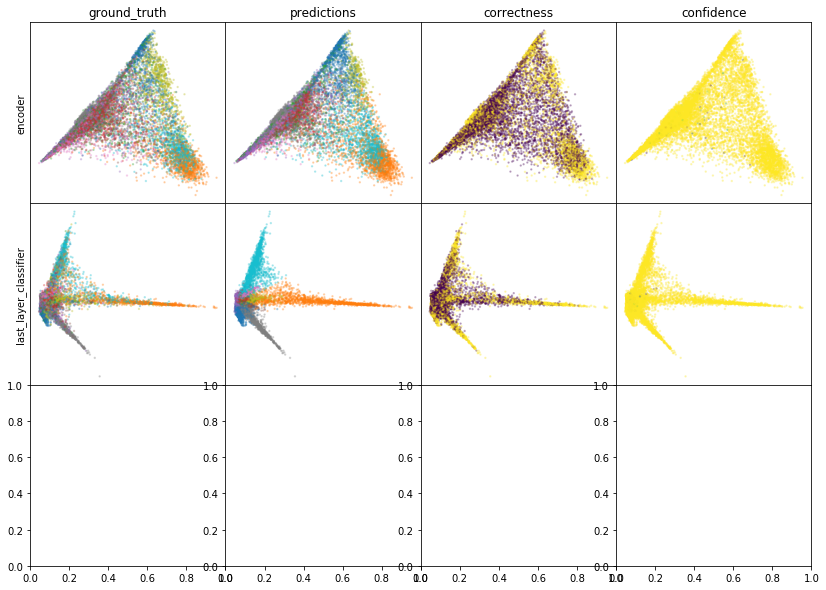

W0807 13:30:36.151807 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:30:37.213274 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:30:38.198802 140610860525376 legend.py:1282] No handles with labels found to put in legend.


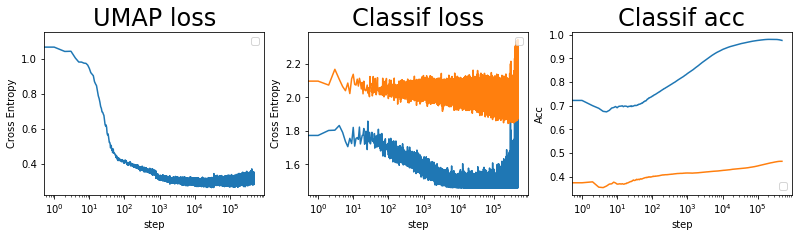

batch: 490000 | train acc: 0.976 | val acc: 0.4657


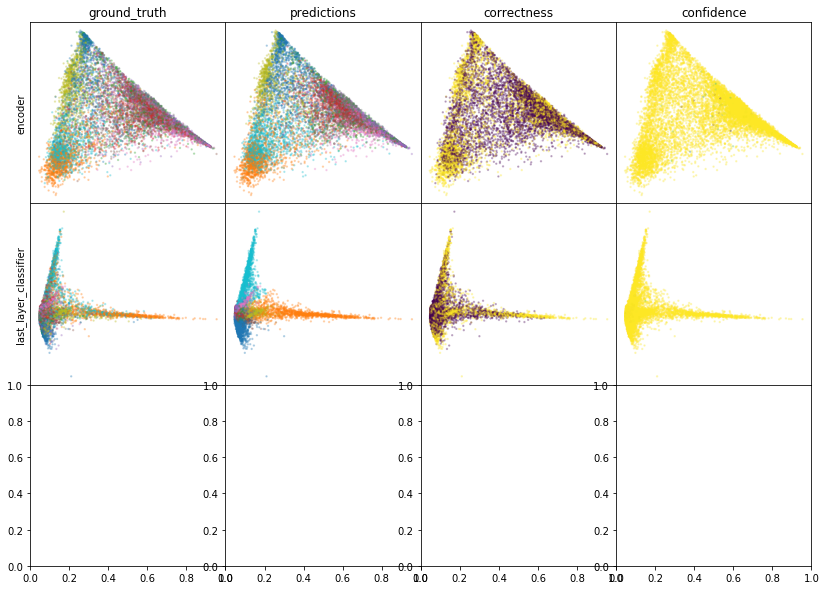

W0807 13:33:37.792794 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:33:38.845773 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:33:39.838866 140610860525376 legend.py:1282] No handles with labels found to put in legend.


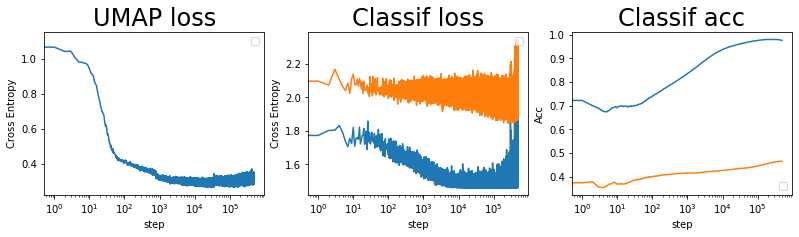

batch: 491000 | train acc: 0.976 | val acc: 0.4657


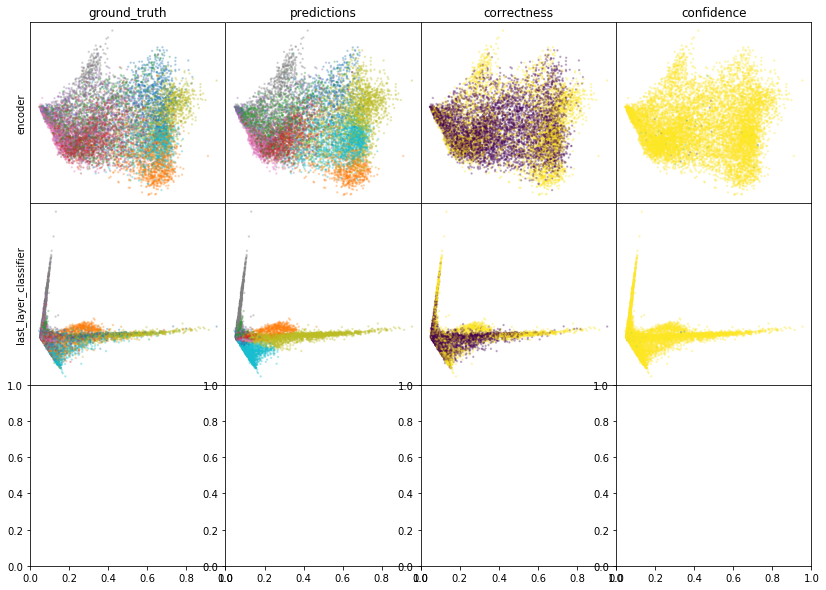

W0807 13:36:21.578138 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:36:22.633520 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:36:23.627189 140610860525376 legend.py:1282] No handles with labels found to put in legend.


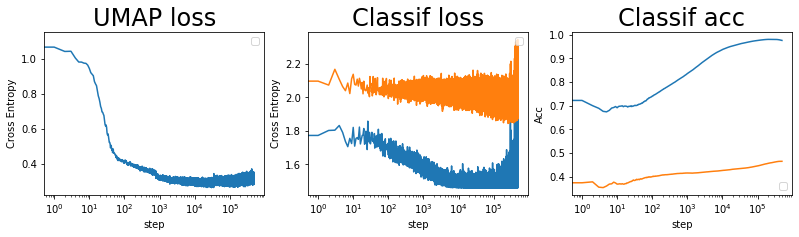

batch: 492000 | train acc: 0.976 | val acc: 0.4656
leaving epoch because no improvement in 10000 batches


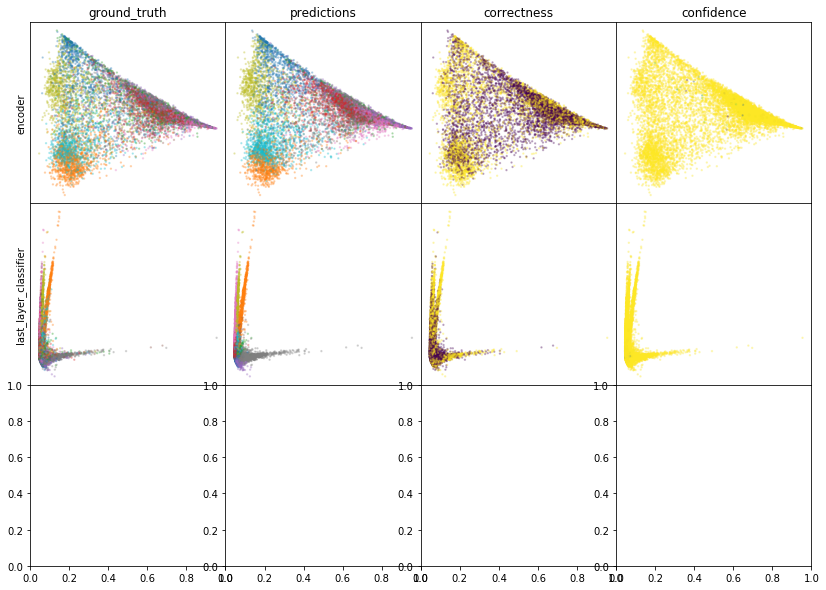

W0807 13:39:55.748692 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:39:56.811790 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:39:57.813884 140610860525376 legend.py:1282] No handles with labels found to put in legend.


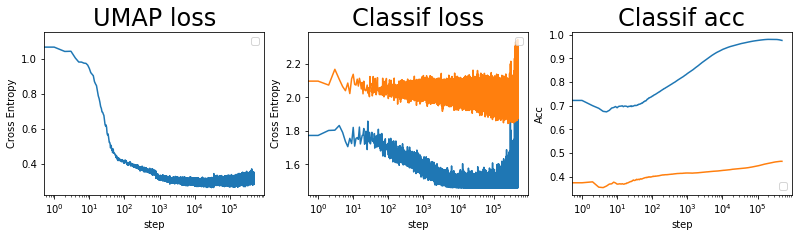

batch: 493000 | train acc: 0.976 | val acc: 0.4656


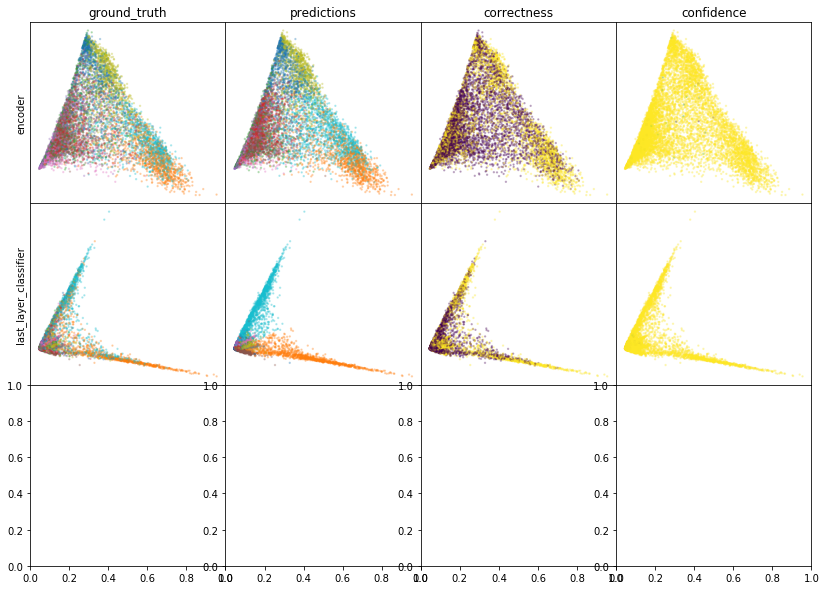

W0807 13:42:40.831187 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:42:41.897232 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:42:42.910692 140610860525376 legend.py:1282] No handles with labels found to put in legend.


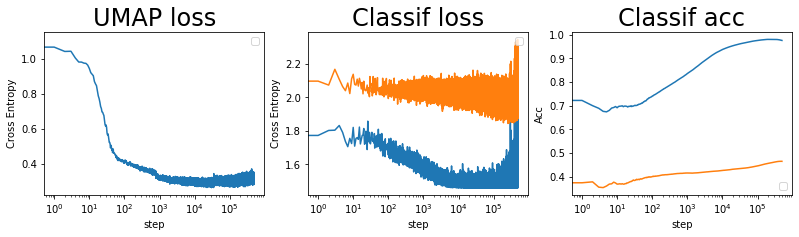

batch: 494000 | train acc: 0.9759 | val acc: 0.4656


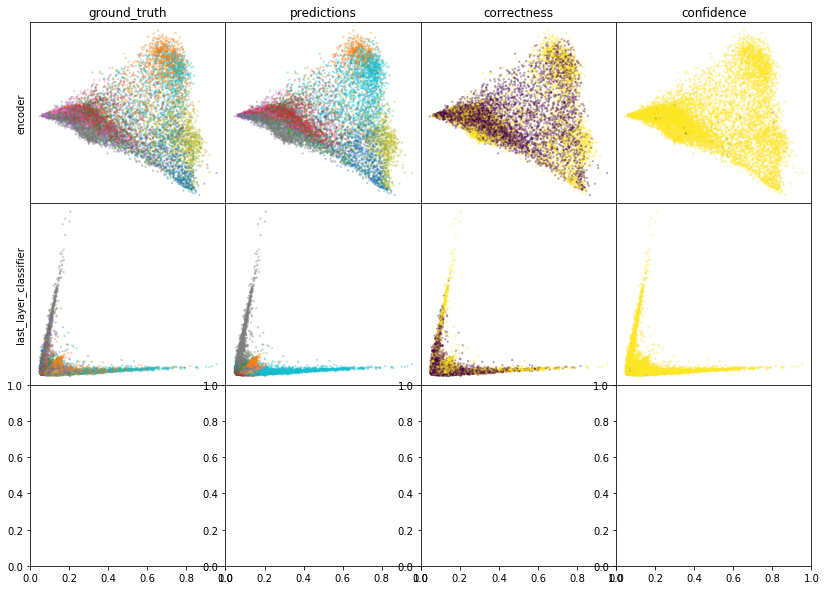

W0807 13:45:45.076375 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:45:46.143578 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:45:47.139997 140610860525376 legend.py:1282] No handles with labels found to put in legend.


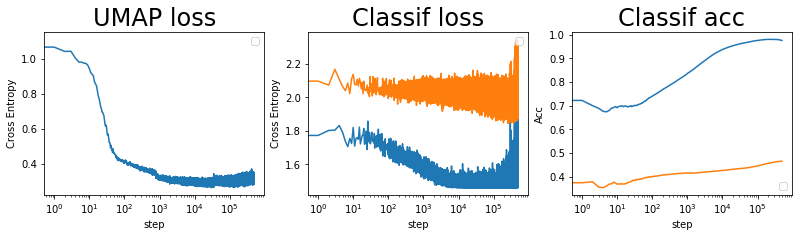

batch: 495000 | train acc: 0.9759 | val acc: 0.4656


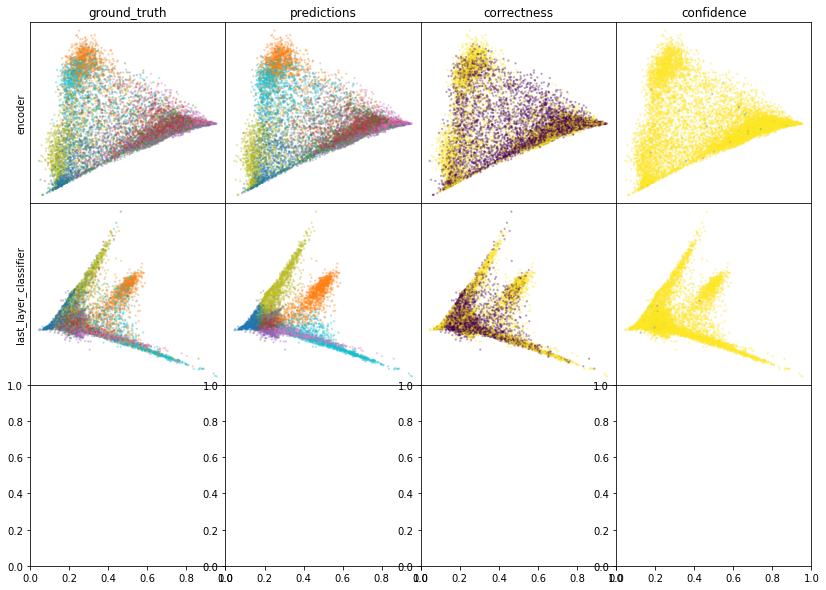

W0807 13:48:28.811924 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:48:29.903354 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:48:30.921703 140610860525376 legend.py:1282] No handles with labels found to put in legend.


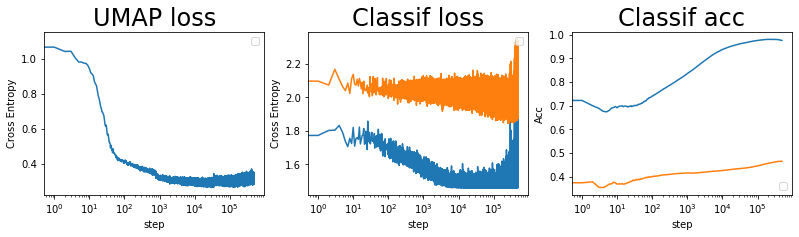

batch: 496000 | train acc: 0.9759 | val acc: 0.4656


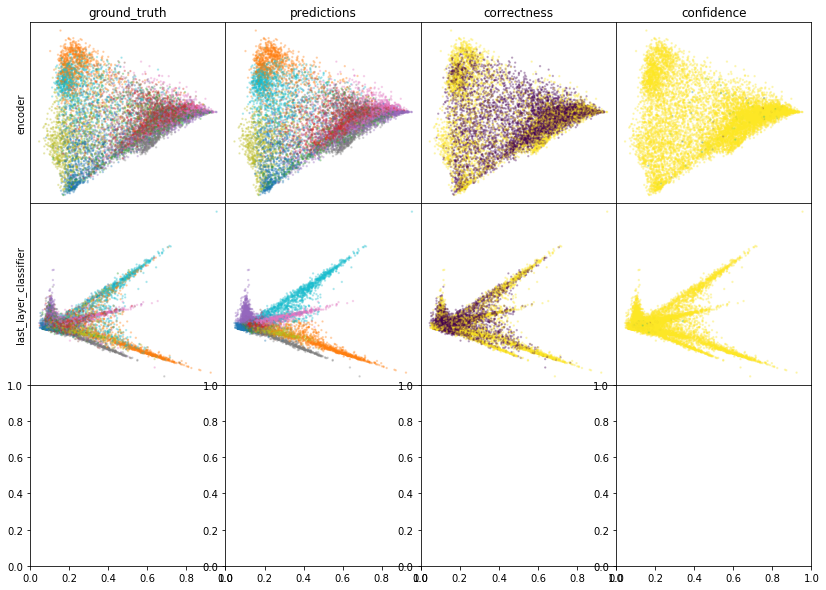

W0807 13:51:34.586483 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:51:35.663736 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:51:36.680476 140610860525376 legend.py:1282] No handles with labels found to put in legend.


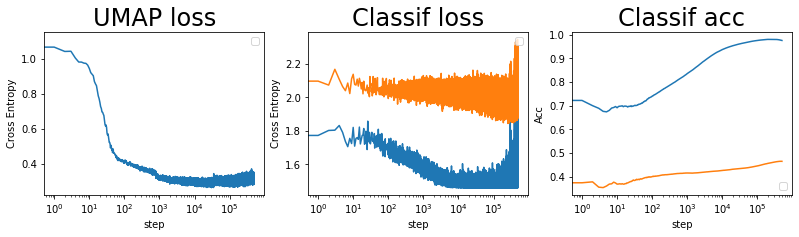

batch: 497000 | train acc: 0.9758 | val acc: 0.4656


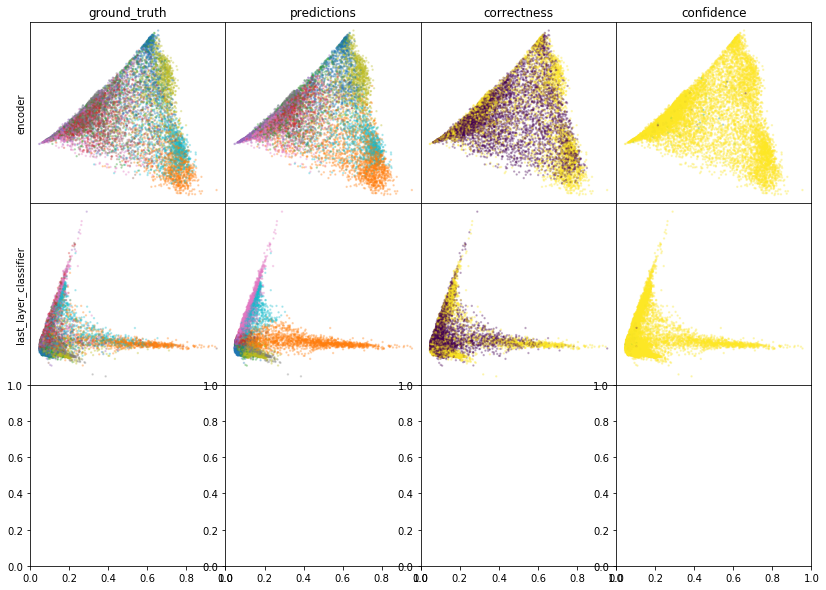

W0807 13:54:20.437576 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:54:21.509053 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:54:22.514802 140610860525376 legend.py:1282] No handles with labels found to put in legend.


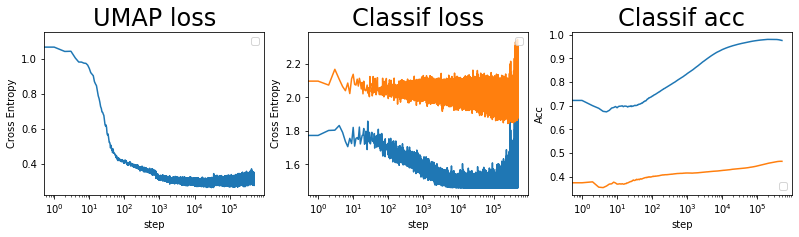

batch: 498000 | train acc: 0.9758 | val acc: 0.4656


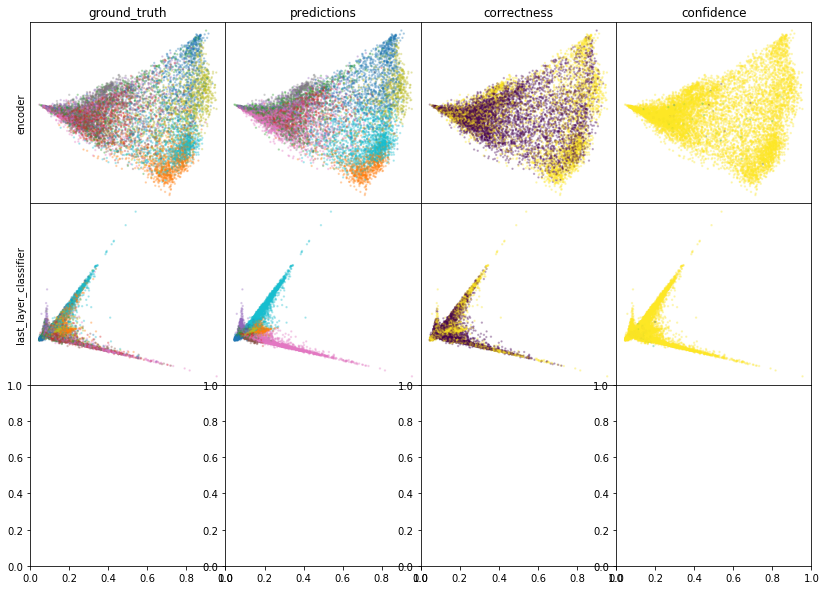

W0807 13:57:24.482262 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:57:25.576152 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 13:57:26.605254 140610860525376 legend.py:1282] No handles with labels found to put in legend.


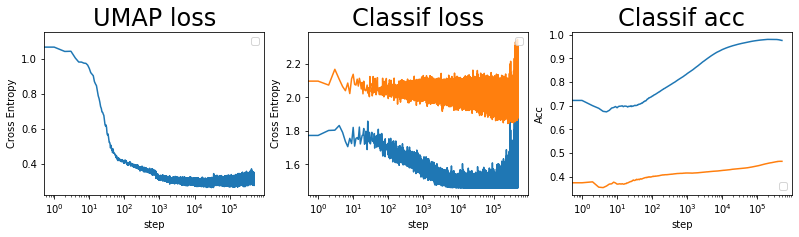

batch: 499000 | train acc: 0.9758 | val acc: 0.4656


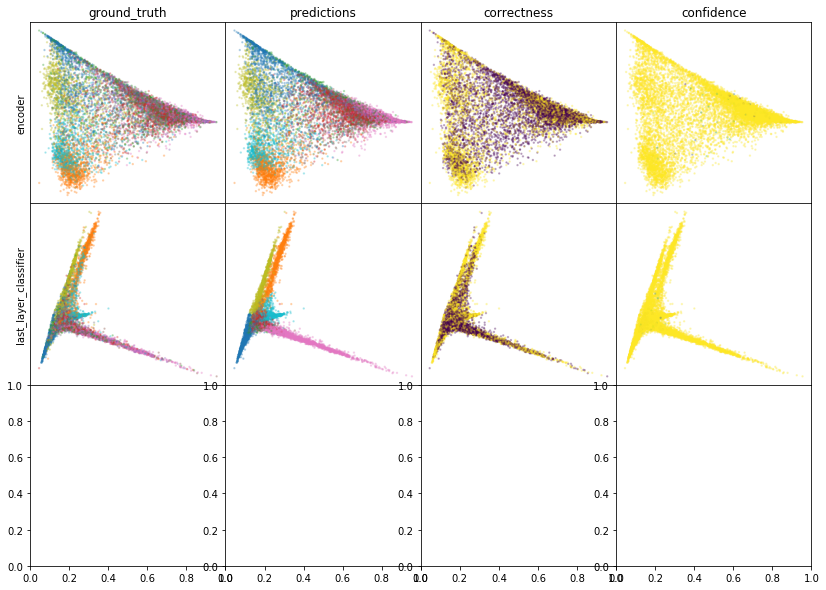

W0807 14:00:09.554100 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:00:10.630873 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:00:11.644771 140610860525376 legend.py:1282] No handles with labels found to put in legend.


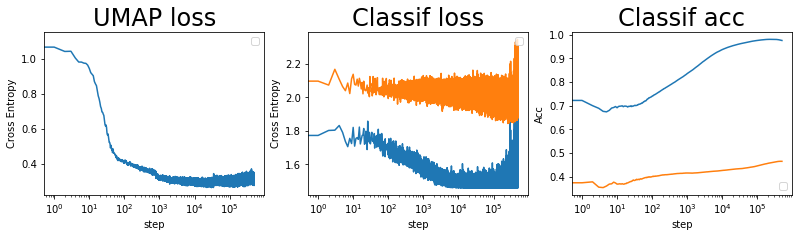

batch: 500000 | train acc: 0.9758 | val acc: 0.4656


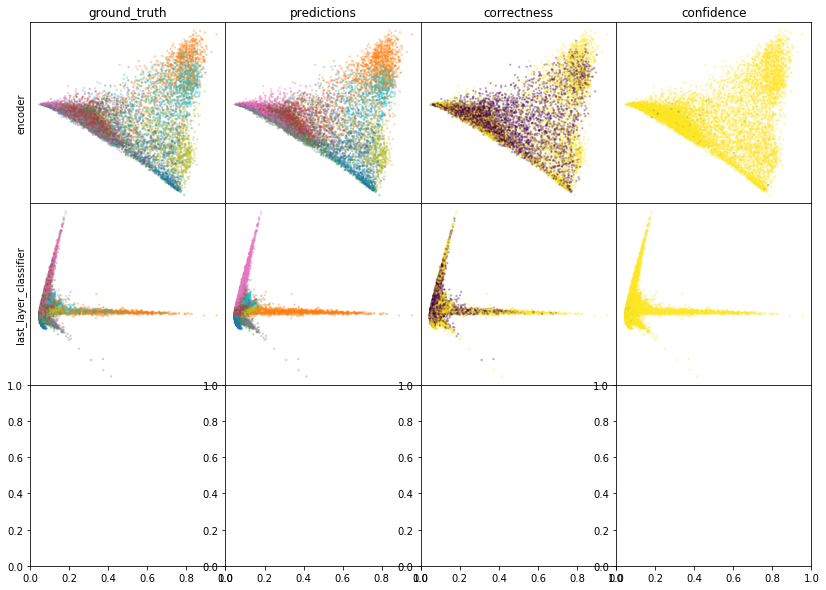

W0807 14:03:12.489105 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:03:13.564337 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:03:14.586619 140610860525376 legend.py:1282] No handles with labels found to put in legend.


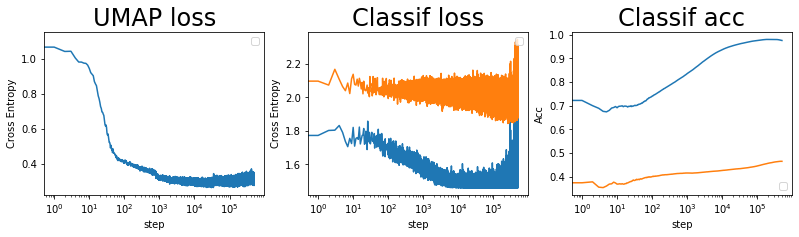

batch: 501000 | train acc: 0.9758 | val acc: 0.4656


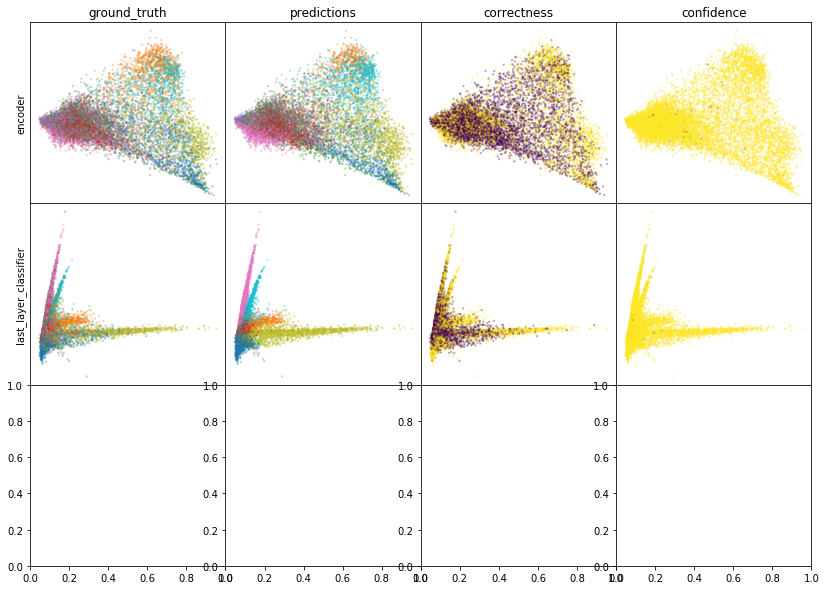

W0807 14:05:58.667562 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:05:59.754430 140610860525376 legend.py:1282] No handles with labels found to put in legend.
W0807 14:06:00.768137 140610860525376 legend.py:1282] No handles with labels found to put in legend.


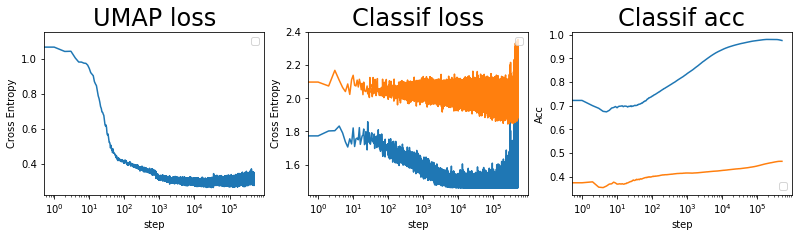

batch: 502000 | train acc: 0.9757 | val acc: 0.4656
leaving epoch because no improvement in 10000 batches
Early stopping because no improvement in 5 epochs


In [66]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):
        
        # redo augmentation if on average, 
        if samples_left <= 0:
            X_train_aug = next(img_data_gen.flow(X_train, shuffle=False, batch_size=len(X_train)))
            samples_left = len(X_train)*repeat_augment_tolerance
        samples_left -= batch_size*2
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train_aug[np.array(batch_to)], batch_from=X_train_aug[np.array(batch_from)], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [60]:
test_enc = model_data(X_test, batch_size, model.encoder)

In [61]:
y_pred = model_data(test_enc, batch_size, model.classifier)

In [62]:
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.4675


In [63]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [65]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Fri Aug  7 09:25:38 2020 Finding Nearest Neighbors
Fri Aug  7 09:25:38 2020 Building RP forest with 15 trees
Fri Aug  7 09:25:38 2020 parallel NN descent for 15 iterations
	 0  /  15
	 1  /  15
	 2  /  15
Fri Aug  7 09:25:39 2020 Finished Nearest Neighbor Search
Fri Aug  7 09:25:39 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Aug  7 09:26:15 2020 Finished embedding


In [56]:
np.shape(X_train_aug)

(40000, 32, 32, 3)

In [58]:
batch_to

<tf.Tensor: shape=(6,), dtype=int32, numpy=array([34646, 22220, 19897,  1389,  4410,  2492], dtype=int32)>

In [ ]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

In [ ]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')